# Object Detection and Classification using YOLO and ViT

# Introduction to Image Object Detection

## Overview

<img src="https://deeplobe.ai/wp-content/uploads/2023/06/Object-detection-Real-world-applications-and-benefits.png" alt="Object Detection" style="float:right; width:300px; margin-left:20px;">

**Object Detection** is a fundamental computer vision task that extends beyond simple image classification to simultaneously address object localization and recognition [1]. While image classification answers "What is in this image?", object detection answers the more complex question: "What objects are present, and where are they located?" This capability has become essential for applications ranging from autonomous vehicles to medical diagnosis systems [2].

The evolution of object detection methods represents one of the most dynamic areas in computer vision research. Early approaches relied on hand-crafted features and sliding window techniques, which were computationally expensive and limited in accuracy. The advancements in deep learning, particularly convolutional neural networks (CNNs), revolutionized the field, enabling end-to-end learning and dramatically improving detection performance. More recently, transformer-based architectures have emerged as a powerful alternative, offering new ways to model spatial relationships and global context within images [3].

## Core Components of Object Detection

Object detection systems must solve three interconnected sub-problems:

1. **Localization**: Determining the spatial location of objects within an image coordinate system. This involves predicting precise boundaries that encompass each object of interest.

2. **Classification**: Identifying the category or class label for each detected region. Unlike image-level classification, this must be performed for each localized object independently.

3. **Bounding Box Prediction**: Generating rectangular coordinates that tightly bound each object. These are typically represented as either (x, y, width, height) specifying center coordinates and dimensions, or (x_min, y_min, x_max, y_max) defining the top-left and bottom-right corners.

Each bounding box prediction is accompanied by a confidence score indicating the model's certainty about both the presence of an object and the accuracy of its localization. Modern detectors must handle varying numbers of objects per image, objects at multiple scales, occlusions, and challenging viewing conditions.

## Key Concepts and Evaluation Metrics

### Bounding Boxes
Bounding boxes serve as the primary representation for object localization. While axis-aligned rectangular boxes are most common due to their computational efficiency, they provide a compact way to specify object locations. Each prediction includes spatial coordinates, a class label, and a confidence score that reflects the detector's certainty.

### Intersection over Union (IoU)
The quality of predicted bounding boxes is measured using Intersection over Union (IoU), which quantifies the overlap between predicted and ground-truth boxes. IoU values range from 0 (no overlap) to 1 (perfect alignment) and play a crucial role during both training (for matching predictions to targets) and evaluation (for determining correct detections).


### Detection vs. Classification
The distinction between image classification and object detection is fundamental. Image classification assigns one or more labels to an entire image, treating it as a single entity. Object detection, however, must localize and classify a variable number of objects within each image, making it a significantly more complex task that requires joint reasoning about "what" and "where."

## Evolution of Detection Architectures

### Two-Stage Detectors

Two-stage detectors decompose the detection problem into sequential region proposal and classification steps, providing a coarse-to-fine detection approach.

**R-CNN and Its Evolution**: The Region-based CNN (R-CNN) family pioneered the use of deep learning for object detection. The original R-CNN used selective search to generate region proposals, extracted CNN features from each proposal, and classified them using SVMs. Fast R-CNN improved efficiency by sharing convolutional computation across proposals, while Faster R-CNN introduced the Region Proposal Network (RPN) to learn proposals end-to-end, achieving fast computational performance while maintaining high accuracy.

**Advantages**: Two-stage detectors typically achieve higher accuracy, particularly on challenging datasets with small or heavily occluded objects. The separate proposal generation stage allows the model to focus computational resources on likely object locations.

**Limitations**: The sequential nature of two-stage detectors results in slower inference speeds compared to one-stage alternatives, making them less suitable for real-time applications with strict latency requirements.

### One-Stage Detectors

One-stage detectors eliminate the explicit region proposal generation step, directly predicting bounding boxes and class probabilities in a single forward pass through the network.

**YOLO (You Only Look Once)**: Introduced by Redmon et al. in 2016 [4], YOLO revolutionized object detection by reformulating it as a single regression problem. The original YOLO divides the input image into a grid, with each grid cell responsible for predicting bounding boxes and class probabilities for objects whose centers fall within that cell. This unified architecture enables real-time inference at 45 frames per second while maintaining competitive accuracy.

The YOLO family has evolved significantly through multiple iterations:
- **YOLOv2/YOLO9000** [5]: Introduced batch normalization, anchor boxes, and multi-scale training, while demonstrating detection across 9000+ object categories.
- **YOLOv3** [6]: Added multi-scale predictions and a more sophisticated backbone network for improved performance on objects of varying sizes.
- **YOLOv4-v8** [7]: Community-driven developments that progressively improved speed-accuracy trade-offs, with YOLOv8 representing the current state-of-the-art in the YOLO lineage, offering multiple model sizes for different deployment scenarios.

**Key Advantages of YOLO**:
- **Real-time performance**: Single forward pass enables processing at video frame rates
- **Global reasoning**: The entire image context informs each prediction, reducing background false positives
- **Simplicity**: Straightforward architecture without complex post-processing pipelines
- **Flexibility**: Multiple versions offer trade-offs between speed and accuracy

**Limitations**: Early YOLO versions struggled with small objects and localization precision compared to two-stage detectors, though recent iterations have largely addressed these issues.

### Transformer-Based Detectors

The success of transformer architectures in natural language processing inspired their adaptation to computer vision, leading to fundamentally new approaches to object detection. The Vision Transformer (ViT) [8] demonstrated that pure transformer architectures could achieve state-of-the-art performance on image classification, paving the way for transformer-based detection methods.

**DETR (DEtection TRansformer)**: Introduced by Carion et al. in 2020 [9], DETR represents a paradigm shift in object detection methodology. Unlike traditional detectors that rely on hand-designed components like anchor boxes and non-maximum suppression, DETR formulates detection as a direct set prediction problem using a transformer encoder-decoder architecture.

**DETR Architecture**:
1. **CNN Backbone**: Extracts spatial feature maps from the input image
2. **Transformer Encoder**: Processes flattened spatial features with self-attention to capture global image context
3. **Transformer Decoder**: Takes a fixed set of learned "object queries" as input and attends to encoder outputs
4. **Prediction Heads**: Each decoder output is independently decoded into class predictions and bounding box coordinates

**Training with Bipartite Matching**: DETR uses a unique training approach that matches predicted objects to ground-truth targets using the Hungarian algorithm, enabling end-to-end training without hand-designed assignment rules.

**Key Innovations**:
- **Eliminates hand-crafted components**: No need for anchor generation or NMS post-processing
- **Set prediction**: Directly outputs all detections in parallel without sequential refinement
- **Global reasoning**: Attention mechanisms enable modeling of relationships between objects
- **Conceptual simplicity**: Can be implemented in standard deep learning frameworks without specialized libraries

**Limitations**: DETR requires longer training schedules to converge compared to CNN-based detectors and can struggle with small object detection due to limited spatial resolution in attention computations. Variants like Deformable DETR have addressed some of these limitations through deformable attention mechanisms that focus on relevant spatial locations.

## Applications and Impact

Object detection has become widely used across many fields:

**Autonomous Vehicles**: Detection and tracking of pedestrians, vehicles, cyclists, traffic signs, and lane markings is essential for safe autonomous navigation [11]. Modern systems often combine detections from multiple sensor modalities (cameras, LiDAR, radar) for robust perception.

**Medical Imaging**: Automated detection of anatomical structures, lesions, tumors, and pathological indicators in medical scans assists clinicians in diagnosis and treatment planning [12], with some systems achieving expert-level performance on specific tasks.

**Surveillance and Security**: Real-time monitoring systems detect and track persons, vehicles, and suspicious activities in public spaces, airports, and critical infrastructure [10], with growing emphasis on privacy-preserving detection methods.

**Retail and E-commerce**: Automated checkout systems, inventory management, product recognition, and customer behavior analysis leverage object detection to improve operational efficiency.

**Robotics**: Object detection enables robots to perceive and interact with their environment for manipulation tasks, navigation, and human-robot collaboration [13].

**Agricultural Monitoring**: Detection of crops, pests, and diseases using drone-based imagery supports precision agriculture and optimized resource management.

## Scope of This HomeWork

This notebook presents a practical comparative analysis of two representative detection paradigms applied to bottle detection:


YOLOv11: A state-of-the-art one-stage detector, representing the culmination of the YOLO family's evolution. We demonstrate fine-tuning YOLOv11 on a domain-specific bottle detection dataset to achieve specialized performance.
DETR (Detection Transformer): A transformer-based approach that represents a fundamentally different detection philosophy. We apply a pre-trained DETR model to evaluate its capabilities on the bottle detection task.

Through visual comparisons and detection statistics, we examine:

Detection counts and localization on bottle images
Confidence score distributions between the two models
The differences between task-specific trained (YOLO) and pre-trained model performance (DETR)
Qualitative assessment of bounding box accuracy and false positive rates

This comparison provides insights into how architectural choices and training strategies influence detection performance on specialized tasks. The bottle detection task serves as a concrete example of applying modern object detection frameworks to a specific domain problem, illustrating the practical trade-offs between domain specific single-stage detectors and transformer-based approaches.

---

## References

[1] Zhao, Z. Q., Zheng, P., Xu, S. T., & Wu, X. (2019). Object detection with deep learning: A review. *IEEE Transactions on Neural Networks and Learning Systems*, 30(11), 3212-3232.

[2] Szirányi, T., & Kovács, L. (2007). Focus area extraction by blind deconvolution for defining regions of interest. *IEEE Transactions on Pattern Analysis and Machine Intelligence*, 29(6), 1080-1085.

[3] Khan, S., Naseer, M., Hayat, M., Zamir, S. W., Khan, F. S., & Shah, M. (2022). Transformers in vision: A survey. *ACM Computing Surveys*, 54(10s), 1-41.

[4] Redmon, J., Divvala, S., Girshick, R., & Farhadi, A. (2016). You only look once: Unified, real-time object detection. *Proceedings of the IEEE Conference on Computer Vision and Pattern Recognition*, 779-788.

[5] Redmon, J., & Farhadi, A. (2017). YOLO9000: Better, faster, stronger. *Proceedings of the IEEE Conference on Computer Vision and Pattern Recognition*, 7263-7271.

[6] Redmon, J., & Farhadi, A. (2018). YOLOv3: An incremental improvement. *arXiv preprint arXiv:1804.02767*.

[7] Jocher, G., Chaurasia, A., & Qiu, J. (2023). Ultralytics YOLOv8. https://github.com/ultralytics/ultralytics

[8] Dosovitskiy, A., Beyer, L., Kolesnikov, A., Weissenborn, D., Zhai, X., Unterthiner, T., ... & Houlsby, N. (2021). An image is worth 16x16 words: Transformers for image recognition at scale. *International Conference on Learning Representations*.

[9] Carion, N., Massa, F., Synnaeve, G., Usunier, N., Kirillov, A., & Zagoruyko, S. (2020). End-to-end object detection with transformers. *European Conference on Computer Vision*, 213-229.

[10] Benedek, C., Jankó, Z., Horváth, C., Molnár, D., Chetverikov, D., & Szirányi, T. (2013). An integrated 4D vision and visualisation system. *Computer Vision Systems: International Conference*, Lecture Notes in Computer Science, vol 7963, 21-31.

[11] Szabó, M.Á., Keszler, A., and Tizedes, L. (2025). "Real-time detection of road hazards for autonomous vehicle systems," 2025 IEEE 6th International Conference on Image Processing, Applications and Systems (IPAS), pp. 1-7. DOI: 10.1109/IPAS63548.2025.10924564

[12] Litjens, G., Kooi, T., Bejnordi, B. E., Setio, A. A. A., Ciompi, F., Ghafoorian, M., ... & Sánchez, C. I. (2017). A survey on deep learning in medical image analysis. Medical Image Analysis, 42, 60-88.

[13] Benedek, C., Gálai, B., Nagy, B., and Jankó, Z. (2018). "Lidar-based Gait Analysis and Activity Recognition in a 4D Surveillance System," IEEE Transactions on Circuits and Systems for Video Technology, vol. 28, no. 1, pp. 101-113. DOI: 10.1109/TCSVT.2016.2595331

In [21]:
%%bash
# ============================================================================
# Environment Setup: Creating Virtual Environment and Installing Dependencies
# ============================================================================
# This cell sets up a clean Python environment for the project by:
# 1. Creating an isolated virtual environment to avoid dependency conflicts
# 2. Activating the virtual environment for this session
# 3. Installing all required packages from requirements.txt

# Step 1: Create a new virtual environment named '.venv'
# This isolates project dependencies from the system Python installation
python3 -m venv .venv

# Step 2: Activate the virtual environment
# This ensures that all subsequent Python commands use packages from .venv
source .venv/bin/activate

# Step 3: Upgrade pip to the latest version for better package management
pip install --upgrade pip

# Step 4: Install all project dependencies from requirements.txt
# This installs all necessary libraries for CNN and ViT model training
pip install -r requirements.txt

echo "✓ Virtual environment created and activated"
echo "✓ All dependencies installed successfully"

✓ Virtual environment created and activated
✓ All dependencies installed successfully


In [37]:
# ============================================================================
# DATASET DOWNLOAD AND ORGANIZATION
# ============================================================================
# PURPOSE: Downloads the Alcohol Bottle Images dataset from Kaggle and
#          organizes it into YOLO-compatible format with train/val splits
#
# WHAT IT DOES:
# 1. Downloads dataset from Kaggle using kagglehub
# 2. Inspects the downloaded folder structure
# 3. Finds images and XML annotations
# 4. Converts XML (Pascal VOC) to YOLO format (.txt files)
# 5. Splits data 80/20 into train/val sets
# 6. Creates proper folder structure for YOLO training
#
# OUTPUT STRUCTURE:
# data_det/alcohol_bottles/
# ├── train/images/  (112 images)
# ├── train/labels/  (112 .txt files with bounding boxes)
# ├── val/images/    (28 images)
# └── val/labels/    (28 .txt files with bounding boxes)
#
# NOTE: Requires Kaggle API credentials
# ============================================================================
from pathlib import Path
import shutil
import random

print("="*80)
print("DATASET DOWNLOAD AND SETUP")
print("="*80)

# Define the data directory in the current working directory
data_dir = Path("data_det")

# Check if data directory exists, create if not
if not data_dir.exists():
    data_dir.mkdir(parents=True, exist_ok=True)
    print(f"✓ Created data directory: {data_dir.absolute()}")
else:
    print(f"✓ Data directory already exists: {data_dir.absolute()}")

# Alcohol Bottle Images dataset path in data directory
dataset_in_data = data_dir / "alcohol_bottles"
train_images_dir = dataset_in_data / "train" / "images"

# Check if dataset already exists and is properly organized
if dataset_in_data.exists() and train_images_dir.exists() and any(train_images_dir.iterdir()):
    print(f"✓ Dataset already exists and is organized in {data_dir.absolute()}")
    print(f"  Path: {dataset_in_data.absolute()}")
else:
    # Download Alcohol Bottle Images dataset using kagglehub
    print("\nDownloading Alcohol Bottle Images dataset from Kaggle...")
    print("NOTE: You need to have Kaggle API credentials set up.")
    print("      See: https://github.com/Kaggle/kaggle-api#api-credentials")
    try:
        import kagglehub
        # Download Alcohol Bottle Images from Kaggle
        cache_path = Path(kagglehub.dataset_download("dataclusterlabs/alcohol-bottle-images-glass-bottles"))
        print(f"✓ Downloaded to cache: {cache_path}")

        # Inspect the downloaded structure
        print("\n📂 Inspecting downloaded structure...")
        print(f"Contents of {cache_path}:")
        for item in cache_path.iterdir():
            print(f"  - {item.name}")
            if item.is_dir():
                for subitem in list(item.iterdir())[:5]:  # Show first 5 items
                    print(f"    - {subitem.name}")
                if len(list(item.iterdir())) > 5:
                    print(f"    ... and {len(list(item.iterdir())) - 5} more items")
        
        # Copy dataset from cache to data directory
        print(f"\n📋 Copying dataset to {data_dir.absolute()}...")
        if dataset_in_data.exists():
            shutil.rmtree(dataset_in_data)
        shutil.copytree(cache_path, dataset_in_data)
        print(f"✓ Dataset copied to: {dataset_in_data.absolute()}")
        
        # Now reorganize the structure if needed
        print("\n🔄 Organizing dataset structure for YOLO...")
        
        # Check for different possible structures and reorganize
        source_images = None
        source_labels = None
        
        # Try to find images and labels directories
        possible_image_paths = [
            dataset_in_data / "alcohol_bottles" / "images" / "train2017",
            dataset_in_data / "images" / "train2017",
            dataset_in_data / "images",
            dataset_in_data,
        ]
        
        possible_label_paths = [
            dataset_in_data / "alcohol_bottles" / "labels" / "train2017",
            dataset_in_data / "labels" / "train2017",
            dataset_in_data / "labels",
            dataset_in_data / "Annotations",
        ]
        
        # Find the images directory
        for path in possible_image_paths:
            if path.exists():
                image_files = list(path.glob("*.jpg")) + list(path.glob("*.png"))
                if image_files:
                    source_images = path
                    print(f"  Found images in: {source_images}")
                    break
        
        # Find the labels directory
        for path in possible_label_paths:
            if path.exists():
                label_files = list(path.glob("*.txt")) + list(path.glob("*.xml"))
                if label_files:
                    source_labels = path
                    print(f"  Found labels in: {source_labels}")
                    break
        
        if source_images:
            # Get all image files
            image_files = list(source_images.glob("*.jpg")) + list(source_images.glob("*.png"))
            print(f"  Total images found: {len(image_files)}")
            
            # Split into train/val (80/20)
            random.seed(42)
            random.shuffle(image_files)
            split_idx = int(len(image_files) * 0.8)
            train_images = image_files[:split_idx]
            val_images = image_files[split_idx:]
            
            print(f"  Train images: {len(train_images)}")
            print(f"  Val images: {len(val_images)}")
            
            # Create directories
            train_img_dir = dataset_in_data / "train" / "images"
            train_lbl_dir = dataset_in_data / "train" / "labels"
            val_img_dir = dataset_in_data / "val" / "images"
            val_lbl_dir = dataset_in_data / "val" / "labels"
            
            train_img_dir.mkdir(parents=True, exist_ok=True)
            train_lbl_dir.mkdir(parents=True, exist_ok=True)
            val_img_dir.mkdir(parents=True, exist_ok=True)
            val_lbl_dir.mkdir(parents=True, exist_ok=True)
            
            # Copy train images and labels
            for img_path in train_images:
                shutil.copy2(img_path, train_img_dir / img_path.name)
                # Copy corresponding label if exists
                if source_labels:
                    label_path = source_labels / f"{img_path.stem}.txt"
                    if not label_path.exists():
                        label_path = source_labels / f"{img_path.stem}.xml"
                    if label_path.exists():
                        shutil.copy2(label_path, train_lbl_dir / f"{img_path.stem}{label_path.suffix}")
            
            # Copy val images and labels
            for img_path in val_images:
                shutil.copy2(img_path, val_img_dir / img_path.name)
                # Copy corresponding label if exists
                if source_labels:
                    label_path = source_labels / f"{img_path.stem}.txt"
                    if not label_path.exists():
                        label_path = source_labels / f"{img_path.stem}.xml"
                    if label_path.exists():
                        shutil.copy2(label_path, val_lbl_dir / f"{img_path.stem}{label_path.suffix}")
            
            print("  ✓ Dataset reorganized into train/val splits")
        else:
            print("  ⚠ Could not find images in downloaded dataset")
            
    except ImportError:
        print("\n⚠ kagglehub not available. Please install it with: pip install kagglehub")
        print("  Creating dataset directory structure...")
        dataset_in_data.mkdir(parents=True, exist_ok=True)
        (dataset_in_data / "train" / "images").mkdir(parents=True, exist_ok=True)
        (dataset_in_data / "train" / "labels").mkdir(parents=True, exist_ok=True)
        (dataset_in_data / "val" / "images").mkdir(parents=True, exist_ok=True)
        (dataset_in_data / "val" / "labels").mkdir(parents=True, exist_ok=True)
    except Exception as e:
        print(f"\n⚠ Could not download via kagglehub: {e}")
        print("  Please ensure you have Kaggle API credentials configured.")
        print("  Creating dataset directory structure...")
        dataset_in_data.mkdir(parents=True, exist_ok=True)
        (dataset_in_data / "train" / "images").mkdir(parents=True, exist_ok=True)
        (dataset_in_data / "train" / "labels").mkdir(parents=True, exist_ok=True)
        (dataset_in_data / "val" / "images").mkdir(parents=True, exist_ok=True)
        (dataset_in_data / "val" / "labels").mkdir(parents=True, exist_ok=True)

# Set the final path for use in the notebook
dataset_path = dataset_in_data
print(f"\n✓ Dataset ready at: {dataset_path.absolute()}")
print(f"\n📊 Final structure:")
if (dataset_path / "train" / "images").exists():
    num_train = len(list((dataset_path / "train" / "images").glob("*")))
    print(f"  Train images: {num_train}")
if (dataset_path / "val" / "images").exists():
    num_val = len(list((dataset_path / "val" / "images").glob("*")))
    print(f"  Val images: {num_val}")
print("="*80)


DATASET DOWNLOAD AND SETUP
✓ Data directory already exists: /Users/akosbokor/Documents/Machine Vision/Project/data_det
✓ Dataset already exists and is organized in /Users/akosbokor/Documents/Machine Vision/Project/data_det
  Path: /Users/akosbokor/Documents/Machine Vision/Project/data_det/alcohol_bottles

✓ Dataset ready at: /Users/akosbokor/Documents/Machine Vision/Project/data_det/alcohol_bottles

📊 Final structure:
  Train images: 112
  Val images: 28


In [38]:
# ============================================================================
# Verify Required Packages are Installed
# ============================================================================
# This cell ensures that required packages are available
# If you get import errors, make sure you ran Cell 2 to set up the environment

import sys
import subprocess

print("="*80)
print("CHECKING PYTHON ENVIRONMENT")
print("="*80)
print(f"Python executable: {sys.executable}")
print(f"Python version: {sys.version}\n")

# Try importing required packages
packages_to_check = ['datasets', 'kagglehub', 'torch', 'ultralytics', 'transformers', 'timm', 'PIL']
package_names = ['datasets', 'kagglehub', 'torch', 'ultralytics', 'transformers', 'timm', 'pillow']

for pkg, pkg_name in zip(packages_to_check, package_names):
    try:
        __import__(pkg)
        print(f"✓ {pkg_name} package is installed")
    except ImportError:
        print(f"⚠ {pkg_name} package not found. Installing...")
        subprocess.check_call([sys.executable, "-m", "pip", "install", pkg_name, "-q"])
        print(f"✓ {pkg_name} package installed")

print("\n" + "="*80)
print("ALL REQUIRED PACKAGES ARE READY!")
print("="*80)


CHECKING PYTHON ENVIRONMENT
Python executable: /Users/akosbokor/PyCharmMiscProject/.venv/bin/python
Python version: 3.9.6 (default, Nov 11 2024, 03:15:38) 
[Clang 16.0.0 (clang-1600.0.26.6)]

✓ datasets package is installed
✓ kagglehub package is installed
✓ torch package is installed
✓ ultralytics package is installed
✓ transformers package is installed
✓ timm package is installed
✓ pillow package is installed

ALL REQUIRED PACKAGES ARE READY!


In [39]:
from datasets import load_dataset

# Try to load alcohol bottle dataset from Hugging Face
# If not available, we'll use the Kaggle dataset that was already downloaded
try:
    alcohol_bottles = load_dataset("dataclusterlabs/alcohol-bottle-images-glass-bottles")
    print("✓ Loaded alcohol bottle dataset from Hugging Face")
except Exception as e:
    print(f"⚠ Could not load from Hugging Face: {e}")
    print("Using Kaggle dataset structure instead...")
    # Create a mock dataset structure from the Kaggle dataset
    from datasets import Dataset, DatasetDict
    from pathlib import Path
    from PIL import Image
    import json
    
    # Use the already downloaded dataset path
    dataset_path = Path("data_det/alcohol_bottles")
    
    # Load images and annotations from the Kaggle dataset structure
    # This is a simplified version - you may need to adapt based on actual structure
    train_images_dir = dataset_path / "train" / "images"
    train_labels_dir = dataset_path / "train" / "labels"
    val_images_dir = dataset_path / "val" / "images"
    val_labels_dir = dataset_path / "val" / "labels"
    
    def load_yolo_dataset(images_dir, labels_dir):
        """Load YOLO format dataset into Hugging Face format"""
        images = []
        objects = []
        image_ids = []
        widths = []
        heights = []
        
        for img_path in sorted(images_dir.glob("*.jpg")) + sorted(images_dir.glob("*.png")):
            try:
                img = Image.open(img_path)
                width, height = img.size
                
                # Load corresponding label file
                label_path = labels_dir / f"{img_path.stem}.txt"
                annotations = []
                if label_path.exists():
                    with open(label_path, 'r') as f:
                        for line in f:
                            parts = line.strip().split()
                            if len(parts) >= 5:
                                class_id = int(parts[0])
                                x_center = float(parts[1])
                                y_center = float(parts[2])
                                w = float(parts[3])
                                h = float(parts[4])
                                
                                # Convert to absolute coordinates
                                x_min = (x_center - w/2) * width
                                y_min = (y_center - h/2) * height
                                x_max = (x_center + w/2) * width
                                y_max = (y_center + h/2) * height
                                
                                annotations.append({
                                    "id": len(annotations),
                                    "area": w * h * width * height,
                                    "bbox": [x_min, y_min, x_max - x_min, y_max - y_min],
                                    "category_id": class_id,
                                    "iscrowd": 0
                                })
                
                images.append(img)
                objects.append(annotations)
                image_ids.append(img_path.stem)
                widths.append(width)
                heights.append(height)
            except Exception as e:
                print(f"Warning: Could not load {img_path}: {e}")
                continue
        
        return Dataset.from_dict({
            "image_id": image_ids,
            "image": images,
            "width": widths,
            "height": heights,
            "objects": objects
        })
    
    if train_images_dir.exists() and train_labels_dir.exists():
        train_dataset = load_yolo_dataset(train_images_dir, train_labels_dir)
        val_dataset = load_yolo_dataset(val_images_dir, val_labels_dir) if val_images_dir.exists() else None
        
        alcohol_bottles = DatasetDict({
            "train": train_dataset,
            "validation": val_dataset if val_dataset else train_dataset.select(range(min(150, len(train_dataset))))
        })
        print(f"✓ Loaded {len(train_dataset)} training images from Kaggle dataset")
        if val_dataset:
            print(f"✓ Loaded {len(val_dataset)} validation images from Kaggle dataset")
    else:
        # Fallback: create empty dataset structure
        alcohol_bottles = DatasetDict({
            "train": Dataset.from_dict({
                "image_id": [],
                "image": [],
                "width": [],
                "height": [],
                "objects": []
            })
        })
        print("⚠ Dataset structure not found. Please run the download cell first.")

# Ensure validation split exists
if "validation" not in alcohol_bottles:
    split = alcohol_bottles["train"].train_test_split(0.15, seed=1337)
    alcohol_bottles["train"] = split["train"]
    alcohol_bottles["validation"] = split["test"]

alcohol_bottles


⚠ Could not load from Hugging Face: Dataset 'dataclusterlabs/alcohol-bottle-images-glass-bottles' doesn't exist on the Hub or cannot be accessed.
Using Kaggle dataset structure instead...
✓ Loaded 112 training images from Kaggle dataset
✓ Loaded 28 validation images from Kaggle dataset


DatasetDict({
    train: Dataset({
        features: ['image_id', 'image', 'width', 'height', 'objects'],
        num_rows: 112
    })
    validation: Dataset({
        features: ['image_id', 'image', 'width', 'height', 'objects'],
        num_rows: 28
    })
})

## Dataset: Alcohol Bottle Images - Glass Bottles

For this object detection project, we will use the **Alcohol Bottle Images - Glass Bottles** dataset, which contains images of various glass bottles for object detection and classification tasks.

### Dataset Overview

The Alcohol Bottle Images dataset contains:
- **Product Images**: High-quality images of glass bottles in various settings
- **Annotations**: Bounding box coordinates for detected bottles in YOLO format
- **Classes**: Multiple bottle categories and types
- **Format**: YOLO-compatible format with images and corresponding annotation files

### Key Characteristics

**Product Detection Focus:**
- Real-world images of glass bottles in retail, industrial, or consumer contexts
- Various bottle shapes, sizes, and orientations
- High-quality annotations with precise bounding boxes

**Annotation Types:**
- **Bounding Boxes**: Rectangular regions marking detected bottles in normalized YOLO format
- **Class Labels**: Categories representing different types of glass bottles
- **Multiple Objects**: Images may contain multiple bottles per scene

**Dataset Structure:**
- Training set: Images with annotations for model training
- Validation set: For model evaluation and hyperparameter tuning
- Test set: For final model performance assessment

### Use Case

This dataset is ideal for:
- **Product Detection**: Automated detection of bottles in retail or warehouse settings
- **Quality Control**: Identifying and classifying bottles in manufacturing
- **Inventory Management**: Automated counting and classification of bottles
- **Computer Vision Research**: Developing and evaluating object detection models for product recognition

### Advantages

Working with this dataset offers several benefits:
- **Real-World Application**: Practical use case for product detection
- **Focused Domain**: Specialized dataset for bottle detection tasks
- **Well-Annotated**: High-quality annotations for accurate training
- **Diverse Scenarios**: Images represent various real-world contexts

### Dataset Format

The dataset includes:
- **Images**: JPEG/PNG images in various resolutions
- **Annotations**: YOLO format text files with normalized bounding box coordinates
- **YAML Configuration**: Dataset configuration file with class names and paths

This dataset will be used to train and evaluate YOLO v11 object detection models for detecting and classifying glass bottles in images.


In [40]:
from pathlib import Path
import shutil

In [41]:
# Define the data directory in the current working directory
data_dir = Path("data_det")

# Check if data directory exists, create if not
if not data_dir.exists():
    data_dir.mkdir(parents=True, exist_ok=True)
    print(f"✓ Created data directory: {data_dir.absolute()}")
else:
    print(f"✓ Data directory already exists: {data_dir.absolute()}")

# Alcohol Bottle Images dataset path in data directory
dataset_in_data = data_dir / "alcohol_bottles"
train_images_dir = dataset_in_data / "train" / "images"

# Check if dataset already exists
if dataset_in_data.exists() and train_images_dir.exists() and any(train_images_dir.iterdir()):
    print(f"✓ Dataset already exists in {data_dir.absolute()}")
    print(f"  Path: {dataset_in_data.absolute()}")
else:
    # Download Alcohol Bottle Images dataset using kagglehub
    print("Downloading Alcohol Bottle Images dataset...")
    try:
        import kagglehub
        # Download Alcohol Bottle Images from Kaggle
        cache_path = kagglehub.dataset_download("dataclusterlabs/alcohol-bottle-images-glass-bottles")
        print(f"✓ Downloaded to cache: {cache_path}")

        # Copy dataset from cache to data directory
        print(f"Copying dataset to {data_dir.absolute()}...")
        if dataset_in_data.exists():
            shutil.rmtree(dataset_in_data)
        shutil.copytree(cache_path, dataset_in_data)
        print(f"✓ Dataset copied to: {dataset_in_data.absolute()}")
    except ImportError:
        print("⚠ kagglehub not available. Dataset will be downloaded automatically when training starts.")
        print("  Creating dataset directory structure...")
        dataset_in_data.mkdir(parents=True, exist_ok=True)
        (dataset_in_data / "train").mkdir(exist_ok=True)
        (dataset_in_data / "val").mkdir(exist_ok=True)
    except Exception as e:
        print(f"⚠ Could not download via kagglehub: {e}")
        print("  Dataset will be downloaded automatically when training starts with YOLO.")
        print("  Creating dataset directory structure...")
        dataset_in_data.mkdir(parents=True, exist_ok=True)
        (dataset_in_data / "train").mkdir(exist_ok=True)
        (dataset_in_data / "val").mkdir(exist_ok=True)

# Set the final path for use in the notebook
dataset_path = dataset_in_data
print(f"\n✓ Dataset ready at: {dataset_path.absolute()}")

✓ Data directory already exists: /Users/akosbokor/Documents/Machine Vision/Project/data_det
✓ Dataset already exists in /Users/akosbokor/Documents/Machine Vision/Project/data_det
  Path: /Users/akosbokor/Documents/Machine Vision/Project/data_det/alcohol_bottles

✓ Dataset ready at: /Users/akosbokor/Documents/Machine Vision/Project/data_det/alcohol_bottles


## YOLO v11 Training

**YOLO v11** (also known as YOLOv11) is the latest iteration of the YOLO (You Only Look Once) object detection architecture, building upon the success of previous versions with improved accuracy, speed, and efficiency.

### YOLO v11 Architecture Overview

**Key Features:**
- **Enhanced Backbone**: Improved feature extraction network for better representation learning
- **Advanced Neck**: Optimized feature pyramid network (FPN) for multi-scale detection
- **Efficient Head**: Streamlined detection head for faster inference
- **Anchor-Free Design**: Modern YOLO versions use anchor-free detection for simpler training
- **Multi-Scale Training**: Automatically handles different object sizes

**Model Variants:**
- **YOLO v11n** (nano): Smallest, fastest model for edge devices
- **YOLO v11s** (small): Balanced speed and accuracy
- **YOLO v11m** (medium): Good accuracy with reasonable speed
- **YOLO v11l** (large): Higher accuracy, slower inference
- **YOLO v11x** (xlarge): Maximum accuracy, slower inference

### Training Process

**1. Model Initialization:**
- Load pre-trained weights (typically trained on COCO dataset)
- Modify final layers for custom number of classes
- Initialize optimizer and learning rate scheduler

**2. Training Configuration:**
- **Input Size**: 640×640 pixels (standard YOLO input)
- **Batch Size**: Typically 16-64 depending on GPU memory
- **Learning Rate**: Initial learning rate around 0.01, with cosine annealing
- **Epochs**: Usually 100-300 epochs depending on dataset size
- **Optimizer**: SGD with momentum or AdamW

**3. Loss Function:**
- **Classification Loss**: Cross-entropy for object class prediction
- **Localization Loss**: IoU-based loss (CIoU, DIoU, or GIoU) for bounding box regression
- **Objectness Loss**: Binary cross-entropy for object/no-object prediction
- **Total Loss**: Weighted combination of all three components

**4. Training Loop:**
- Forward pass through the network
- Compute loss for predictions vs. ground truth
- Backward pass to compute gradients
- Update model parameters using optimizer
- Validate on validation set periodically

**5. Validation:**
- Evaluate model on validation set after each epoch
- Compute metrics: mAP (mean Average Precision), precision, recall
- Monitor for overfitting
- Save best model based on validation mAP

### Training Best Practices

**Data Augmentation:**
- Mosaic augmentation: Combines 4 images into one
- MixUp: Blends two images and their labels
- Random horizontal/vertical flips
- Color space augmentations (HSV, brightness, contrast)
- Random scaling and cropping

**Learning Rate Scheduling:**
- Warm-up phase: Gradually increase learning rate at the beginning
- Cosine annealing: Smoothly decrease learning rate over training
- Early stopping: Stop training if validation metrics plateau

**Regularization:**
- Weight decay for parameter regularization
- Dropout in certain layers (if applicable)
- Data augmentation as implicit regularization

### Evaluation Metrics

**mAP (mean Average Precision):**
- Primary metric for object detection
- Computed at different IoU thresholds (mAP@0.5, mAP@0.5:0.95)
- Measures both localization and classification accuracy

**Precision and Recall:**
- Precision: Percentage of detected objects that are correct
- Recall: Percentage of actual objects that are detected
- F1-Score: Harmonic mean of precision and recall

**IoU (Intersection over Union):**
- Measures overlap between predicted and ground truth bounding boxes
- Threshold typically set at 0.5 for positive detection

### Training Workflow

1. **Prepare Dataset**: Ensure YOLO format annotations are correct
2. **Initialize Model**: Load pre-trained weights or start from scratch
3. **Configure Training**: Set hyperparameters, optimizer, scheduler
4. **Train Model**: Run training loop with validation monitoring
5. **Evaluate**: Test on held-out test set
6. **Inference**: Use trained model for predictions on new images

### Advantages of YOLO v11

- **Speed**: Real-time inference on modern GPUs
- **Accuracy**: Competitive mAP scores on standard benchmarks
- **Efficiency**: Optimized architecture for resource-constrained environments
- **Versatility**: Works well on various object detection tasks
- **Ease of Use**: Well-documented and easy to implement

This training section will implement YOLO v11 training on the Alcohol Bottle Images dataset, fine-tuning the model to detect glass bottles in Alcohol Bottle Images images.


In [42]:
# ============================================================================
# Install Training Packages (ultralytics, torch, etc.)
# ============================================================================
# This cell ensures YOLO training packages are installed in the current kernel

import sys
import subprocess

print("="*80)
print("INSTALLING TRAINING PACKAGES")
print("="*80)
print(f"Python executable: {sys.executable}\n")

# List of required packages for YOLO training
required_packages = [
    'torch',
    'torchvision', 
    'ultralytics',
    'pyyaml',
    'matplotlib',
    'pillow',
]

for package in required_packages:
    try:
        __import__(package)
        print(f"✓ {package} is already installed")
    except ImportError:
        print(f"⚠ {package} not found. Installing...")
        subprocess.check_call([sys.executable, "-m", "pip", "install", package, "-q"])
        print(f"✓ {package} installed successfully")

print("\n" + "="*80)
print("ALL TRAINING PACKAGES READY!")
print("="*80)


INSTALLING TRAINING PACKAGES
Python executable: /Users/akosbokor/PyCharmMiscProject/.venv/bin/python

✓ torch is already installed
✓ torchvision is already installed
✓ ultralytics is already installed
⚠ pyyaml not found. Installing...
✓ pyyaml installed successfully
✓ matplotlib is already installed
⚠ pillow not found. Installing...
✓ pillow installed successfully

ALL TRAINING PACKAGES READY!


In [43]:
# ============================================================================
# YOLO IMPORTS
# ============================================================================
# PURPOSE: Import required libraries for YOLO training
# - ultralytics: YOLO v11 implementation
# - torch: PyTorch deep learning framework
# - pathlib: File path handling
# ============================================================================
from ultralytics import YOLO
from pathlib import Path
import torch
import os

In [44]:
# ============================================================================
# YOLO TRAINING SETUP - Device and Paths
# ============================================================================
# PURPOSE: Configure computation device and dataset paths
#
# DEVICE SELECTION PRIORITY:
# 1. CUDA - NVIDIA GPU (if available)
# 2. MPS  - Apple Silicon GPU (if available) 
# 3. CPU  - Fallback (slower)
#
# I will use MPS for GPU-accelerated training
# ============================================================================
print("Setting up YOLO v11 training...")

# Set device - automatically detects best available hardware
device = torch.device("cuda" if torch.cuda.is_available() else
                      ("mps" if hasattr(torch.backends, 'mps') and torch.backends.mps.is_available() else "cpu"))
print(f"Using device: {device}")

# Define paths to dataset
DATA_DIR = Path("data_det")
dataset_path = DATA_DIR / "alcohol_bottles"

Setting up YOLO v11 training...
Using device: mps


In [45]:
# ============================================================================
# Reorganize Alcohol Bottle Images Dataset Structure for YOLO
# ============================================================================
# Alcohol Bottle Images from Kaggle has all images in one folder, but YOLO expects train/val split
import shutil
import random
from pathlib import Path

In [18]:
# Source paths (where Kaggle downloaded the dataset)
source_images = dataset_path / "alcohol_bottles" / "images" / "train2017"
source_labels = dataset_path / "alcohol_bottles" / "labels" / "train2017"

# Try alternative dataset structures
if not source_images.exists():
    # Try direct images folder
    source_images = dataset_path / "images"
    source_labels = dataset_path / "labels"
if not source_images.exists():
    # Try train/images structure
    source_images = dataset_path / "train" / "images"
    source_labels = dataset_path / "train" / "labels"

# Target paths (YOLO expected structure)
train_images_dir = dataset_path / "train" / "images"
train_labels_dir = dataset_path / "train" / "labels"
val_images_dir = dataset_path / "val" / "images"
val_labels_dir = dataset_path / "val" / "labels"

# Check if reorganization is needed (convert XML to YOLO format)
xml_dir = dataset_path / "Annotations" / "Annotations"
images_dir = dataset_path

if xml_dir.exists() and (not train_images_dir.exists() or not any(train_images_dir.iterdir())):
    print("Converting Pascal VOC XML to YOLO format and organizing dataset...")

    import xml.etree.ElementTree as ET

    def convert_xml_to_yolo(xml_path, img_width, img_height):
        """Convert Pascal VOC XML to YOLO format"""
        tree = ET.parse(xml_path)
        root = tree.getroot()

        annotations = []
        class_names = []

        for obj in root.findall('object'):
            name = obj.find('name').text
            bndbox = obj.find('bndbox')
            xmin = float(bndbox.find('xmin').text)
            ymin = float(bndbox.find('ymin').text)
            xmax = float(bndbox.find('xmax').text)
            ymax = float(bndbox.find('ymax').text)

            # Convert to YOLO format (normalized)
            x_center = ((xmin + xmax) / 2.0) / img_width
            y_center = ((ymin + ymax) / 2.0) / img_height
            width = (xmax - xmin) / img_width
            height = (ymax - ymin) / img_height

            if name not in class_names:
                class_names.append(name)
            class_id = class_names.index(name)

            annotations.append((class_id, x_center, y_center, width, height))

        return annotations, class_names

    # Get all image files
    image_files = sorted(list(images_dir.glob("*.jpg")) + list(images_dir.glob("*.png")))
    print(f"Found {len(image_files)} images")

    # Collect all class names and valid pairs
    all_class_names = []
    valid_pairs = []

    for img_path in image_files:
        xml_path = xml_dir / f"{img_path.stem}.xml"
        if xml_path.exists():
            try:
                tree = ET.parse(xml_path)
                root = tree.getroot()
                size = root.find('size')
                img_width = float(size.find('width').text)
                img_height = float(size.find('height').text)

                annotations, class_names = convert_xml_to_yolo(xml_path, img_width, img_height)

                if annotations:
                    all_class_names.extend([cn for cn in class_names if cn not in all_class_names])
                    valid_pairs.append((img_path, xml_path, annotations, img_width, img_height))
            except Exception as e:
                print(f"Warning: Could not process {img_path.name}: {e}")
                continue

    print(f"Found {len(valid_pairs)} valid image-annotation pairs")
    unique_classes = sorted(set(all_class_names))
    print(f"Classes detected: {unique_classes}")

    # Create class mapping
    class_to_id = {cls: idx for idx, cls in enumerate(unique_classes)}

    # Split: 80% train, 20% val
    random.seed(42)
    random.shuffle(valid_pairs)
    split_idx = int(len(valid_pairs) * 0.8)
    train_pairs = valid_pairs[:split_idx]
    val_pairs = valid_pairs[split_idx:]

    print(f"  Train: {len(train_pairs)} images")
    print(f"  Val: {len(val_pairs)} images")

    # Create directories
    train_images_dir.mkdir(parents=True, exist_ok=True)
    train_labels_dir.mkdir(parents=True, exist_ok=True)
    val_images_dir.mkdir(parents=True, exist_ok=True)
    val_labels_dir.mkdir(parents=True, exist_ok=True)

    # Process train set
    for img_path, xml_path, annotations, img_width, img_height in train_pairs:
        shutil.copy2(img_path, train_images_dir / img_path.name)
        label_path = train_labels_dir / f"{img_path.stem}.txt"
        with open(label_path, 'w') as f:
            for class_id, x_center, y_center, width, height in annotations:
                # Get class name and map to ID
                obj_name = unique_classes[class_id] if class_id < len(unique_classes) else unique_classes[0]
                mapped_class_id = class_to_id[obj_name]
                f.write(f"{mapped_class_id} {x_center:.6f} {y_center:.6f} {width:.6f} {height:.6f}\n")

    # Process val set
    for img_path, xml_path, annotations, img_width, img_height in val_pairs:
        shutil.copy2(img_path, val_images_dir / img_path.name)
        label_path = val_labels_dir / f"{img_path.stem}.txt"
        with open(label_path, 'w') as f:
            for class_id, x_center, y_center, width, height in annotations:
                obj_name = unique_classes[class_id] if class_id < len(unique_classes) else unique_classes[0]
                mapped_class_id = class_to_id[obj_name]
                f.write(f"{mapped_class_id} {x_center:.6f} {y_center:.6f} {width:.6f} {height:.6f}\n")

    print("✓ Dataset converted and organized successfully")
    print(f"  Classes: {unique_classes}")
elif train_images_dir.exists() and any(train_images_dir.iterdir()):
    print("✓ Dataset already organized in YOLO format")
else:
    print("⚠ Warning: Could not find source dataset. Please run the download cell first.")


print()  # Empty line before YAML creation

# ============================================================================
# Create Dataset YAML File with Auto-Detected Classes
# ============================================================================
# First, try to detect the number of classes from label files
import glob
import os

✓ Dataset already organized in YOLO format



In [46]:
def detect_num_classes(labels_dir):
    """Detect number of classes from YOLO label files"""
    class_ids = set()
    label_files = list(Path(labels_dir).glob('*.txt'))

    if not label_files:
        # Try train and val directories
        train_labels = Path(labels_dir) / 'train' / 'labels'
        val_labels = Path(labels_dir) / 'val' / 'labels'

        if train_labels.exists():
            label_files = list(train_labels.glob('*.txt'))
        elif val_labels.exists():
            label_files = list(val_labels.glob('*.txt'))

    for label_file in label_files[:100]:  # Check first 100 files
        try:
            with open(label_file, 'r') as f:
                for line in f:
                    parts = line.strip().split()
                    if parts:
                        class_id = int(parts[0])
                        class_ids.add(class_id)
        except:
            continue

    return len(class_ids) if class_ids else 1

# Detect number of classes
labels_dir = dataset_path / 'train' / 'labels'
if not labels_dir.exists():
    labels_dir = dataset_path / 'labels'
if not labels_dir.exists():
    labels_dir = dataset_path

num_classes = detect_num_classes(labels_dir)
print(f"Detected {num_classes} classes from label files")

Detected 1 classes from label files


In [47]:
# Default class names (will be updated if dataset provides them)
default_names = ['bottle'] * num_classes  # Default to 'bottle' for all classes

# Try to read class names from dataset if available
class_names = default_names
# First check if we have a classes file from conversion
if (dataset_path / 'classes.txt').exists():
    with open(dataset_path / 'classes.txt', 'r') as f:
        class_names = [line.strip() for line in f if line.strip()]
elif (dataset_path / 'names.txt').exists():
    with open(dataset_path / 'names.txt', 'r') as f:
        class_names = [line.strip() for line in f if line.strip()]
# Also check train labels to detect class names from XML conversion
elif (dataset_path / 'train' / 'labels').exists():
    # Try to infer from label files - check a few to see class distribution
    label_files = list((dataset_path / 'train' / 'labels').glob('*.txt'))[:10]
    if label_files:
        # For alcohol_bottle dataset, we know it's typically one class
        # But we'll detect from the actual data
        detected_classes = set()
        for label_file in label_files:
            try:
                with open(label_file, 'r') as f:
                    for line in f:
                        parts = line.strip().split()
                        if parts:
                            detected_classes.add(int(parts[0]))
            except:
                pass
        # If we only have one class (0), use 'alcohol_bottle' or 'bottle'
        if len(detected_classes) == 1:
            class_names = ['alcohol_bottle']
        else:
            class_names = [f'class_{i}' for i in range(num_classes)]


# Ensure we have the right number of class names
if len(class_names) < num_classes:
    class_names.extend([f'bottle_{i}' for i in range(len(class_names), num_classes)])
elif len(class_names) > num_classes:
    class_names = class_names[:num_classes]

# Create dataset YAML configuration
dataset_yaml = {
    'path': str(dataset_path.absolute()),
    'train': 'train/images',
    'val': 'val/images',
    'test': None,
    'nc': num_classes,
    'names': class_names
}

# Save dataset YAML file
yaml_path = dataset_path / "dataset.yaml"
# Ensure directory exists
import yaml
yaml_path.parent.mkdir(parents=True, exist_ok=True)
with open(yaml_path, 'w') as f:
    yaml.dump(dataset_yaml, f, default_flow_style=False)

print(f"✓ Dataset YAML created at: {yaml_path}")
print(f"  Number of classes: {dataset_yaml['nc']}")
print(f"  Class names: {dataset_yaml['names']}")
print(f"  Number of classes: {dataset_yaml['nc']}")
print(f"  First 10 class names: {dataset_yaml['names'][:10]}")
print(f"  ... and {len(dataset_yaml['names']) - 10} more classes")

✓ Dataset YAML created at: data_det/alcohol_bottles/dataset.yaml
  Number of classes: 1
  Class names: ['alcohol_bottle']
  Number of classes: 1
  First 10 class names: ['alcohol_bottle']
  ... and -9 more classes


In [48]:
# ============================================================================
# Initialize YOLO Model
# ============================================================================
# PURPOSE: Load pre-trained YOLO v11 model for fine-tuning
#
# MODEL VARIANTS (in order of size):
# - yolo11n.pt (nano)   - Fastest, lowest accuracy
# - yolo11s.pt (small)  - Good balance ← We use this
# - yolo11m.pt (medium) - Higher accuracy, slower
# - yolo11l.pt (large)  - Very high accuracy, much slower
# - yolo11x.pt (xlarge) - Best accuracy, slowest
#
# PRE-TRAINING: Model is pre-trained on COCO dataset (80 classes)
# FINE-TUNING: We'll adapt it to detect alcohol bottles (1 class)
# ============================================================================

# Try loading YOLO v11 small - best balance of speed and accuracy
try:
    model = YOLO('yolo11s.pt')  # Will auto-download if not present
    print("✓ Loaded YOLO v11 small model")

except:
    try:
        model = YOLO('yolo11n.pt')  # Fallback to nano (faster but less accurate)
        print("✓ Loaded YOLO v11 nano model")
    except:
        # Fallback to YOLOv8 if v11 is not available
        model = YOLO('yolov8n.pt')
        print("✓ Loaded YOLOv8 nano model (fallback)")

# Move model to GPU (MPS) for faster training
model.to(device)
print(f"✓ Model moved to {device}")

✓ Loaded YOLO v11 small model
✓ Model moved to mps


In [49]:
# ============================================================================
# Training Configuration  - Hyperparameters
# ============================================================================
# PURPOSE: Set all training hyperparameters
#
# KEY PARAMETERS:
# - epochs: 100        → Number of complete passes through dataset
# - imgsz: 640         → Input image size (width=height)
# - batch: 8           → Images processed together per iteration
# - lr0: 0.0005        → Initial learning rate
# - optimizer: AdamW   → Optimization algorithm
#
# DATA AUGMENTATION (makes model more robust):
# - Mosaic: Combines 4 images into one
# - Fliplr: Horizontal flips
# - HSV: Color space variations
# - RandAugment: Random augmentation policies
#
# OUTPUT: Models saved to models/yolo11_alcohol_bottles/weights/
#         - best.pt (highest mAP score)
#         - last.pt (final epoch)
#
# TRAINING TIME: ~10-30 minutes on Apple Silicon M4
# ============================================================================

training_args = {
    # === BASIC SETTINGS ===
    'data': str(yaml_path),              # Path to dataset YAML
    'epochs': 100,                       # Total training epochs
    'imgsz': 640,                        # Image size (640x640)
    'batch': 8,                          # Batch size (adjust based on memory)
    'device': str(device),               # Device (mps/cuda/cpu)
    'workers': 0,                        # Data loading workers (0 for MPS compatibility)
    
    # === OUTPUT SETTINGS ===
    'project': 'models',                 # Output project folder
    'name': 'yolo11_alcohol_bottles',    # Run name
    'exist_ok': True,                    # Overwrite existing run
    'save': True,                        # Save checkpoints
    'save_period': 10,                   # Save every N epochs
    'plots': True,                       # Generate training plots
    'verbose': True,                     # Print detailed logs
    
    # === MODEL SETTINGS ===
    'pretrained': True,                  # Use pre-trained weights
    'conf': 0.1,                        # Detection confidence threshold
    
    # === OPTIMIZER SETTINGS ===
    'optimizer': 'AdamW',                # AdamW optimizer (good default)
    'lr0': 0.0005,                      # Initial learning rate
    'lrf': 0.01,                        # Final learning rate (lr0 * lrf)
    'momentum': 0.937,                   # SGD momentum
    'weight_decay': 0.0005,              # Weight decay for regularization
    'cos_lr': True,                     # Cosine learning rate scheduler
    
    # === WARMUP SETTINGS ===
    'warmup_epochs': 3,                  # Gradual learning rate increase
    'warmup_momentum': 0.8,              # Initial momentum during warmup
    'warmup_bias_lr': 0.1,               # Bias learning rate during warmup
    
    # === LOSS WEIGHTS ===
    'box': 7.5,                         # Bounding box loss weight
    'cls': 0.5,                         # Classification loss weight
    'dfl': 1.5,                         # Distribution focal loss weight
    
    # === DATA AUGMENTATION ===
    'augment': True,                    # Enable augmentation
    'auto_augment': 'randaugment',      # Auto augmentation policy
    
    # Color augmentation (HSV)
    'hsv_h': 0.015,                     # Hue variation
    'hsv_s': 0.7,                       # Saturation variation
    'hsv_v': 0.4,                       # Value (brightness) variation
    
    # Geometric augmentation
    'degrees': 0.0,                     # Rotation (disabled for bottles)
    'translate': 0.1,                   # Translation
    'scale': 0.5,                       # Scaling
    'shear': 0.0,                       # Shear (disabled)
    'perspective': 0.0,                 # Perspective (disabled)
    'flipud': 0.0,                      # Vertical flip (disabled)
    'fliplr': 0.5,                      # Horizontal flip (50% chance)
    
    # Advanced augmentation
    'mosaic': 0.5,                      # Mosaic augmentation (4 images → 1)
    'mixup': 0.0,                       # MixUp (disabled)
    'copy_paste': 0.0,                  # Copy-paste (disabled)
    'erasing': 0.4,                     # Random erasing (40% chance)
    'cutmix': 0.0,                      # CutMix (disabled)
    
    # === VALIDATION SETTINGS ===
    'val': True,                        # Validate during training
}

print(f"\nTraining Configuration:")
print(f"  Epochs: {training_args['epochs']}")
print(f"  Image size: {training_args['imgsz']}")
print(f"  Batch size: {training_args['batch']}")
print(f"  Learning rate: {training_args['lr0']}")
print(f"  Optimizer: {training_args['optimizer']}")
print(f"  Device: {training_args['device']}")


Training Configuration:
  Epochs: 100
  Image size: 640
  Batch size: 8
  Learning rate: 0.0005
  Optimizer: AdamW
  Device: mps


In [50]:
# ============================================================================
# Training Callbacks (to show epoch progress more clearly)
# ============================================================================
class EpochCallback:
    """Callback to print epoch information clearly"""
    def __init__(self):
        self.current_epoch = 0

    def on_train_epoch_end(self, trainer):
        self.current_epoch = trainer.epoch + 1
        total_epochs = trainer.epochs
        print(f"\n{'='*60}")
        print(f"Epoch {self.current_epoch}/{total_epochs} completed!")
        print(f"{'='*60}")

In [51]:
# ============================================================================
# Start Training with Always-Visible Epoch Display
# ============================================================================
from IPython.display import clear_output, display
import sys
from datetime import datetime
import matplotlib.pyplot as plt
# Ensure plots are displayed inline in Jupyter
plt.ion()  # Turn on interactive mode for display

# Global variable to track current epoch (always visible)
current_epoch_info = {"epoch": 0, "total": training_args['epochs'], "status": "Starting..."}

def print_epoch_status():
    """Print current epoch status that will always be at the bottom"""
    epoch = current_epoch_info["epoch"]
    total = current_epoch_info["total"]
    status = current_epoch_info["status"]
    timestamp = datetime.now().strftime("%H:%M:%S")

    print(f"\n{'='*80}")
    print(f"CURRENT STATUS - {timestamp}")
    print(f"{'='*80}")
    print(f"  >>>  EPOCH: {epoch}/{total}  <<<")
    print(f"  Status: {status}")
    print(f"{'='*80}\n")
    sys.stdout.flush()  # Force output to appear immediately

In [52]:
# Custom callback to update and display epoch info
class EpochTracker:
    def __init__(self, total_epochs):
        self.total_epochs = total_epochs
        self.current_epoch = 0
        # Store metrics history for plotting
        self.metrics_history = {
            'epochs': [],
            'precision': [],
            'recall': [],
            'map50': [],
            'map50_95': [],
            'fitness': []
        }

    def on_train_epoch_start(self, trainer):
        epoch = trainer.epoch + 1
        if epoch != self.current_epoch:
            self.current_epoch = epoch
            current_epoch_info["epoch"] = epoch
            current_epoch_info["status"] = "Training in progress..."
            print_epoch_status()

    def on_train_epoch_end(self, trainer):
        epoch = trainer.epoch + 1
        current_epoch_info["epoch"] = epoch
        current_epoch_info["status"] = "Training completed, validating..."
        print_epoch_status()

    def on_val_end(self, validator):
        # on_val_end receives a validator object, need to get trainer from it
        try:
            trainer = validator.trainer
            epoch = trainer.epoch + 1
        except:
            # Fallback: try to get epoch from validator attributes
            epoch = getattr(validator, 'epoch', self.current_epoch) + 1

        current_epoch_info["epoch"] = epoch
        current_epoch_info["status"] = "Validation completed"

        # Extract and display metrics after each epoch
        print("\n" + "="*80)
        print(f"EPOCH {epoch}/{self.total_epochs} - FINAL METRICS")
        print("="*80)

        # Try multiple ways to extract metrics
        precision = None
        recall = None
        map50 = None
        map50_95 = None
        fitness = None

        try:
            # Method 1: Try to get from validator.metrics
            if hasattr(validator, 'metrics'):
                metrics = validator.metrics
                if hasattr(metrics, 'precision'):
                    precision = float(metrics.precision)
                if hasattr(metrics, 'recall'):
                    recall = float(metrics.recall)
                if hasattr(metrics, 'map50'):
                    map50 = float(metrics.map50)
                if hasattr(metrics, 'map'):
                    map50_95 = float(metrics.map)
        except:
            pass

        try:
            # Method 2: Try to get from validator results_dict
            if hasattr(validator, 'results_dict'):
                results_dict = validator.results_dict
                if 'metrics/precision(B)' in results_dict:
                    precision = float(results_dict['metrics/precision(B)'])
                if 'metrics/recall(B)' in results_dict:
                    recall = float(results_dict['metrics/recall(B)'])
                if 'metrics/mAP50(B)' in results_dict:
                    map50 = float(results_dict['metrics/mAP50(B)'])
                if 'metrics/mAP50-95(B)' in results_dict:
                    map50_95 = float(results_dict['metrics/mAP50-95(B)'])
                if 'fitness' in results_dict:
                    fitness = float(results_dict['fitness'])
        except:
            pass

        try:
            # Method 2b: Try to get from trainer's metrics_dict
            trainer = validator.trainer
            if hasattr(trainer, 'metrics_dict') and trainer.metrics_dict:
                metrics_dict = trainer.metrics_dict
                if precision is None and 'metrics/precision(B)' in metrics_dict:
                    precision = float(metrics_dict['metrics/precision(B)'])
                if recall is None and 'metrics/recall(B)' in metrics_dict:
                    recall = float(metrics_dict['metrics/recall(B)'])
                if map50 is None and 'metrics/mAP50(B)' in metrics_dict:
                    map50 = float(metrics_dict['metrics/mAP50(B)'])
                if map50_95 is None and 'metrics/mAP50-95(B)' in metrics_dict:
                    map50_95 = float(metrics_dict['metrics/mAP50-95(B)'])
                if fitness is None and 'fitness' in metrics_dict:
                    fitness = float(metrics_dict['fitness'])
        except:
            pass

        try:
            # Method 2c: Try to get from validator.stats (common in Ultralytics)
            if hasattr(validator, 'stats'):
                stats = validator.stats
                if isinstance(stats, dict):
                    # Try different possible keys
                    if precision is None:
                        for key in ['precision', 'metrics/precision(B)', 'metrics/precision', 'box/precision']:
                            if key in stats:
                                precision = float(stats[key])
                                break
                    if recall is None:
                        for key in ['recall', 'metrics/recall(B)', 'metrics/recall', 'box/recall']:
                            if key in stats:
                                recall = float(stats[key])
                                break
                    if map50 is None:
                        for key in ['map50', 'metrics/mAP50(B)', 'metrics/map50', 'box/map50']:
                            if key in stats:
                                map50 = float(stats[key])
                                break
                    if map50_95 is None:
                        for key in ['map', 'metrics/mAP50-95(B)', 'metrics/map', 'box/map']:
                            if key in stats:
                                map50_95 = float(stats[key])
                                break
        except:
            pass

        try:
            # Method 3: Try to get from trainer's results_dict (after validation)
            trainer = validator.trainer
            if hasattr(trainer, 'results_dict') and trainer.results_dict:
                results_dict = trainer.results_dict
                if precision is None and 'metrics/precision(B)' in results_dict:
                    precision = float(results_dict['metrics/precision(B)'])
                if recall is None and 'metrics/recall(B)' in results_dict:
                    recall = float(results_dict['metrics/recall(B)'])
                if map50 is None and 'metrics/mAP50(B)' in results_dict:
                    map50 = float(results_dict['metrics/mAP50(B)'])
                if map50_95 is None and 'metrics/mAP50-95(B)' in results_dict:
                    map50_95 = float(results_dict['metrics/mAP50-95(B)'])
                if fitness is None and 'fitness' in results_dict:
                    fitness = float(results_dict['fitness'])
        except:
            pass

        try:
            # Method 3b: Try to get from validator attributes directly
            if precision is None and hasattr(validator, 'precision'):
                precision = float(validator.precision)
            if recall is None and hasattr(validator, 'recall'):
                recall = float(validator.recall)
            if map50 is None and hasattr(validator, 'map50'):
                map50 = float(validator.map50)
            if map50_95 is None and hasattr(validator, 'map'):
                map50_95 = float(validator.map)
        except:
            pass

        # Method 4: Try to read from results CSV file (most reliable fallback)
        # Wait a moment for CSV to be written, then read it
        if (precision is None or recall is None or map50 is None) and epoch > 0:
            try:
                import pandas as pd
                import time
                # Try multiple times with increasing delays
                for attempt in range(3):
                    time.sleep(0.3 * (attempt + 1))  # 0.3s, 0.6s, 0.9s
                    results_file = Path('models/yolo11_alcohol_bottles') / 'results.csv'
                    if results_file.exists():
                        df = pd.read_csv(results_file)
                        if not df.empty:
                            # Get the last row (most recent epoch)
                            row = df.iloc[-1]
                            # Try exact column names first
                            if precision is None and 'metrics/precision(B)' in df.columns:
                                precision = float(row['metrics/precision(B)'])
                            if recall is None and 'metrics/recall(B)' in df.columns:
                                recall = float(row['metrics/recall(B)'])
                            if map50 is None and 'metrics/mAP50(B)' in df.columns:
                                map50 = float(row['metrics/mAP50(B)'])
                            if map50_95 is None and 'metrics/mAP50-95(B)' in df.columns:
                                map50_95 = float(row['metrics/mAP50-95(B)'])
                            if fitness is None and 'fitness' in df.columns:
                                fitness = float(row['fitness'])

                            # If still None, try alternative column names
                            if precision is None:
                                for col in df.columns:
                                    if 'precision' in col.lower() and 'box' in col.lower():
                                        precision = float(row[col])
                                        break
                            if recall is None:
                                for col in df.columns:
                                    if 'recall' in col.lower() and 'box' in col.lower():
                                        recall = float(row[col])
                                        break
                            if map50 is None:
                                for col in df.columns:
                                    if 'map50' in col.lower() and 'box' in col.lower() and '95' not in col.lower():
                                        map50 = float(row[col])
                                        break
                            if map50_95 is None:
                                for col in df.columns:
                                    if 'map50' in col.lower() and '95' in col.lower():
                                        map50_95 = float(row[col])
                                        break

                            # If we got at least one metric, break
                            if precision is not None or recall is not None or map50 is not None:
                                break
            except Exception as e:
                pass  # Silently fail if CSV reading doesn't work

        # Display metrics in the exact format requested
        print("\nFinal Metrics:\n")

        if precision is not None:
            print(f"  metrics/precision(B): {precision:.4f}")
        else:
            print(f"  metrics/precision(B): Not available")

        if recall is not None:
            print(f"  metrics/recall(B): {recall:.4f}")
        else:
            print(f"  metrics/recall(B): Not available")

        if map50 is not None:
            print(f"  metrics/mAP50(B): {map50:.4f}")
        else:
            print(f"  metrics/mAP50(B): Not available")

        if map50_95 is not None:
            print(f"  metrics/mAP50-95(B): {map50_95:.4f}")
        else:
            print(f"  metrics/mAP50-95(B): Not available")

        if fitness is not None:
            print(f"  fitness: {fitness:.4f}")
        else:
            print(f"  fitness: Not available")

        # Store metrics in history
        self.metrics_history['epochs'].append(epoch)
        self.metrics_history['precision'].append(precision if precision is not None else 0.0)
        self.metrics_history['recall'].append(recall if recall is not None else 0.0)
        self.metrics_history['map50'].append(map50 if map50 is not None else 0.0)
        self.metrics_history['map50_95'].append(map50_95 if map50_95 is not None else 0.0)
        self.metrics_history['fitness'].append(fitness if fitness is not None else 0.0)

        # Plot accuracy curves with all past episode data
        print("\n📊 Generating accuracy curves with all past episode data...")
        self._plot_metrics_curves()

        print("\n" + "="*80)
        print_epoch_status()

    def _plot_metrics_curves(self):
        """Plot accuracy curves with all accumulated epoch data"""
        try:
            import matplotlib.pyplot as plt
            import numpy as np
            from IPython.display import display, clear_output

            if len(self.metrics_history['epochs']) == 0:
                return

            # Create figure with subplots
            fig, axes = plt.subplots(2, 3, figsize=(18, 10))
            fig.suptitle(f'Training Metrics Progress (Epoch {self.metrics_history["epochs"][-1]}/{self.total_epochs})',
                         fontsize=16, fontweight='bold')

            epochs = np.array(self.metrics_history['epochs'])

            # Plot 1: Precision
            if any(v > 0 for v in self.metrics_history['precision']):
                axes[0, 0].plot(epochs, self.metrics_history['precision'], 'b-', linewidth=2, marker='o', markersize=5)
                axes[0, 0].set_title('Precision (B)', fontsize=12, fontweight='bold')
                axes[0, 0].set_xlabel('Epoch')
                axes[0, 0].set_ylabel('Precision')
                axes[0, 0].grid(True, alpha=0.3)
                axes[0, 0].set_ylim(bottom=0)
                if len(epochs) > 1:
                    axes[0, 0].set_xlim(left=1, right=max(epochs))

            # Plot 2: Recall
            if any(v > 0 for v in self.metrics_history['recall']):
                axes[0, 1].plot(epochs, self.metrics_history['recall'], 'g-', linewidth=2, marker='s', markersize=5)
                axes[0, 1].set_title('Recall (B)', fontsize=12, fontweight='bold')
                axes[0, 1].set_xlabel('Epoch')
                axes[0, 1].set_ylabel('Recall')
                axes[0, 1].grid(True, alpha=0.3)
                axes[0, 1].set_ylim(bottom=0)
                if len(epochs) > 1:
                    axes[0, 1].set_xlim(left=1, right=max(epochs))

            # Plot 3: mAP50
            if any(v > 0 for v in self.metrics_history['map50']):
                axes[0, 2].plot(epochs, self.metrics_history['map50'], 'r-', linewidth=2, marker='^', markersize=5)
                axes[0, 2].set_title('mAP50 (B)', fontsize=12, fontweight='bold')
                axes[0, 2].set_xlabel('Epoch')
                axes[0, 2].set_ylabel('mAP50')
                axes[0, 2].grid(True, alpha=0.3)
                axes[0, 2].set_ylim(bottom=0)
                if len(epochs) > 1:
                    axes[0, 2].set_xlim(left=1, right=max(epochs))

            # Plot 4: mAP50-95
            if any(v > 0 for v in self.metrics_history['map50_95']):
                axes[1, 0].plot(epochs, self.metrics_history['map50_95'], 'm-', linewidth=2, marker='d', markersize=5)
                axes[1, 0].set_title('mAP50-95 (B)', fontsize=12, fontweight='bold')
                axes[1, 0].set_xlabel('Epoch')
                axes[1, 0].set_ylabel('mAP50-95')
                axes[1, 0].grid(True, alpha=0.3)
                axes[1, 0].set_ylim(bottom=0)
                if len(epochs) > 1:
                    axes[1, 0].set_xlim(left=1, right=max(epochs))

            # Plot 5: Fitness
            if any(v > 0 for v in self.metrics_history['fitness']):
                axes[1, 1].plot(epochs, self.metrics_history['fitness'], 'c-', linewidth=2, marker='*', markersize=5)
                axes[1, 1].set_title('Fitness', fontsize=12, fontweight='bold')
                axes[1, 1].set_xlabel('Epoch')
                axes[1, 1].set_ylabel('Fitness')
                axes[1, 1].grid(True, alpha=0.3)
                axes[1, 1].set_ylim(bottom=0)
                if len(epochs) > 1:
                    axes[1, 1].set_xlim(left=1, right=max(epochs))

            # Plot 6: Combined Metrics (all on one plot for comparison)
            axes[1, 2].set_title('All Metrics Comparison', fontsize=12, fontweight='bold')
            if any(v > 0 for v in self.metrics_history['precision']):
                axes[1, 2].plot(epochs, self.metrics_history['precision'], 'b-', linewidth=1.5, label='Precision', alpha=0.7)
            if any(v > 0 for v in self.metrics_history['recall']):
                axes[1, 2].plot(epochs, self.metrics_history['recall'], 'g-', linewidth=1.5, label='Recall', alpha=0.7)
            if any(v > 0 for v in self.metrics_history['map50']):
                axes[1, 2].plot(epochs, self.metrics_history['map50'], 'r-', linewidth=1.5, label='mAP50', alpha=0.7)
            if any(v > 0 for v in self.metrics_history['map50_95']):
                axes[1, 2].plot(epochs, self.metrics_history['map50_95'], 'm-', linewidth=1.5, label='mAP50-95', alpha=0.7)
            if any(v > 0 for v in self.metrics_history['fitness']):
                axes[1, 2].plot(epochs, self.metrics_history['fitness'], 'c-', linewidth=1.5, label='Fitness', alpha=0.7)
            axes[1, 2].set_xlabel('Epoch')
            axes[1, 2].set_ylabel('Metric Value')
            axes[1, 2].legend(loc='best')
            axes[1, 2].grid(True, alpha=0.3)
            axes[1, 2].set_ylim(bottom=0)
            if len(epochs) > 1:
                axes[1, 2].set_xlim(left=1, right=max(epochs))

            plt.tight_layout()

            # Save the plot to file
            plots_dir = Path('models/yolo11_alcohol_bottles')
            plots_dir.mkdir(parents=True, exist_ok=True)
            plot_filename = plots_dir / f'training_metrics_epoch_{self.metrics_history["epochs"][-1]}.png'
            plt.savefig(plot_filename, dpi=150, bbox_inches='tight')
            print(f"📊 Plot saved to: {plot_filename}")

            # Display the plot in the notebook
            plt.show()

            # Note: We don't close the figure here to keep it visible in the notebook
            # The figure will be automatically cleaned up by matplotlib

        except Exception as e:
            # Print error for debugging
            print(f"⚠ Error plotting metrics: {e}")
            import traceback
            traceback.print_exc()

In [53]:
# Create callback instance
epoch_tracker = EpochTracker(training_args['epochs'])

# Add callbacks to model
try:
    model.add_callback("on_train_epoch_start", epoch_tracker.on_train_epoch_start)
    model.add_callback("on_train_epoch_end", epoch_tracker.on_train_epoch_end)
    model.add_callback("on_val_end", epoch_tracker.on_val_end)
except:
    print("Note: Callbacks may not be supported in this ultralytics version")
    print("Epoch numbers will appear in the table output as 'X/100' format")

print("\n" + "="*80)
print("Starting YOLO v11 Training...")
print("="*80)
print(f"Total epochs: {training_args['epochs']}")
print("="*80)
print("\nEPOCH TRACKING:")
print("  - Current epoch will be displayed at the bottom of output")
print("  - Look for 'CURRENT STATUS' sections showing EPOCH X/100")
print("  - In table: First column shows 'X/100' (e.g., '1/100' = Epoch 1)")
print("="*80 + "\n")

# Initial status
print_epoch_status()

# Train the model
print("\n>>> Starting training - look for 'CURRENT STATUS' blocks at the bottom <<<\n")
print(">>> These will show the current epoch number (X/100) <<<\n")

# Store original print to intercept output if needed
original_print = print


Starting YOLO v11 Training...
Total epochs: 100

EPOCH TRACKING:
  - Current epoch will be displayed at the bottom of output
  - Look for 'CURRENT STATUS' sections showing EPOCH X/100
  - In table: First column shows 'X/100' (e.g., '1/100' = Epoch 1)


CURRENT STATUS - 14:27:39
  >>>  EPOCH: 0/100  <<<
  Status: Starting...


>>> Starting training - look for 'CURRENT STATUS' blocks at the bottom <<<

>>> These will show the current epoch number (X/100) <<<




STARTING YOLO V11 TRAINING - 100 EPOCHS
Watch the 'Instances' column - should show ~50 objects per batch
If it shows 0, labels are missing! Run the annotation conversion script.

Ultralytics 8.3.230 🚀 Python-3.9.6 torch-2.8.0 MPS (Apple M4)
engine/trainer: agnostic_nms=False, amp=True, augment=True, auto_augment=randaugment, batch=8, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=0.1, copy_paste=0.0, copy_paste_mode=flip, cos_lr=True, cutmix=0.0, data=data_det/alcohol_bottles/dataset.yaml, degrees=0.0, deterministic=True, device=mps, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=100, erasing=0.4, exist_ok=True, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.0005, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolo11s.pt, momentum=0.937, mosaic=0.

/var/folders/f2/9vftl63x47g574ljgg19dpww0000gn/T/ipykernel_77949/4271426623.py:348: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  axes[1, 2].legend(loc='best')


📊 Plot saved to: models/yolo11_alcohol_bottles/training_metrics_epoch_2.png


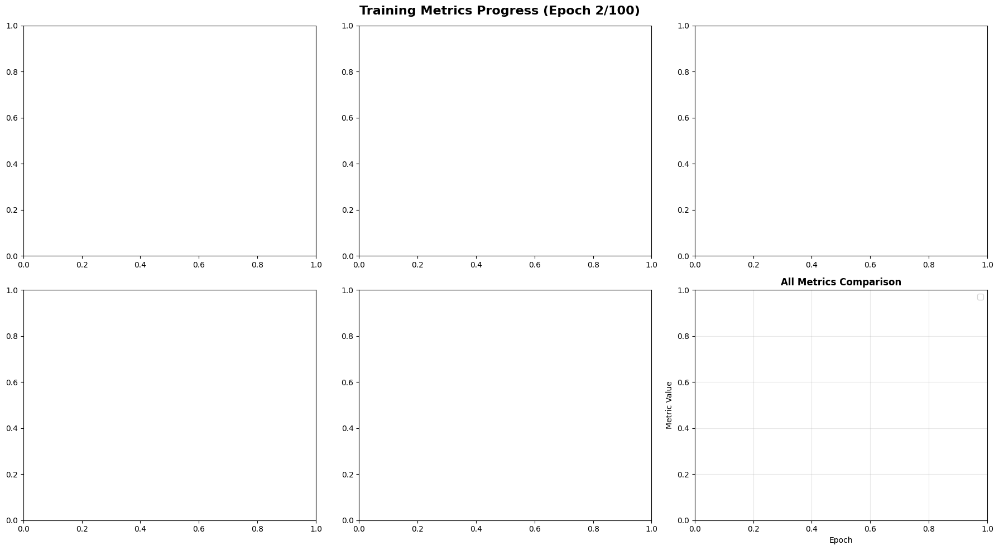



CURRENT STATUS - 14:29:41
  >>>  EPOCH: 2/100  <<<
  Status: Validation completed


CURRENT STATUS - 14:29:42
  >>>  EPOCH: 2/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
      2/100      4.53G     0.7179     0.7172      1.234         16        640: 100% ━━━━━━━━━━━━ 14/14 2.0s/it 28.0s1.8s

CURRENT STATUS - 14:30:10
  >>>  EPOCH: 2/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.1s/it 2.3s4.8s
                   all         28         35      0.727      0.457      0.604       0.37

EPOCH 3/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.7273
  metrics/recall(B): 0.2286
  metrics/mAP50(B): 0.4992
  metrics/mAP50-95(B): 0.3743
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metrics_ep

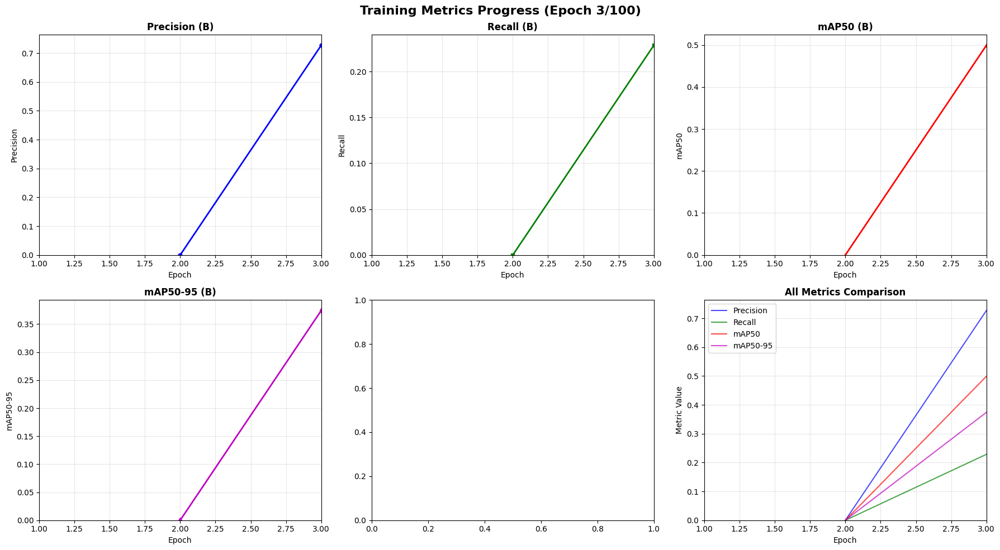



CURRENT STATUS - 14:30:14
  >>>  EPOCH: 3/100  <<<
  Status: Validation completed


CURRENT STATUS - 14:30:14
  >>>  EPOCH: 3/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
      3/100      4.53G     0.7379     0.7075      1.189         18        640: 100% ━━━━━━━━━━━━ 14/14 2.0s/it 27.7s2.2s

CURRENT STATUS - 14:30:42
  >>>  EPOCH: 3/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.3s/it 2.6s5.6s
                   all         28         35      0.946      0.771      0.906      0.692

EPOCH 4/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.7273
  metrics/recall(B): 0.4571
  metrics/mAP50(B): 0.6039
  metrics/mAP50-95(B): 0.3702
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metrics_ep

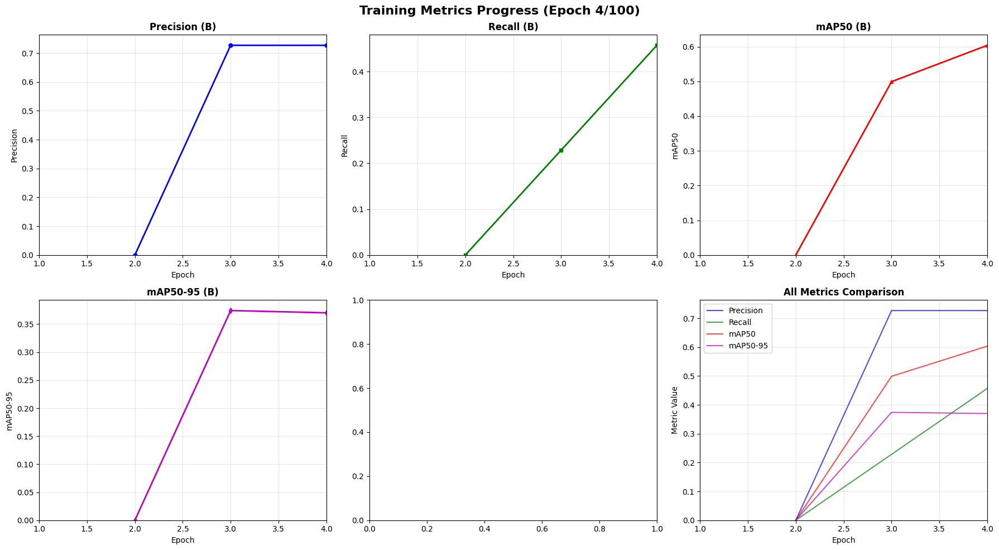



CURRENT STATUS - 14:30:46
  >>>  EPOCH: 4/100  <<<
  Status: Validation completed


CURRENT STATUS - 14:30:46
  >>>  EPOCH: 4/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
      4/100      4.53G     0.6662     0.6173      1.158         17        640: 100% ━━━━━━━━━━━━ 14/14 2.1s/it 29.1s2.0s

CURRENT STATUS - 14:31:16
  >>>  EPOCH: 4/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.3s/it 2.6s5.8s
                   all         28         35      0.808      0.771      0.825      0.669

EPOCH 5/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.9459
  metrics/recall(B): 0.7714
  metrics/mAP50(B): 0.9064
  metrics/mAP50-95(B): 0.6921
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metrics_ep

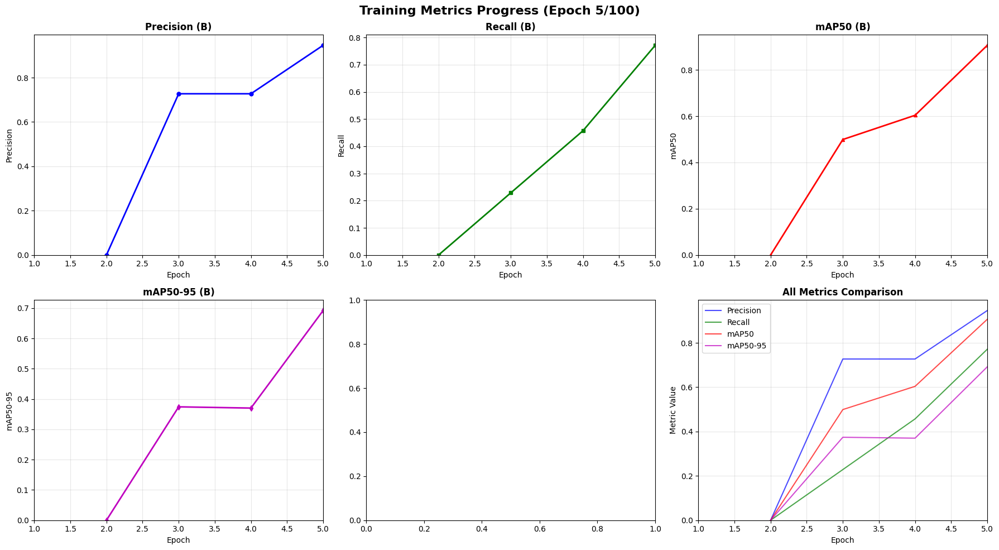



CURRENT STATUS - 14:31:19
  >>>  EPOCH: 5/100  <<<
  Status: Validation completed


CURRENT STATUS - 14:31:20
  >>>  EPOCH: 5/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
      5/100      4.53G     0.7711     0.6641      1.188         22        640: 100% ━━━━━━━━━━━━ 14/14 1.9s/it 26.6s1.9s

CURRENT STATUS - 14:31:47
  >>>  EPOCH: 5/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.7s/it 3.3s7.9s
                   all         28         35      0.916      0.943      0.952      0.772

EPOCH 6/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.8076
  metrics/recall(B): 0.7714
  metrics/mAP50(B): 0.8250
  metrics/mAP50-95(B): 0.6686
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metrics_ep

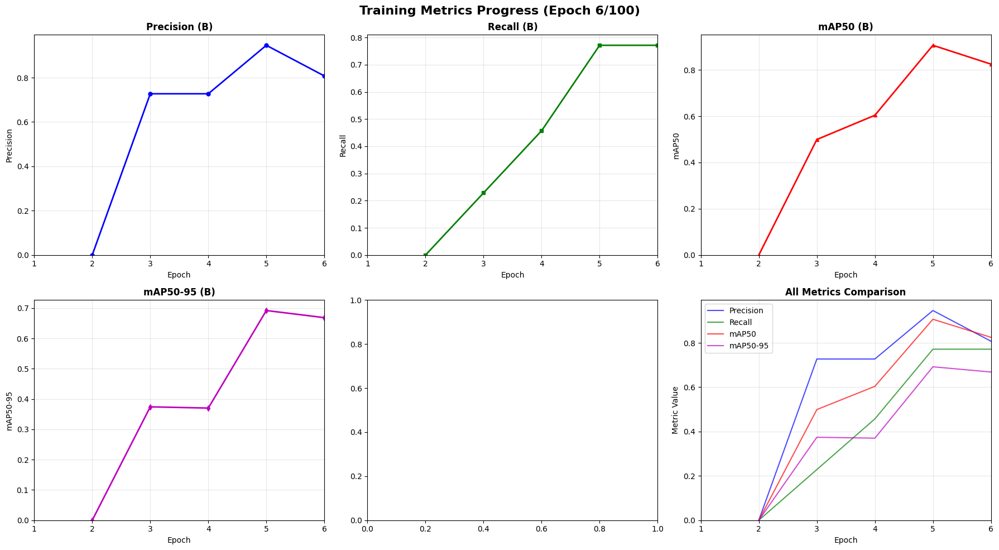



CURRENT STATUS - 14:31:51
  >>>  EPOCH: 6/100  <<<
  Status: Validation completed


CURRENT STATUS - 14:31:52
  >>>  EPOCH: 6/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
      6/100      4.53G     0.7682     0.6389      1.219         14        640: 100% ━━━━━━━━━━━━ 14/14 1.8s/it 25.8s1.9s

CURRENT STATUS - 14:32:18
  >>>  EPOCH: 6/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.2s/it 2.4s5.3s
                   all         28         35      0.892      0.857       0.92       0.81

EPOCH 7/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.9156
  metrics/recall(B): 0.9429
  metrics/mAP50(B): 0.9524
  metrics/mAP50-95(B): 0.7725
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metrics_ep

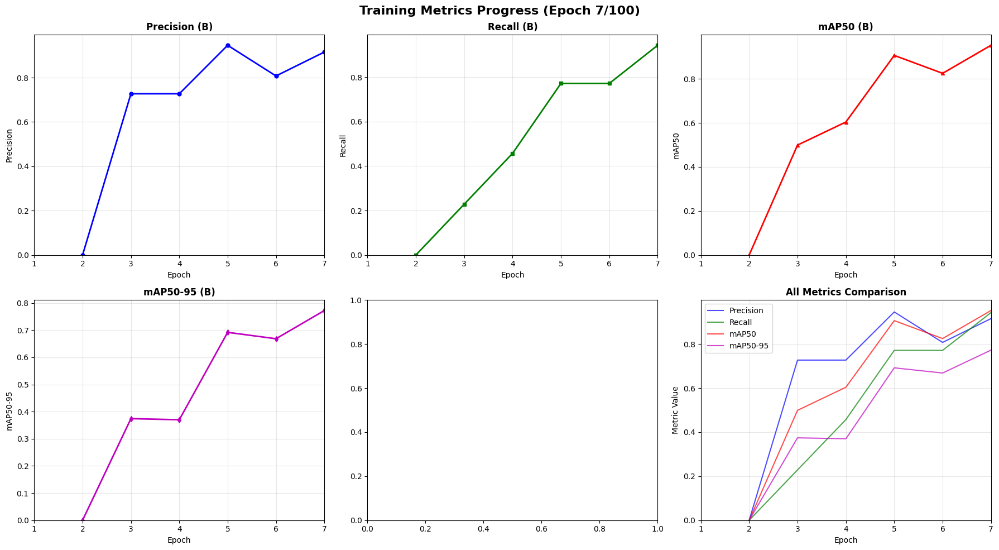



CURRENT STATUS - 14:32:21
  >>>  EPOCH: 7/100  <<<
  Status: Validation completed


CURRENT STATUS - 14:32:22
  >>>  EPOCH: 7/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
      7/100      4.53G     0.7441     0.6947      1.178         17        640: 100% ━━━━━━━━━━━━ 14/14 2.0s/it 27.4s2.1s

CURRENT STATUS - 14:32:49
  >>>  EPOCH: 7/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.2s/it 2.4s5.2s
                   all         28         35      0.815      0.829      0.874      0.749

EPOCH 8/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.8915
  metrics/recall(B): 0.8571
  metrics/mAP50(B): 0.9205
  metrics/mAP50-95(B): 0.8095
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metrics_ep

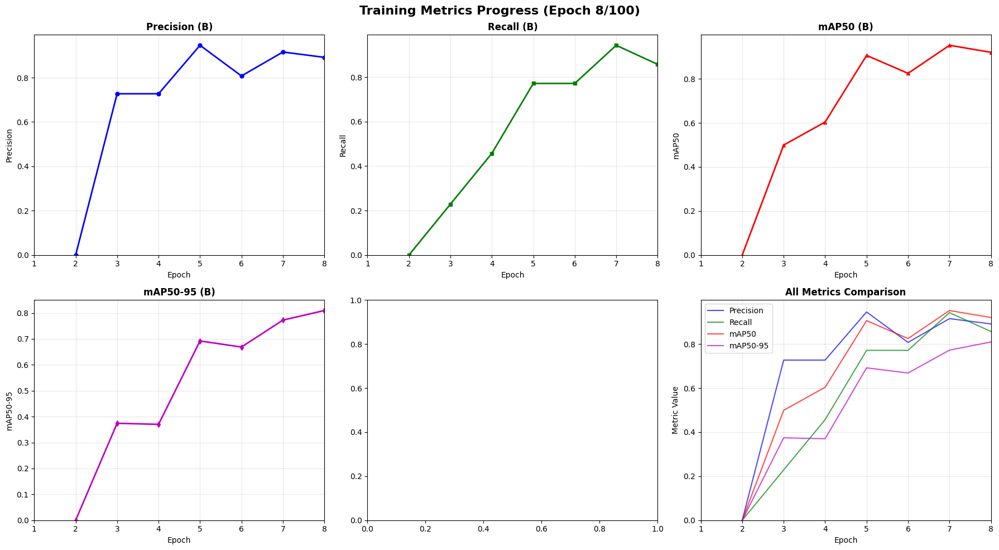



CURRENT STATUS - 14:32:53
  >>>  EPOCH: 8/100  <<<
  Status: Validation completed


CURRENT STATUS - 14:32:54
  >>>  EPOCH: 8/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
      8/100      4.53G      0.808     0.7159      1.228         11        640: 100% ━━━━━━━━━━━━ 14/14 2.1s/it 29.3s2.0s

CURRENT STATUS - 14:33:23
  >>>  EPOCH: 8/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.2s/it 2.4s5.3s
                   all         28         35      0.989      0.657      0.839      0.702

EPOCH 9/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.8155
  metrics/recall(B): 0.8286
  metrics/mAP50(B): 0.8738
  metrics/mAP50-95(B): 0.7489
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metrics_ep

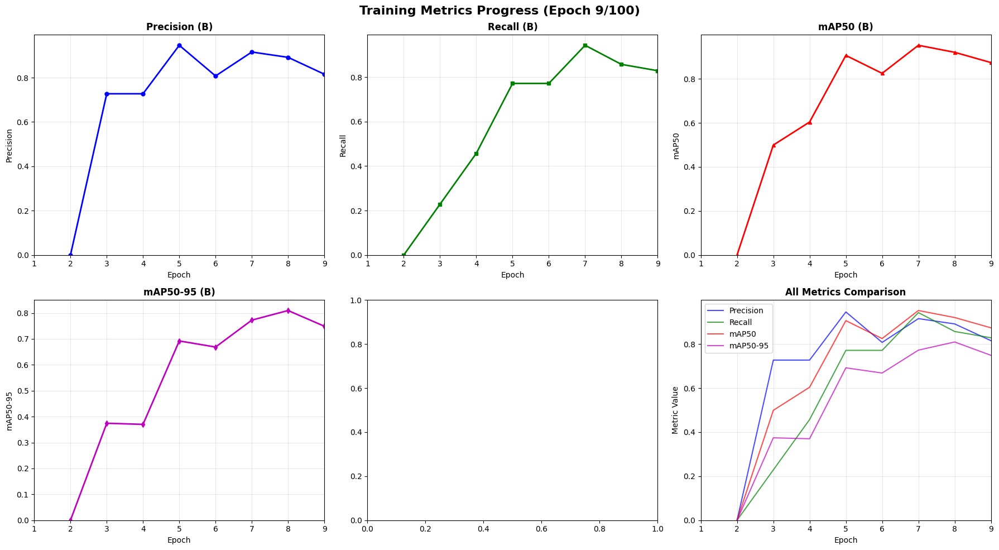



CURRENT STATUS - 14:33:26
  >>>  EPOCH: 9/100  <<<
  Status: Validation completed


CURRENT STATUS - 14:33:27
  >>>  EPOCH: 9/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
      9/100      4.53G     0.7666     0.6228      1.209         17        640: 100% ━━━━━━━━━━━━ 14/14 2.0s/it 27.9s2.0s

CURRENT STATUS - 14:33:55
  >>>  EPOCH: 9/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.3s/it 2.5s5.3s
                   all         28         35      0.744      0.914      0.896      0.774

EPOCH 10/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.9895
  metrics/recall(B): 0.6571
  metrics/mAP50(B): 0.8385
  metrics/mAP50-95(B): 0.7020
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metrics_e

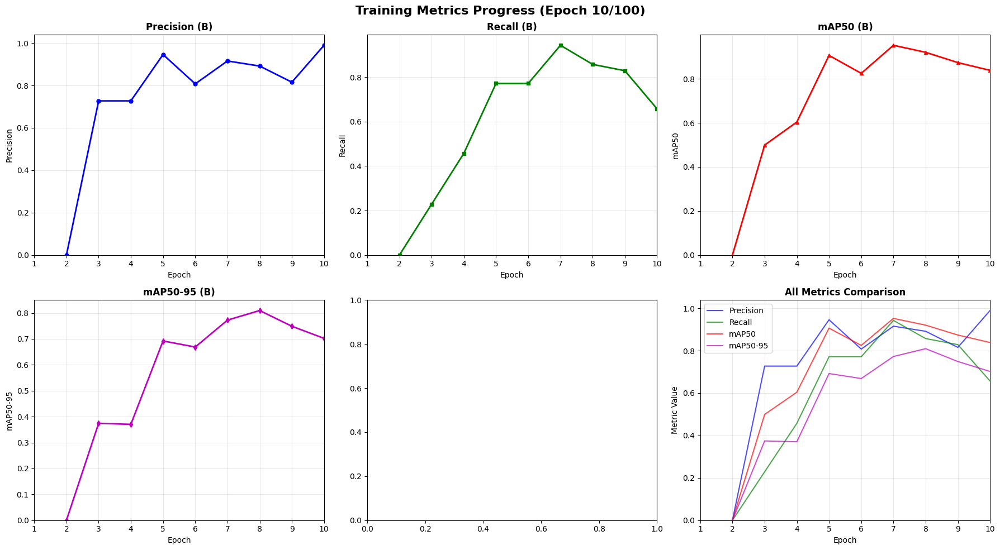



CURRENT STATUS - 14:33:59
  >>>  EPOCH: 10/100  <<<
  Status: Validation completed


CURRENT STATUS - 14:34:00
  >>>  EPOCH: 10/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     10/100      4.53G     0.7656     0.6416      1.213         17        640: 100% ━━━━━━━━━━━━ 14/14 2.0s/it 28.6s1.9s

CURRENT STATUS - 14:34:28
  >>>  EPOCH: 10/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.3s/it 2.5s5.6s
                   all         28         35      0.906      0.823      0.872      0.766

EPOCH 11/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.7442
  metrics/recall(B): 0.9143
  metrics/mAP50(B): 0.8959
  metrics/mAP50-95(B): 0.7743
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metric

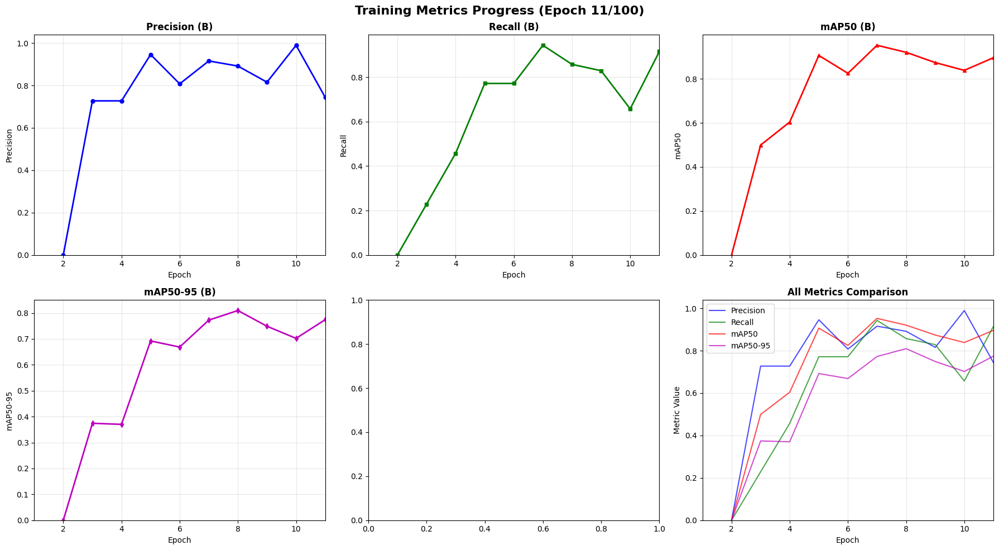



CURRENT STATUS - 14:34:32
  >>>  EPOCH: 11/100  <<<
  Status: Validation completed


CURRENT STATUS - 14:34:32
  >>>  EPOCH: 11/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     11/100      4.53G     0.6849     0.6305      1.118         13        640: 100% ━━━━━━━━━━━━ 14/14 2.0s/it 27.7s2.0s

CURRENT STATUS - 14:35:00
  >>>  EPOCH: 11/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.3s/it 2.6s5.4s
                   all         28         35          1      0.703      0.817       0.71

EPOCH 12/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.9056
  metrics/recall(B): 0.8227
  metrics/mAP50(B): 0.8719
  metrics/mAP50-95(B): 0.7658
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metric

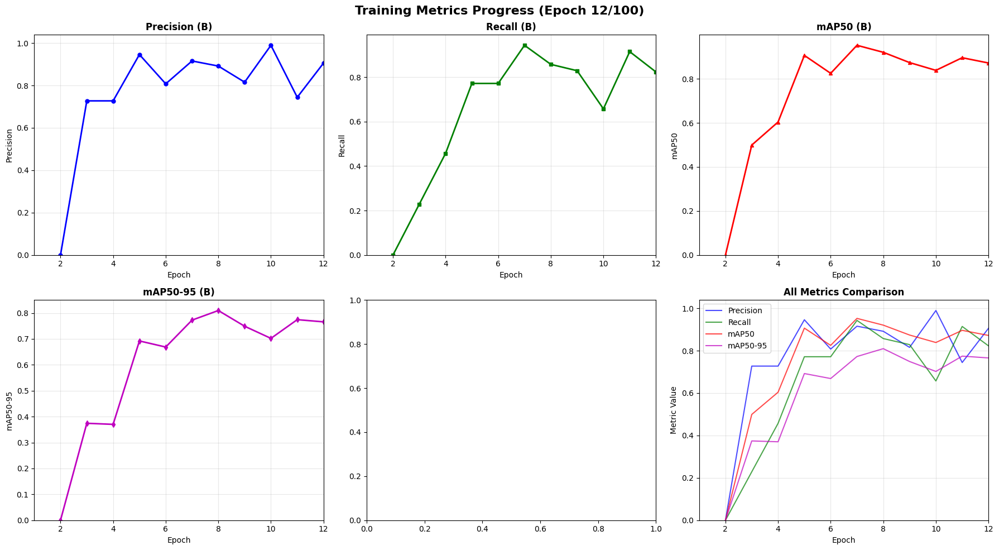



CURRENT STATUS - 14:35:04
  >>>  EPOCH: 12/100  <<<
  Status: Validation completed


CURRENT STATUS - 14:35:05
  >>>  EPOCH: 12/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     12/100      4.53G     0.7446     0.6743      1.173         19        640: 100% ━━━━━━━━━━━━ 14/14 2.3s/it 32.4s2.3s

CURRENT STATUS - 14:35:37
  >>>  EPOCH: 12/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.3s/it 2.6s5.9s
                   all         28         35      0.965      0.791      0.923       0.81

EPOCH 13/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 1.0000
  metrics/recall(B): 0.7033
  metrics/mAP50(B): 0.8169
  metrics/mAP50-95(B): 0.7100
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metric

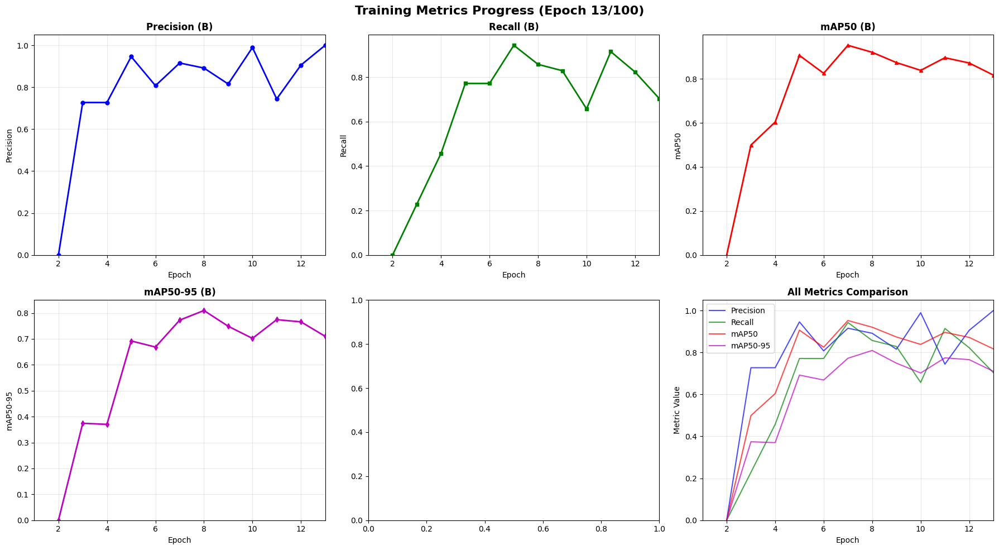



CURRENT STATUS - 14:35:41
  >>>  EPOCH: 13/100  <<<
  Status: Validation completed


CURRENT STATUS - 14:35:42
  >>>  EPOCH: 13/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     13/100      4.53G     0.7625     0.6899      1.218         11        640: 100% ━━━━━━━━━━━━ 14/14 2.6s/it 36.8s2.8ss

CURRENT STATUS - 14:36:18
  >>>  EPOCH: 13/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.4s/it 2.9s5.6s
                   all         28         35      0.969      0.904       0.94      0.842

EPOCH 14/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.9651
  metrics/recall(B): 0.7909
  metrics/mAP50(B): 0.9228
  metrics/mAP50-95(B): 0.8098
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metri

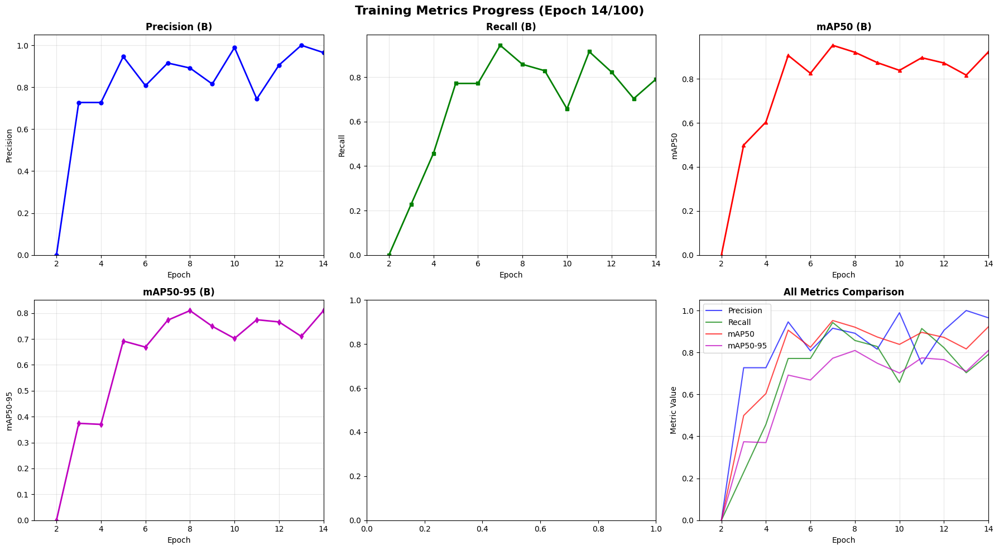



CURRENT STATUS - 14:36:22
  >>>  EPOCH: 14/100  <<<
  Status: Validation completed


CURRENT STATUS - 14:36:23
  >>>  EPOCH: 14/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     14/100      4.54G     0.7008     0.6408      1.134         19        640: 100% ━━━━━━━━━━━━ 14/14 3.2s/it 45.4s2.3ss

CURRENT STATUS - 14:37:09
  >>>  EPOCH: 14/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.4s/it 2.9s5.5s
                   all         28         35      0.909      0.914       0.94      0.847

EPOCH 15/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.9694
  metrics/recall(B): 0.9037
  metrics/mAP50(B): 0.9399
  metrics/mAP50-95(B): 0.8417
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metri

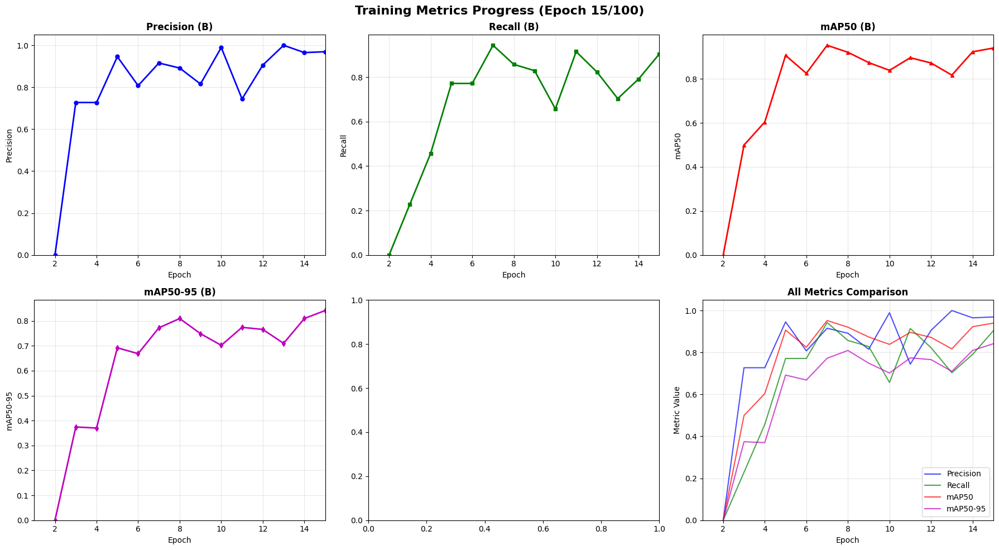



CURRENT STATUS - 14:37:13
  >>>  EPOCH: 15/100  <<<
  Status: Validation completed


CURRENT STATUS - 14:37:14
  >>>  EPOCH: 15/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     15/100      4.53G     0.7211     0.5819       1.12         20        640: 100% ━━━━━━━━━━━━ 14/14 2.6s/it 36.3s2.7ss

CURRENT STATUS - 14:37:50
  >>>  EPOCH: 15/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.6s/it 3.3s5.5s
                   all         28         35      0.999      0.857      0.934      0.848

EPOCH 16/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.9093
  metrics/recall(B): 0.9143
  metrics/mAP50(B): 0.9405
  metrics/mAP50-95(B): 0.8466
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metri

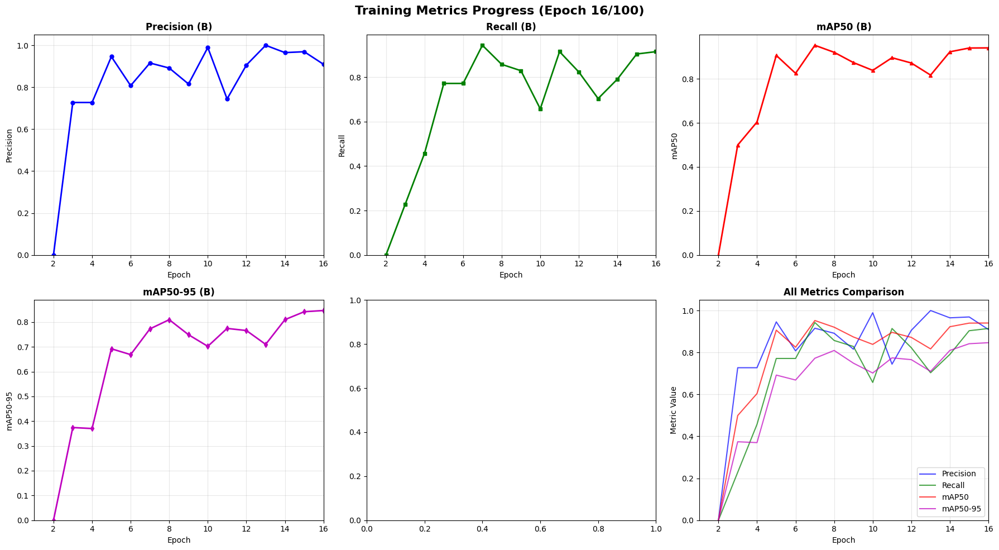



CURRENT STATUS - 14:37:55
  >>>  EPOCH: 16/100  <<<
  Status: Validation completed


CURRENT STATUS - 14:37:56
  >>>  EPOCH: 16/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     16/100      4.53G     0.7558      0.619      1.161         16        640: 100% ━━━━━━━━━━━━ 14/14 2.5s/it 34.8s2.1s

CURRENT STATUS - 14:38:31
  >>>  EPOCH: 16/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.3s/it 2.5s5.5s
                   all         28         35      0.945      0.914      0.954      0.862

EPOCH 17/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.9989
  metrics/recall(B): 0.8571
  metrics/mAP50(B): 0.9343
  metrics/mAP50-95(B): 0.8478
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metric

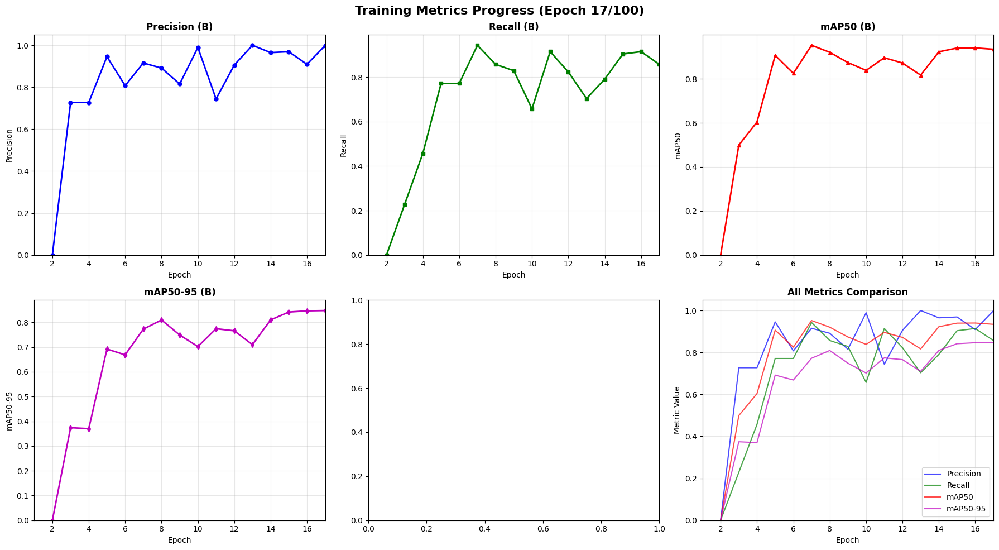



CURRENT STATUS - 14:38:35
  >>>  EPOCH: 17/100  <<<
  Status: Validation completed


CURRENT STATUS - 14:38:36
  >>>  EPOCH: 17/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     17/100      4.53G     0.6994     0.5946      1.173         11        640: 100% ━━━━━━━━━━━━ 14/14 2.2s/it 30.4s1.9s

CURRENT STATUS - 14:39:06
  >>>  EPOCH: 17/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 2.0s/it 3.9s9.3s
                   all         28         35      0.966      0.914      0.962      0.827

EPOCH 18/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.9446
  metrics/recall(B): 0.9143
  metrics/mAP50(B): 0.9542
  metrics/mAP50-95(B): 0.8618
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metric

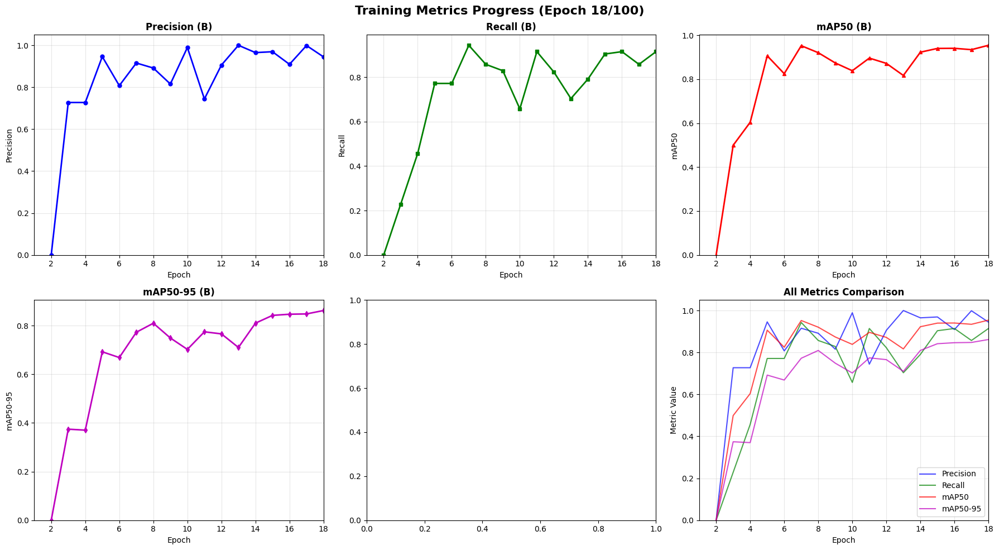



CURRENT STATUS - 14:39:11
  >>>  EPOCH: 18/100  <<<
  Status: Validation completed


CURRENT STATUS - 14:39:12
  >>>  EPOCH: 18/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     18/100      4.53G     0.7285     0.6022      1.171         13        640: 100% ━━━━━━━━━━━━ 14/14 3.5s/it 48.5s3.0ss

CURRENT STATUS - 14:40:00
  >>>  EPOCH: 18/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 2.4s/it 4.7s7.3s
                   all         28         35      0.962      0.886      0.935      0.782

EPOCH 19/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.9658
  metrics/recall(B): 0.9143
  metrics/mAP50(B): 0.9616
  metrics/mAP50-95(B): 0.8275
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metri

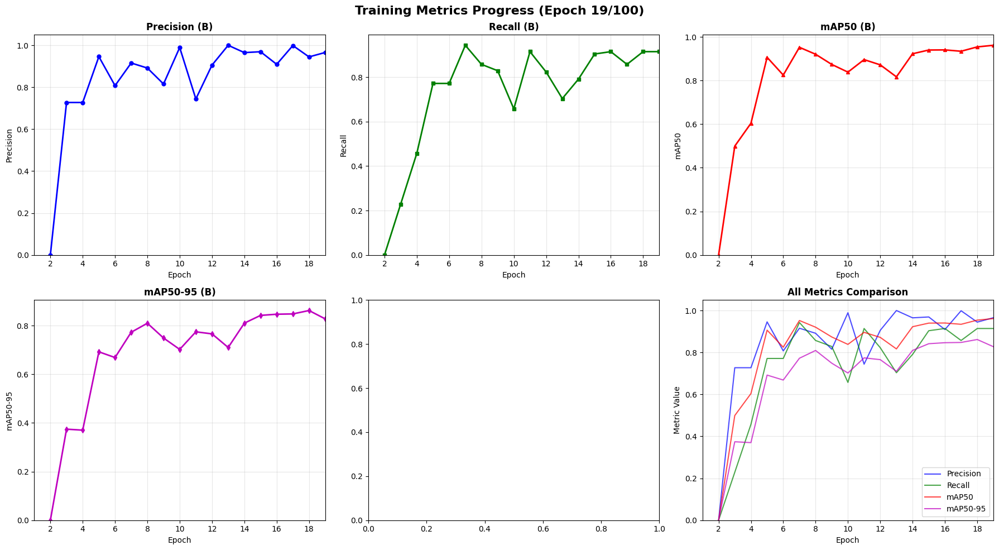



CURRENT STATUS - 14:40:06
  >>>  EPOCH: 19/100  <<<
  Status: Validation completed


CURRENT STATUS - 14:40:08
  >>>  EPOCH: 19/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     19/100      4.53G     0.7013     0.6533      1.111         27        640: 100% ━━━━━━━━━━━━ 14/14 3.0s/it 41.7s2.8ss

CURRENT STATUS - 14:40:50
  >>>  EPOCH: 19/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.6s/it 3.1s5.9s
                   all         28         35      0.953      0.857      0.939      0.813

EPOCH 20/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.9616
  metrics/recall(B): 0.8857
  metrics/mAP50(B): 0.9346
  metrics/mAP50-95(B): 0.7820
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metri

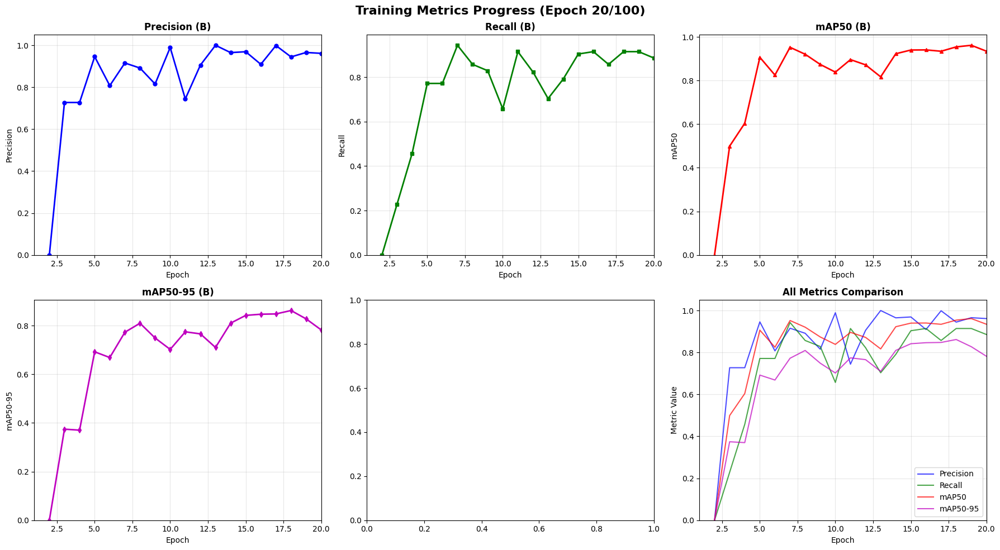



CURRENT STATUS - 14:40:54
  >>>  EPOCH: 20/100  <<<
  Status: Validation completed


CURRENT STATUS - 14:40:55
  >>>  EPOCH: 20/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     20/100      4.53G     0.6506     0.5401      1.103         21        640: 100% ━━━━━━━━━━━━ 14/14 2.8s/it 39.3s2.8ss

CURRENT STATUS - 14:41:34
  >>>  EPOCH: 20/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.4s/it 2.7s5.7s
                   all         28         35      0.935      0.857      0.921      0.776

EPOCH 21/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.9532
  metrics/recall(B): 0.8571
  metrics/mAP50(B): 0.9386
  metrics/mAP50-95(B): 0.8129
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metri

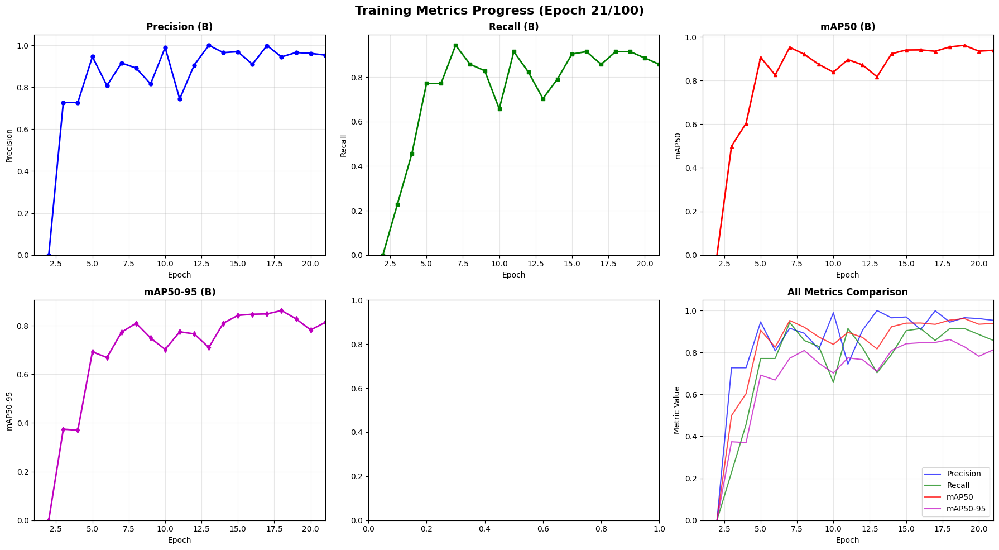



CURRENT STATUS - 14:41:38
  >>>  EPOCH: 21/100  <<<
  Status: Validation completed


CURRENT STATUS - 14:41:39
  >>>  EPOCH: 21/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     21/100      4.53G     0.6554     0.5628      1.094         12        640: 100% ━━━━━━━━━━━━ 14/14 2.3s/it 32.8s2.2ss

CURRENT STATUS - 14:42:12
  >>>  EPOCH: 21/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.2s/it 2.4s5.3s
                   all         28         35      0.967      0.826      0.901      0.779

EPOCH 22/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.9347
  metrics/recall(B): 0.8571
  metrics/mAP50(B): 0.9209
  metrics/mAP50-95(B): 0.7764
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metri

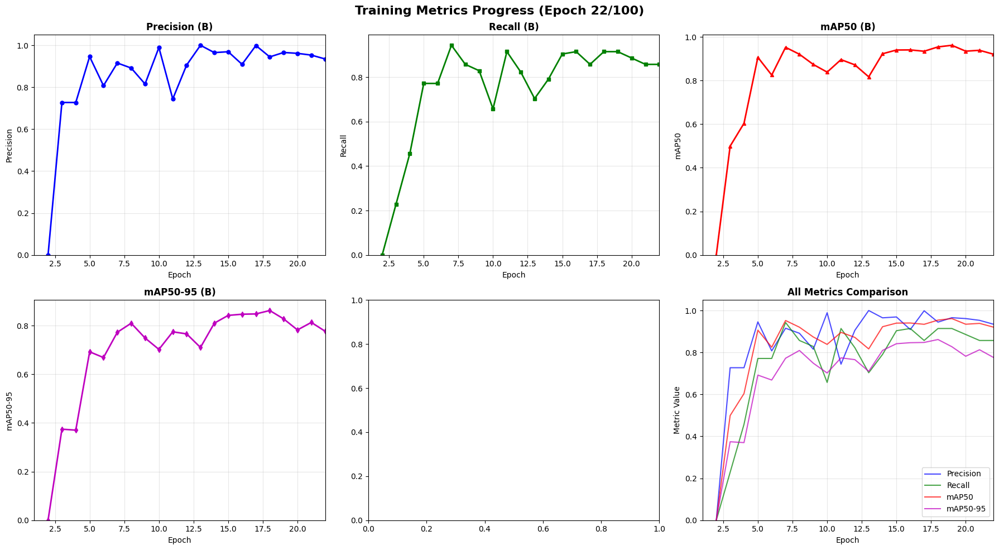



CURRENT STATUS - 14:42:15
  >>>  EPOCH: 22/100  <<<
  Status: Validation completed


CURRENT STATUS - 14:42:16
  >>>  EPOCH: 22/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     22/100      4.53G     0.6828     0.5597      1.107         24        640: 100% ━━━━━━━━━━━━ 14/14 2.6s/it 35.8s2.6ss

CURRENT STATUS - 14:42:52
  >>>  EPOCH: 22/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 2.0s/it 4.1s9.0s
                   all         28         35      0.969      0.883      0.918      0.823

EPOCH 23/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.9666
  metrics/recall(B): 0.8264
  metrics/mAP50(B): 0.9006
  metrics/mAP50-95(B): 0.7788
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metri

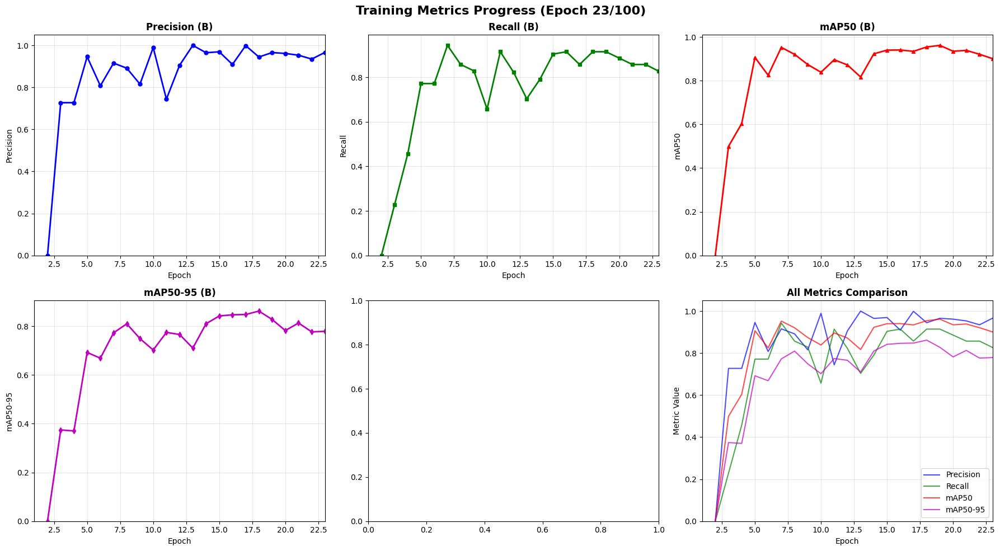



CURRENT STATUS - 14:42:57
  >>>  EPOCH: 23/100  <<<
  Status: Validation completed


CURRENT STATUS - 14:42:58
  >>>  EPOCH: 23/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     23/100      4.53G     0.6503     0.5578      1.086         14        640: 100% ━━━━━━━━━━━━ 14/14 2.6s/it 36.4s2.0ss

CURRENT STATUS - 14:43:34
  >>>  EPOCH: 23/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.4s/it 2.8s6.2s
                   all         28         35      0.938      0.868       0.92      0.841

EPOCH 24/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.9687
  metrics/recall(B): 0.8831
  metrics/mAP50(B): 0.9180
  metrics/mAP50-95(B): 0.8235
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metri

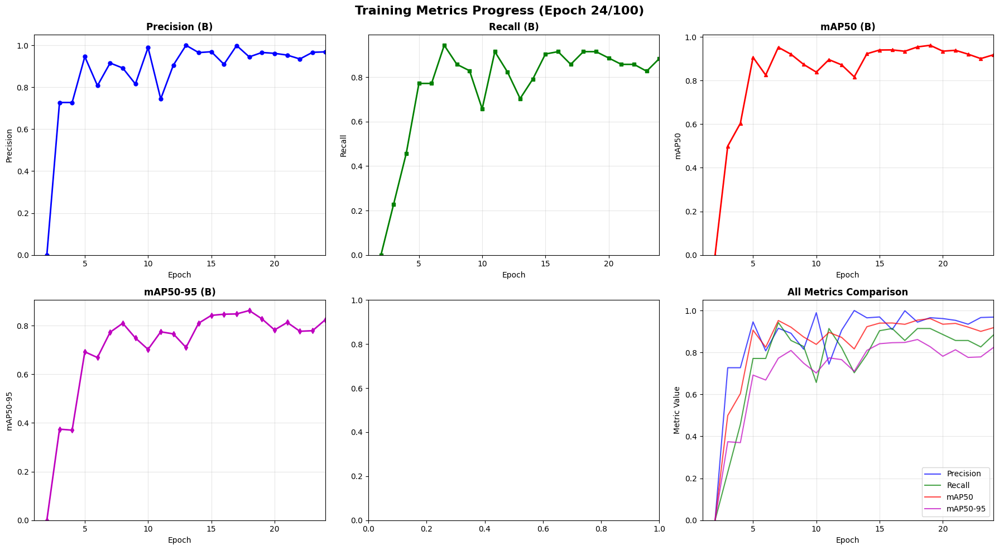



CURRENT STATUS - 14:43:38
  >>>  EPOCH: 24/100  <<<
  Status: Validation completed


CURRENT STATUS - 14:43:39
  >>>  EPOCH: 24/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     24/100      4.53G     0.6733     0.5422      1.148         12        640: 100% ━━━━━━━━━━━━ 14/14 3.0s/it 42.0s3.0ss

CURRENT STATUS - 14:44:21
  >>>  EPOCH: 24/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.3s/it 2.6s5.7s
                   all         28         35       0.97      0.914      0.949       0.86

EPOCH 25/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.9382
  metrics/recall(B): 0.8681
  metrics/mAP50(B): 0.9203
  metrics/mAP50-95(B): 0.8412
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metri

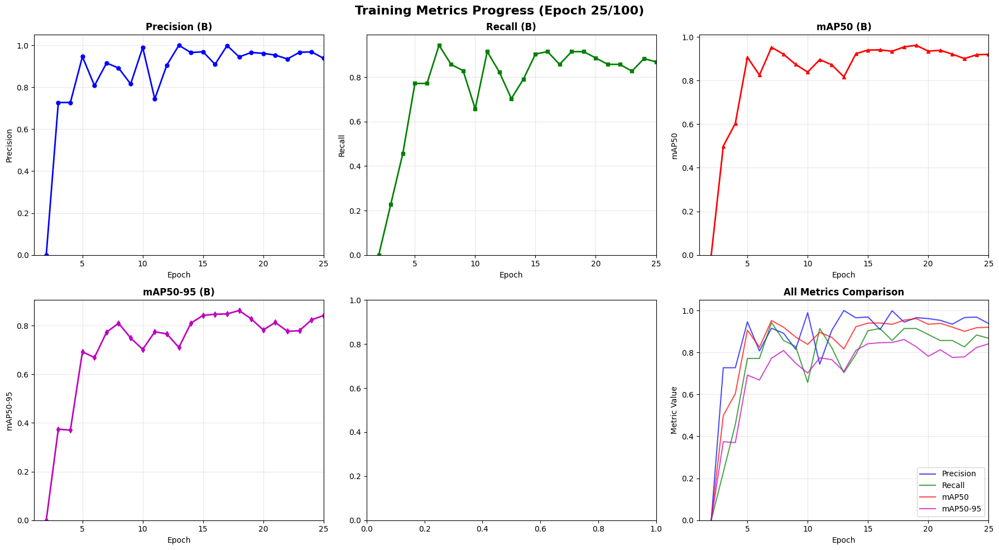



CURRENT STATUS - 14:44:25
  >>>  EPOCH: 25/100  <<<
  Status: Validation completed


CURRENT STATUS - 14:44:26
  >>>  EPOCH: 25/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     25/100      4.53G     0.6163     0.5329       1.08         11        640: 100% ━━━━━━━━━━━━ 14/14 2.8s/it 39.4s3.1s

CURRENT STATUS - 14:45:05
  >>>  EPOCH: 25/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.3s/it 2.6s5.5s
                   all         28         35       0.97      0.913      0.944      0.843

EPOCH 26/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.9697
  metrics/recall(B): 0.9140
  metrics/mAP50(B): 0.9495
  metrics/mAP50-95(B): 0.8595
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metric

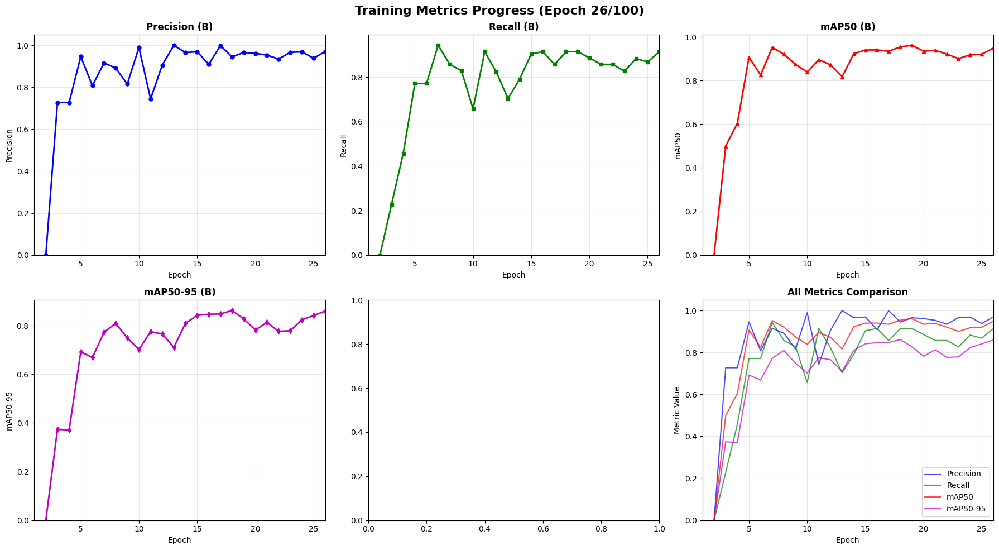



CURRENT STATUS - 14:45:09
  >>>  EPOCH: 26/100  <<<
  Status: Validation completed


CURRENT STATUS - 14:45:09
  >>>  EPOCH: 26/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     26/100      4.53G     0.6507     0.5239      1.087         17        640: 100% ━━━━━━━━━━━━ 14/14 2.8s/it 38.6s2.5ss

CURRENT STATUS - 14:45:48
  >>>  EPOCH: 26/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.5s/it 3.0s5.9s
                   all         28         35      0.922      0.829      0.895      0.822

EPOCH 27/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.9697
  metrics/recall(B): 0.9135
  metrics/mAP50(B): 0.9444
  metrics/mAP50-95(B): 0.8427
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metri

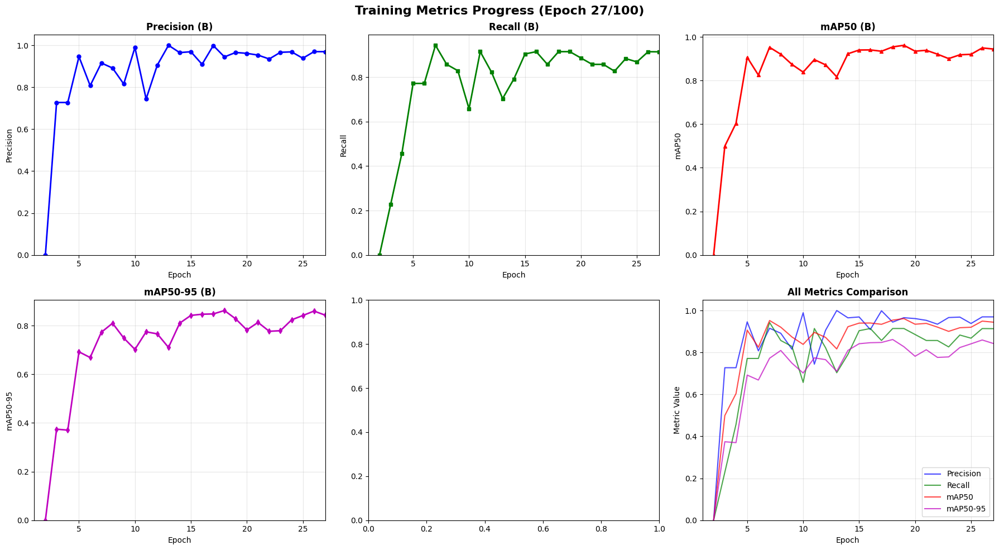



CURRENT STATUS - 14:45:52
  >>>  EPOCH: 27/100  <<<
  Status: Validation completed


CURRENT STATUS - 14:45:53
  >>>  EPOCH: 27/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     27/100      4.53G     0.6322     0.5165      1.084         11        640: 100% ━━━━━━━━━━━━ 14/14 2.7s/it 37.9s2.5s

CURRENT STATUS - 14:46:31
  >>>  EPOCH: 27/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.3s/it 2.6s5.3s
                   all         28         35      0.927      0.829      0.897      0.824

EPOCH 28/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.9225
  metrics/recall(B): 0.8286
  metrics/mAP50(B): 0.8949
  metrics/mAP50-95(B): 0.8222
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metric

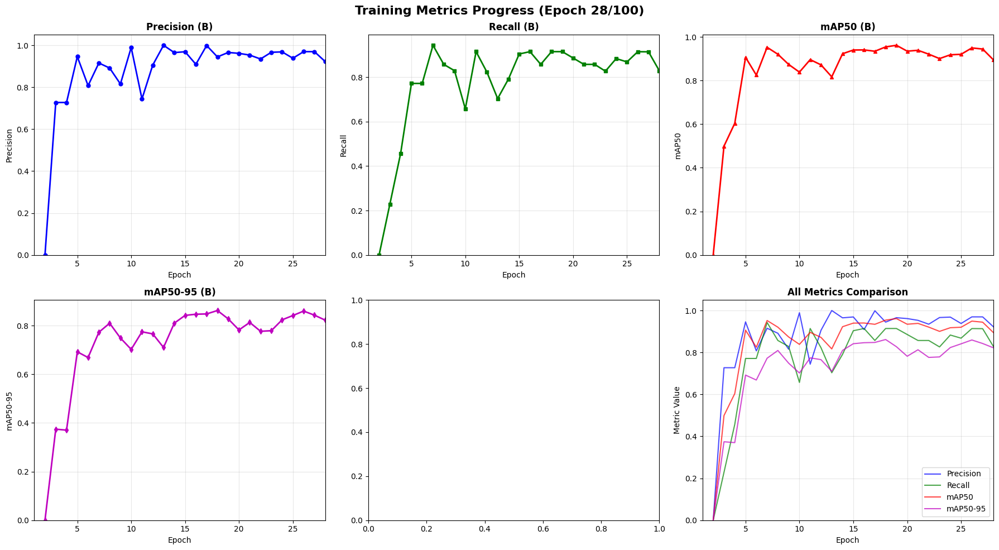



CURRENT STATUS - 14:46:35
  >>>  EPOCH: 28/100  <<<
  Status: Validation completed


CURRENT STATUS - 14:46:36
  >>>  EPOCH: 28/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     28/100      4.53G     0.6484     0.5259       1.11         15        640: 100% ━━━━━━━━━━━━ 14/14 2.4s/it 33.7s1.7s

CURRENT STATUS - 14:47:09
  >>>  EPOCH: 28/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.5s/it 3.1s6.8s
                   all         28         35      0.877      0.857      0.902      0.817

EPOCH 29/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.9271
  metrics/recall(B): 0.8286
  metrics/mAP50(B): 0.8968
  metrics/mAP50-95(B): 0.8242
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metric

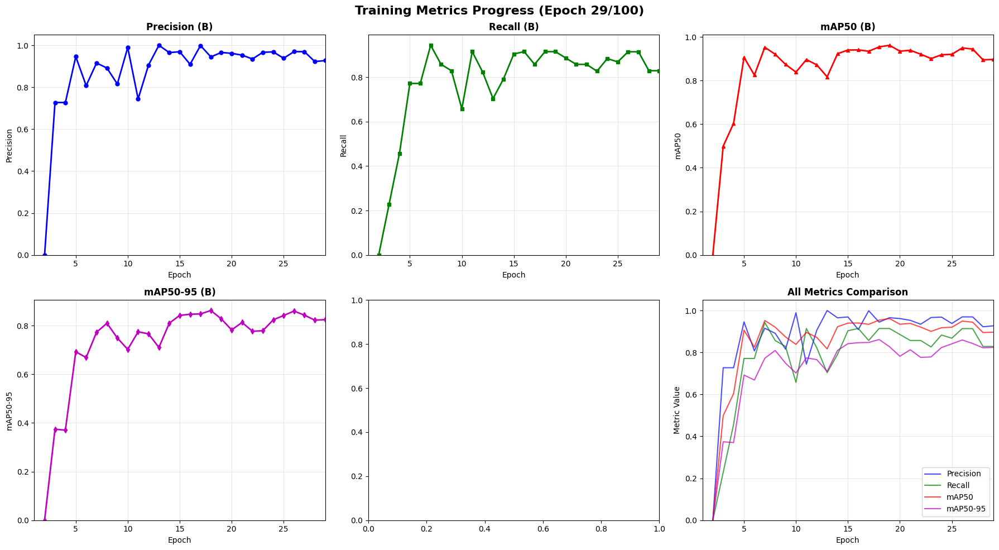



CURRENT STATUS - 14:47:13
  >>>  EPOCH: 29/100  <<<
  Status: Validation completed


CURRENT STATUS - 14:47:14
  >>>  EPOCH: 29/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     29/100      4.53G      0.644     0.5557       1.11         22        640: 100% ━━━━━━━━━━━━ 14/14 3.2s/it 44.3s3.5ss

CURRENT STATUS - 14:47:58
  >>>  EPOCH: 29/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.5s/it 2.9s6.6s
                   all         28         35      0.962      0.771      0.911      0.798

EPOCH 30/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.8775
  metrics/recall(B): 0.8571
  metrics/mAP50(B): 0.9020
  metrics/mAP50-95(B): 0.8166
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metri

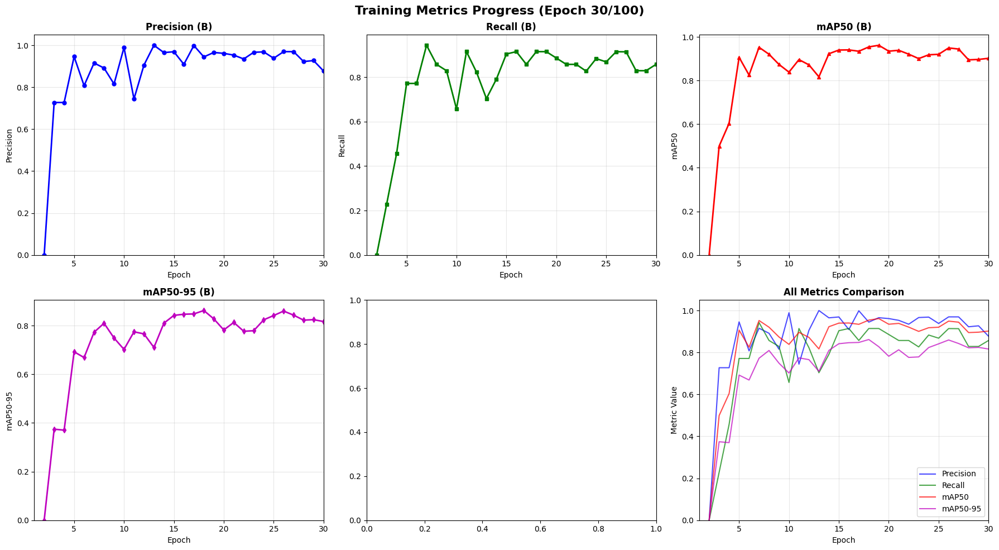



CURRENT STATUS - 14:48:02
  >>>  EPOCH: 30/100  <<<
  Status: Validation completed


CURRENT STATUS - 14:48:03
  >>>  EPOCH: 30/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     30/100      4.53G     0.6214     0.5188      1.089         15        640: 100% ━━━━━━━━━━━━ 14/14 3.0s/it 42.6s2.8s

CURRENT STATUS - 14:48:46
  >>>  EPOCH: 30/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.4s/it 2.7s6.1s
                   all         28         35      0.921      0.771      0.888      0.787

EPOCH 31/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.9623
  metrics/recall(B): 0.7714
  metrics/mAP50(B): 0.9113
  metrics/mAP50-95(B): 0.7982
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metric

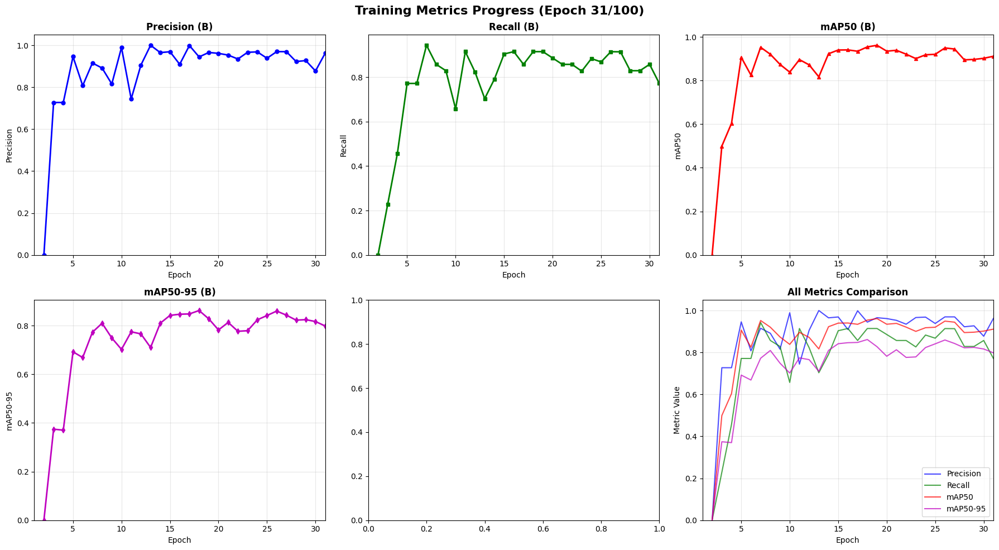



CURRENT STATUS - 14:48:50
  >>>  EPOCH: 31/100  <<<
  Status: Validation completed


CURRENT STATUS - 14:48:50
  >>>  EPOCH: 31/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     31/100      4.53G     0.5714     0.4759      1.053         14        640: 100% ━━━━━━━━━━━━ 14/14 3.1s/it 42.7s2.5ss

CURRENT STATUS - 14:49:33
  >>>  EPOCH: 31/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.4s/it 2.7s6.1s
                   all         28         35      0.925      0.771      0.886      0.789

EPOCH 32/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.9215
  metrics/recall(B): 0.7714
  metrics/mAP50(B): 0.8879
  metrics/mAP50-95(B): 0.7869
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metri

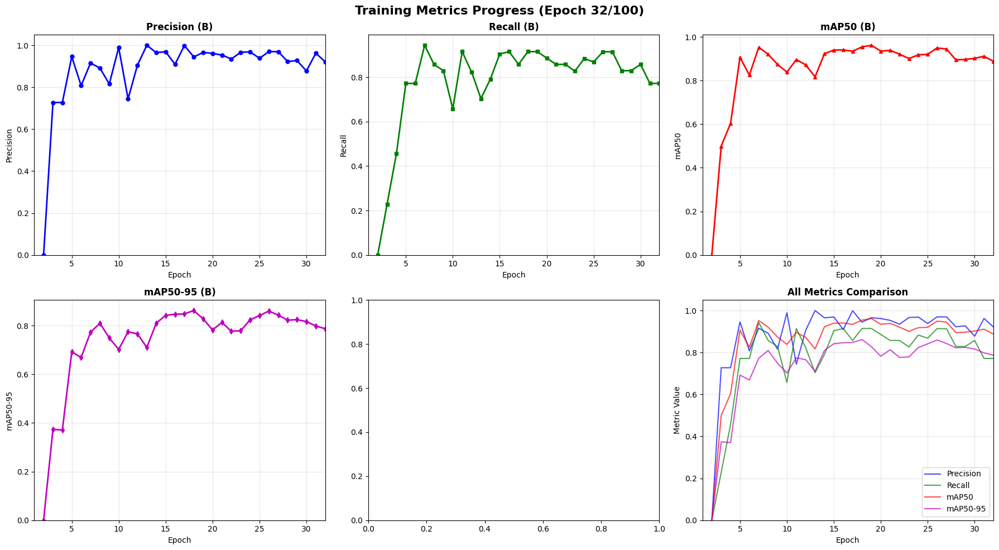



CURRENT STATUS - 14:49:37
  >>>  EPOCH: 32/100  <<<
  Status: Validation completed


CURRENT STATUS - 14:49:38
  >>>  EPOCH: 32/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     32/100      4.53G     0.5796     0.5064      1.048          9        640: 100% ━━━━━━━━━━━━ 14/14 2.7s/it 38.2s2.3s

CURRENT STATUS - 14:50:16
  >>>  EPOCH: 32/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.4s/it 2.8s6.1s
                   all         28         35       0.93      0.857      0.928      0.826

EPOCH 33/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.9245
  metrics/recall(B): 0.7714
  metrics/mAP50(B): 0.8858
  metrics/mAP50-95(B): 0.7885
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metric

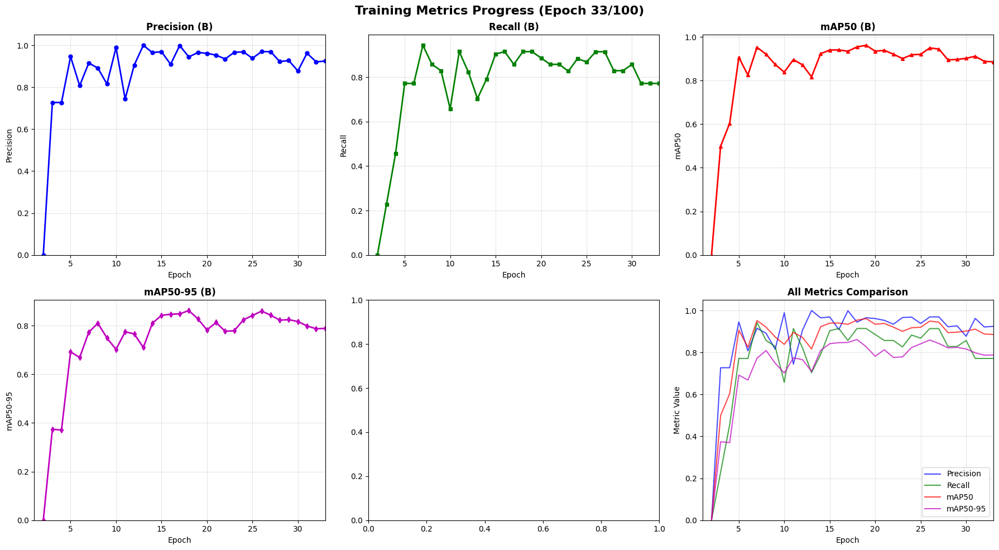



CURRENT STATUS - 14:50:20
  >>>  EPOCH: 33/100  <<<
  Status: Validation completed


CURRENT STATUS - 14:50:21
  >>>  EPOCH: 33/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     33/100      4.53G      0.633     0.5043      1.081         22        640: 100% ━━━━━━━━━━━━ 14/14 3.1s/it 43.2s2.4s

CURRENT STATUS - 14:51:04
  >>>  EPOCH: 33/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.3s/it 2.7s6.0s
                   all         28         35      0.983      0.857      0.937      0.841

EPOCH 34/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.9297
  metrics/recall(B): 0.8571
  metrics/mAP50(B): 0.9278
  metrics/mAP50-95(B): 0.8256
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metric

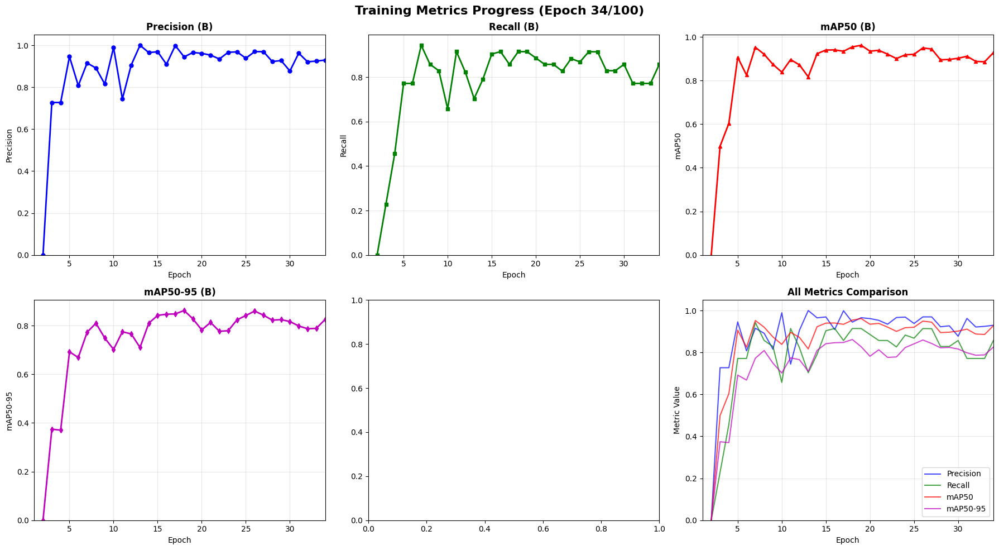



CURRENT STATUS - 14:51:08
  >>>  EPOCH: 34/100  <<<
  Status: Validation completed


CURRENT STATUS - 14:51:09
  >>>  EPOCH: 34/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     34/100      4.53G     0.6042     0.4634      1.084         15        640: 100% ━━━━━━━━━━━━ 14/14 3.0s/it 41.7s2.7s

CURRENT STATUS - 14:51:50
  >>>  EPOCH: 34/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.5s/it 3.1s6.7s
                   all         28         35      0.999      0.857      0.926      0.836

EPOCH 35/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.9833
  metrics/recall(B): 0.8571
  metrics/mAP50(B): 0.9366
  metrics/mAP50-95(B): 0.8405
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metric

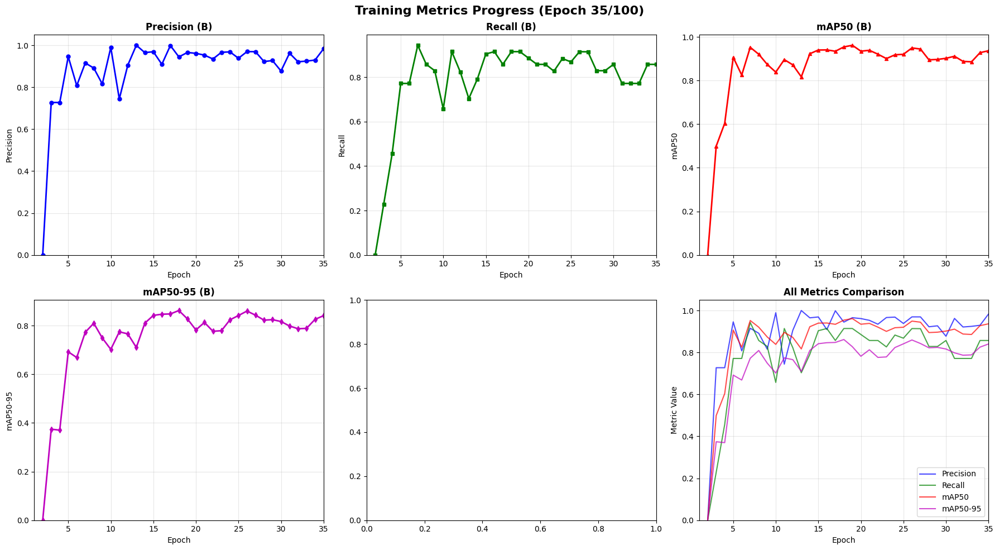



CURRENT STATUS - 14:51:55
  >>>  EPOCH: 35/100  <<<
  Status: Validation completed


CURRENT STATUS - 14:51:56
  >>>  EPOCH: 35/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     35/100      4.53G     0.5781     0.4374      1.061         20        640: 100% ━━━━━━━━━━━━ 14/14 3.1s/it 43.3s2.8ss

CURRENT STATUS - 14:52:40
  >>>  EPOCH: 35/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.4s/it 2.7s5.9s
                   all         28         35      0.932      0.857      0.938        0.8

EPOCH 36/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.9994
  metrics/recall(B): 0.8571
  metrics/mAP50(B): 0.9260
  metrics/mAP50-95(B): 0.8358
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metri

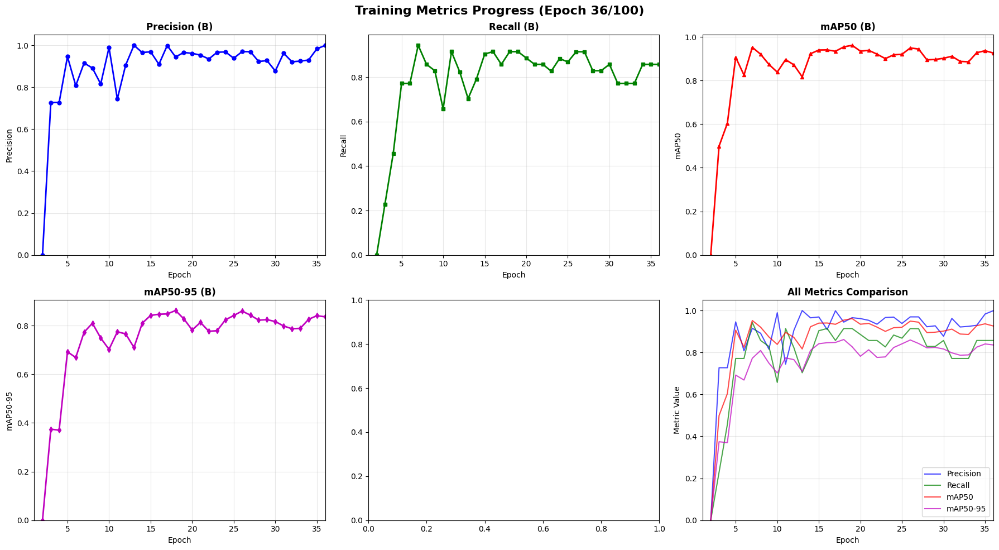



CURRENT STATUS - 14:52:44
  >>>  EPOCH: 36/100  <<<
  Status: Validation completed


CURRENT STATUS - 14:52:44
  >>>  EPOCH: 36/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     36/100      4.53G     0.5659      0.441      1.067         21        640: 100% ━━━━━━━━━━━━ 14/14 3.3s/it 45.7s3.1ss

CURRENT STATUS - 14:53:30
  >>>  EPOCH: 36/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.3s/it 2.6s5.5s
                   all         28         35      0.939      0.886      0.928      0.836

EPOCH 37/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.9318
  metrics/recall(B): 0.8571
  metrics/mAP50(B): 0.9377
  metrics/mAP50-95(B): 0.7999
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metri

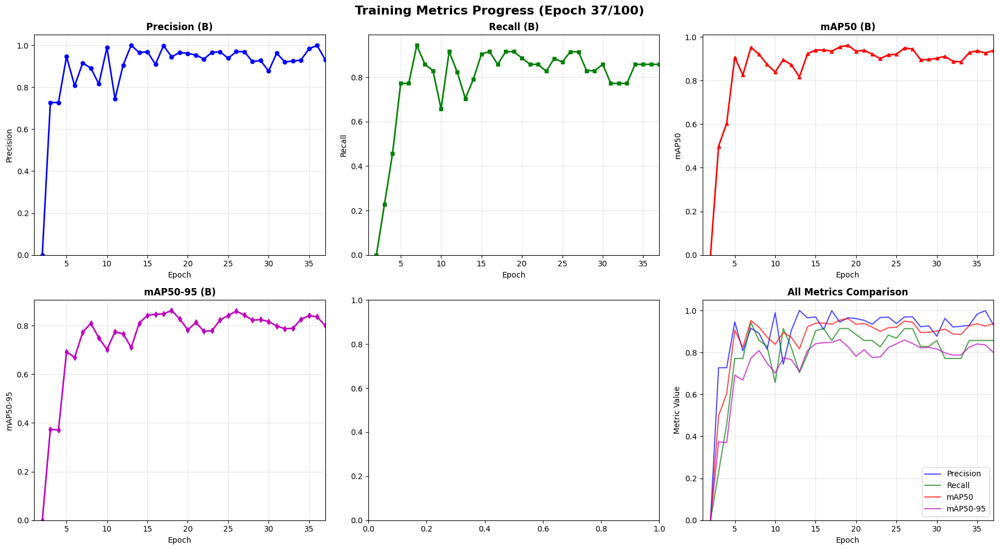



CURRENT STATUS - 14:53:34
  >>>  EPOCH: 37/100  <<<
  Status: Validation completed


CURRENT STATUS - 14:53:35
  >>>  EPOCH: 37/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     37/100      4.53G     0.5961     0.4642      1.093         29        640: 100% ━━━━━━━━━━━━ 14/14 3.0s/it 42.5s3.3ss

CURRENT STATUS - 14:54:17
  >>>  EPOCH: 37/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.3s/it 2.7s5.8s
                   all         28         35      0.969      0.881      0.933      0.847

EPOCH 38/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.9389
  metrics/recall(B): 0.8857
  metrics/mAP50(B): 0.9284
  metrics/mAP50-95(B): 0.8364
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metri

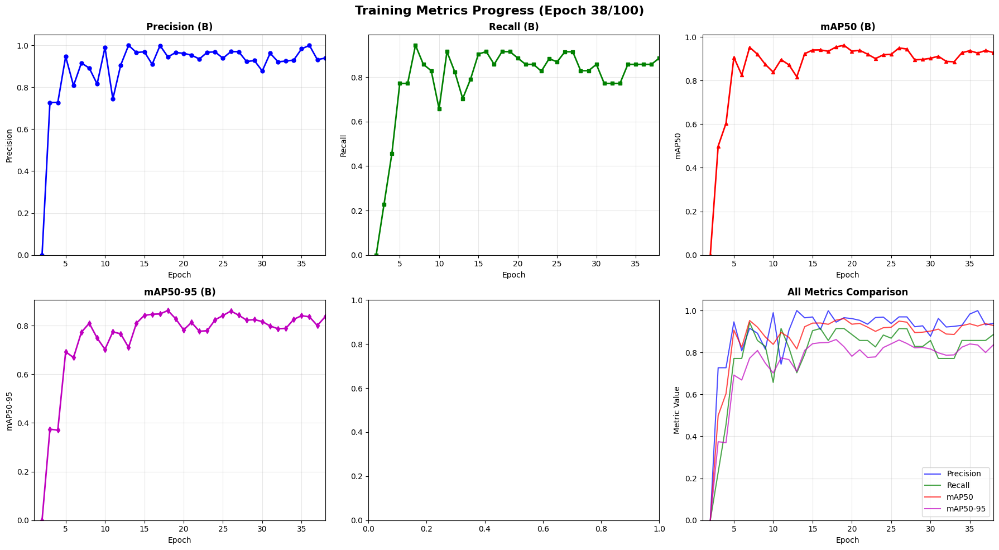



CURRENT STATUS - 14:54:21
  >>>  EPOCH: 38/100  <<<
  Status: Validation completed


CURRENT STATUS - 14:54:22
  >>>  EPOCH: 38/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     38/100      4.53G      0.569     0.4746      1.049         16        640: 100% ━━━━━━━━━━━━ 14/14 3.0s/it 42.3s2.9ss

CURRENT STATUS - 14:55:04
  >>>  EPOCH: 38/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.3s/it 2.6s5.5s
                   all         28         35      0.941      0.907      0.945      0.851

EPOCH 39/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.9686
  metrics/recall(B): 0.8811
  metrics/mAP50(B): 0.9333
  metrics/mAP50-95(B): 0.8471
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metri

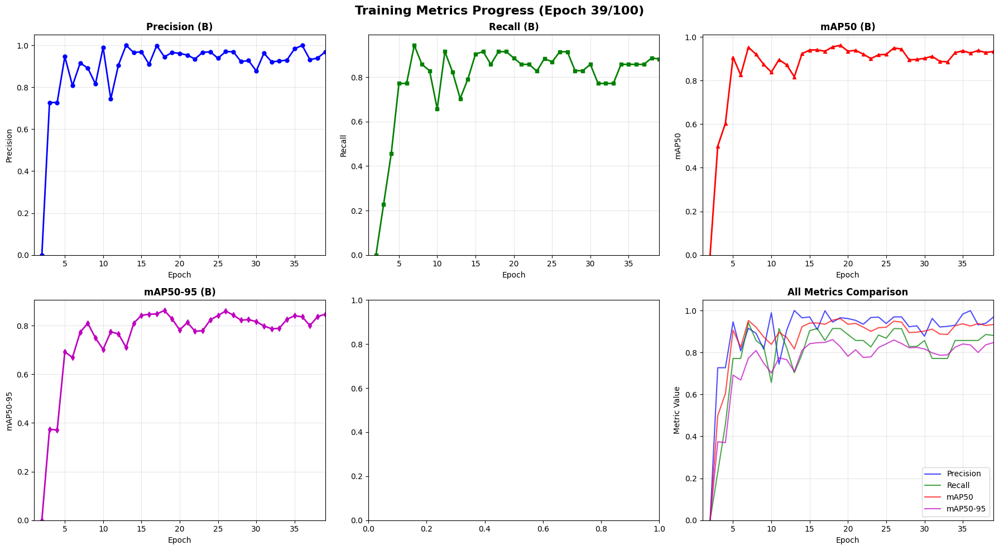



CURRENT STATUS - 14:55:08
  >>>  EPOCH: 39/100  <<<
  Status: Validation completed


CURRENT STATUS - 14:55:09
  >>>  EPOCH: 39/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     39/100      4.53G     0.5368       0.43      1.012         20        640: 100% ━━━━━━━━━━━━ 14/14 3.0s/it 42.5s3.0ss

CURRENT STATUS - 14:55:51
  >>>  EPOCH: 39/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.4s/it 2.8s6.3s
                   all         28         35      0.941      0.914      0.947      0.861

EPOCH 40/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.9407
  metrics/recall(B): 0.9069
  metrics/mAP50(B): 0.9454
  metrics/mAP50-95(B): 0.8512
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metri

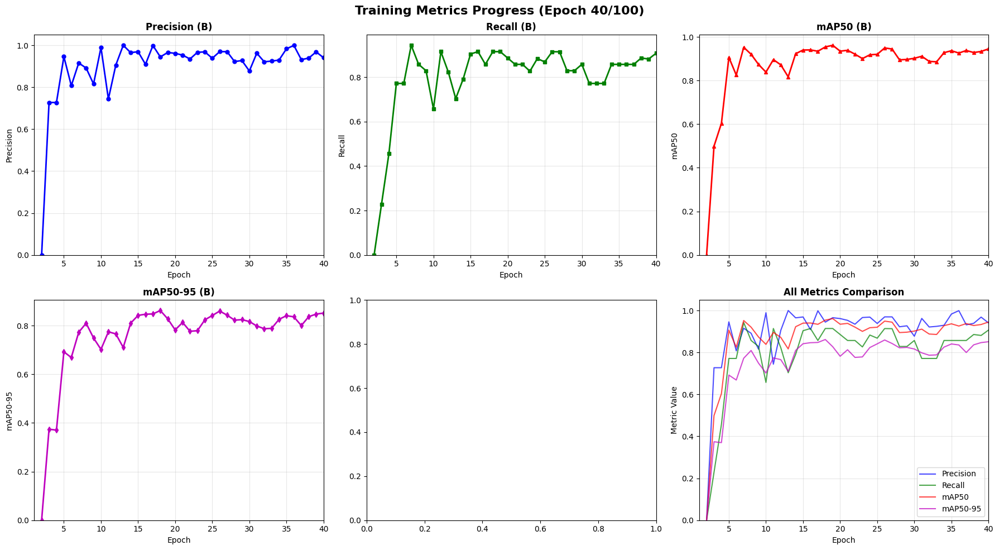



CURRENT STATUS - 14:55:55
  >>>  EPOCH: 40/100  <<<
  Status: Validation completed


CURRENT STATUS - 14:55:56
  >>>  EPOCH: 40/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     40/100      4.53G     0.5954     0.4768      1.086         22        640: 100% ━━━━━━━━━━━━ 14/14 2.2s/it 31.1s2.1s

CURRENT STATUS - 14:56:27
  >>>  EPOCH: 40/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.1s/it 2.3s5.0s
                   all         28         35      0.917      0.943      0.962      0.842

EPOCH 41/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.9412
  metrics/recall(B): 0.9143
  metrics/mAP50(B): 0.9475
  metrics/mAP50-95(B): 0.8614
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metric

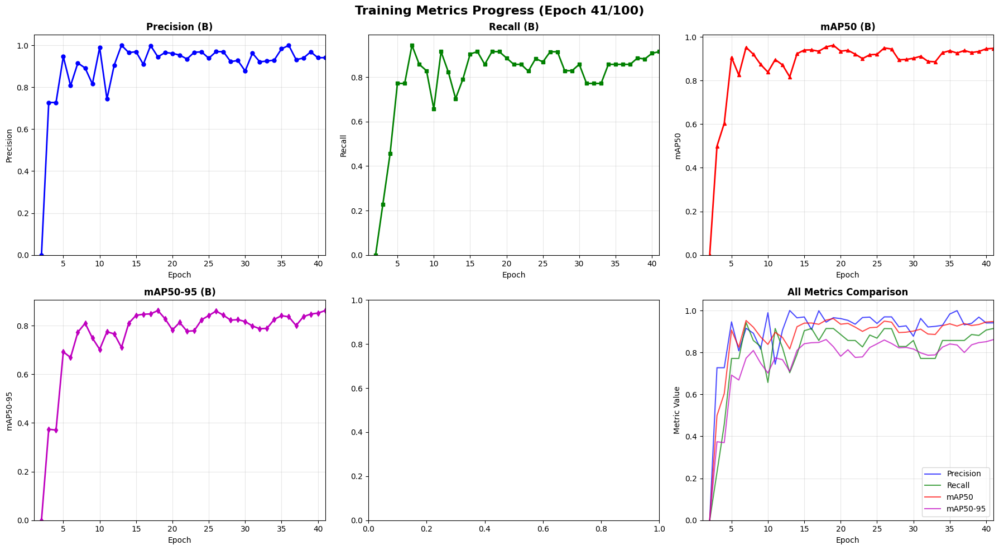



CURRENT STATUS - 14:56:31
  >>>  EPOCH: 41/100  <<<
  Status: Validation completed


CURRENT STATUS - 14:56:32
  >>>  EPOCH: 41/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     41/100      4.53G     0.4808     0.4041      1.006         10        640: 100% ━━━━━━━━━━━━ 14/14 2.1s/it 29.4s2.3s

CURRENT STATUS - 14:57:01
  >>>  EPOCH: 41/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.1s/it 2.3s5.1s
                   all         28         35      0.938      0.914       0.96      0.837

EPOCH 42/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.9167
  metrics/recall(B): 0.9429
  metrics/mAP50(B): 0.9620
  metrics/mAP50-95(B): 0.8417
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metric

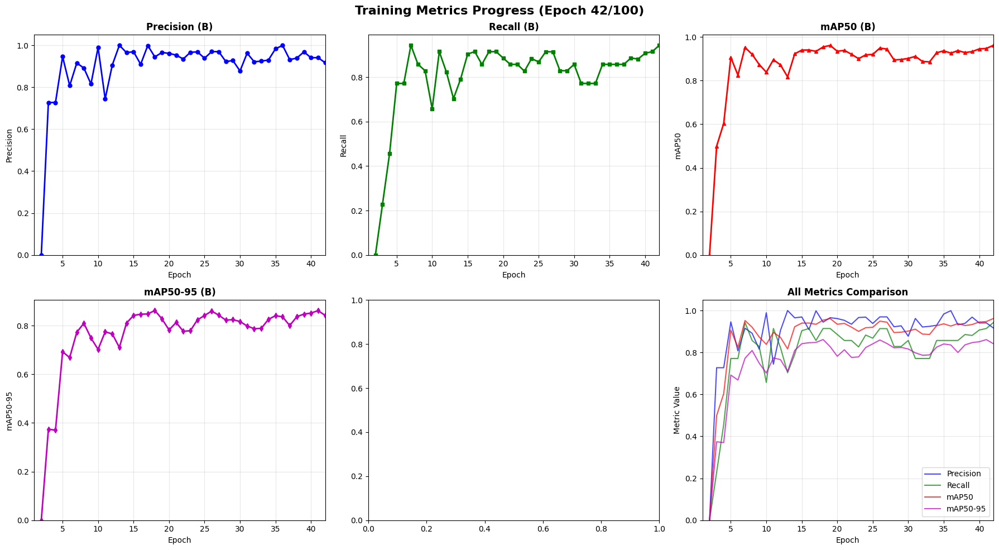



CURRENT STATUS - 14:57:04
  >>>  EPOCH: 42/100  <<<
  Status: Validation completed


CURRENT STATUS - 14:57:05
  >>>  EPOCH: 42/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     42/100      4.53G     0.5424     0.4486      1.052         16        640: 100% ━━━━━━━━━━━━ 14/14 2.1s/it 29.7s2.2s

CURRENT STATUS - 14:57:35
  >>>  EPOCH: 42/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.4s/it 2.8s6.0s
                   all         28         35       0.97      0.914       0.96      0.848

EPOCH 43/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.9381
  metrics/recall(B): 0.9143
  metrics/mAP50(B): 0.9598
  metrics/mAP50-95(B): 0.8373
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metric

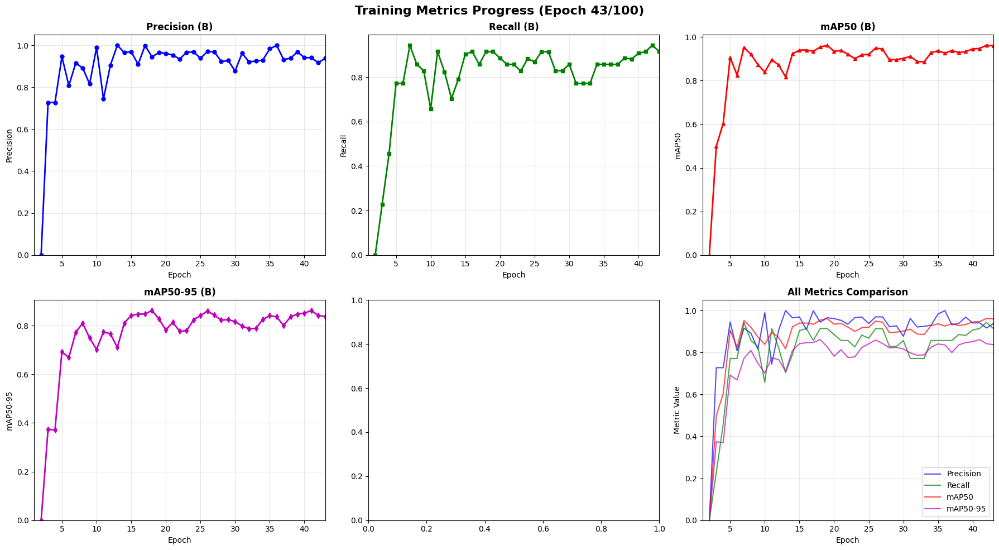



CURRENT STATUS - 14:57:39
  >>>  EPOCH: 43/100  <<<
  Status: Validation completed


CURRENT STATUS - 14:57:40
  >>>  EPOCH: 43/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     43/100      4.53G     0.5834     0.4583      1.065         18        640: 100% ━━━━━━━━━━━━ 14/14 2.5s/it 34.7s2.4s

CURRENT STATUS - 14:58:14
  >>>  EPOCH: 43/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.2s/it 2.5s5.5s
                   all         28         35      0.942      0.914      0.961      0.853

EPOCH 44/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.9697
  metrics/recall(B): 0.9140
  metrics/mAP50(B): 0.9599
  metrics/mAP50-95(B): 0.8485
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metric

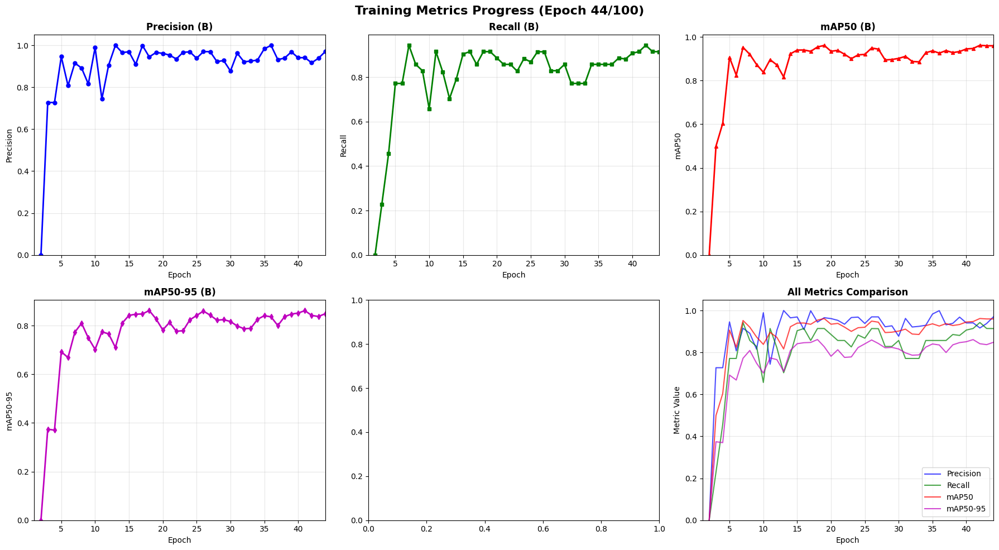



CURRENT STATUS - 14:58:18
  >>>  EPOCH: 44/100  <<<
  Status: Validation completed


CURRENT STATUS - 14:58:19
  >>>  EPOCH: 44/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     44/100      4.53G     0.5245     0.4299      1.042         16        640: 100% ━━━━━━━━━━━━ 14/14 9.7s/it 2:163.3ss

CURRENT STATUS - 15:00:35
  >>>  EPOCH: 44/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.8s/it 3.6s8.6s
                   all         28         35      0.916      0.935       0.96      0.864

EPOCH 45/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.9422
  metrics/recall(B): 0.9143
  metrics/mAP50(B): 0.9611
  metrics/mAP50-95(B): 0.8533
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metric

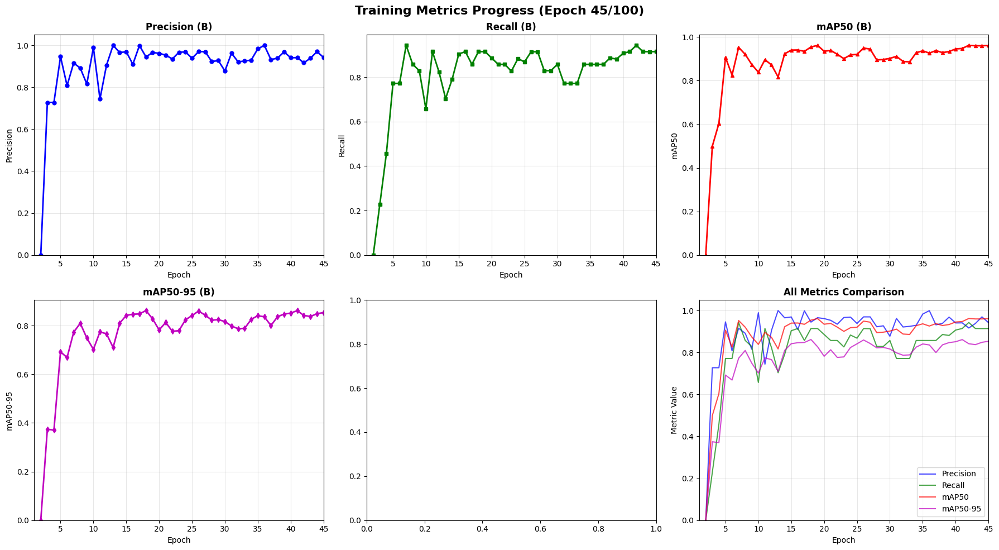



CURRENT STATUS - 15:00:40
  >>>  EPOCH: 45/100  <<<
  Status: Validation completed


CURRENT STATUS - 15:00:41
  >>>  EPOCH: 45/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     45/100      4.53G     0.5436     0.4593      1.034         21        640: 100% ━━━━━━━━━━━━ 14/14 79.7s/it 18:36.6ss

CURRENT STATUS - 15:19:17
  >>>  EPOCH: 45/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 2.1s/it 4.2s8.8s
                   all         28         35      0.934      0.857      0.929      0.854

EPOCH 46/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.9161
  metrics/recall(B): 0.9354
  metrics/mAP50(B): 0.9598
  metrics/mAP50-95(B): 0.8644
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metri

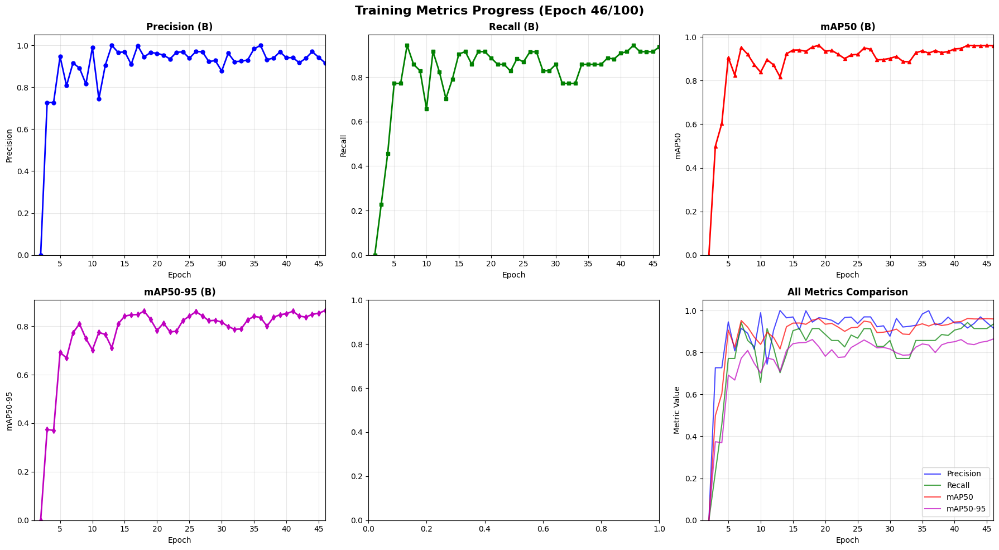



CURRENT STATUS - 15:19:22
  >>>  EPOCH: 46/100  <<<
  Status: Validation completed


CURRENT STATUS - 15:19:23
  >>>  EPOCH: 46/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     46/100      4.53G     0.5573     0.4422      1.063         13        640: 100% ━━━━━━━━━━━━ 14/14 29.4s/it 6:52.2ss

CURRENT STATUS - 15:26:15
  >>>  EPOCH: 46/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.2s/it 2.4s5.5s
                   all         28         35      0.939      0.881      0.931       0.86

EPOCH 47/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.9336
  metrics/recall(B): 0.8571
  metrics/mAP50(B): 0.9285
  metrics/mAP50-95(B): 0.8537
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metric

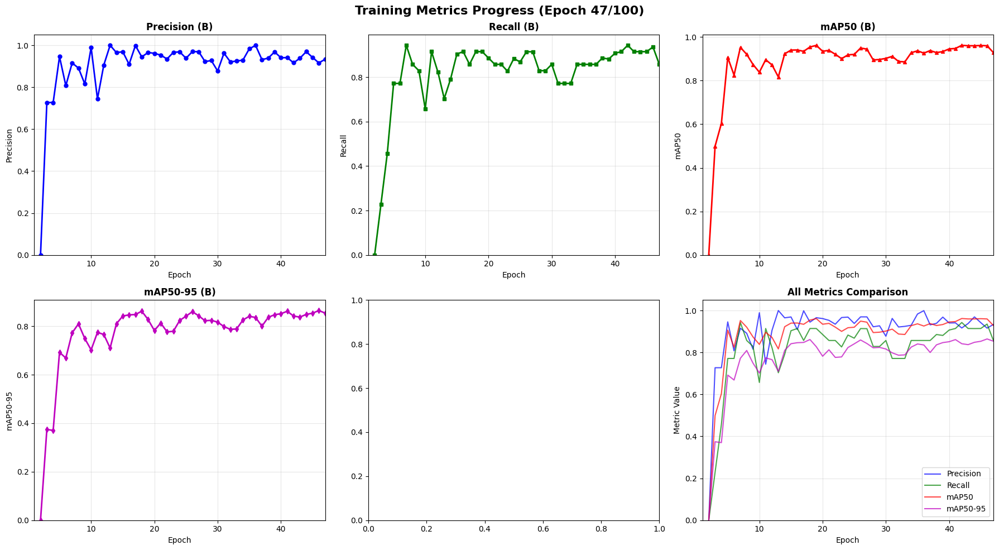



CURRENT STATUS - 15:26:19
  >>>  EPOCH: 47/100  <<<
  Status: Validation completed


CURRENT STATUS - 15:26:20
  >>>  EPOCH: 47/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     47/100      4.53G     0.5023     0.4143      1.012         19        640: 100% ━━━━━━━━━━━━ 14/14 2.0s/it 28.1s1.9s

CURRENT STATUS - 15:26:48
  >>>  EPOCH: 47/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.2s/it 2.4s5.1s
                   all         28         35      0.934      0.857      0.925      0.847

EPOCH 48/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.9391
  metrics/recall(B): 0.8809
  metrics/mAP50(B): 0.9308
  metrics/mAP50-95(B): 0.8601
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metric

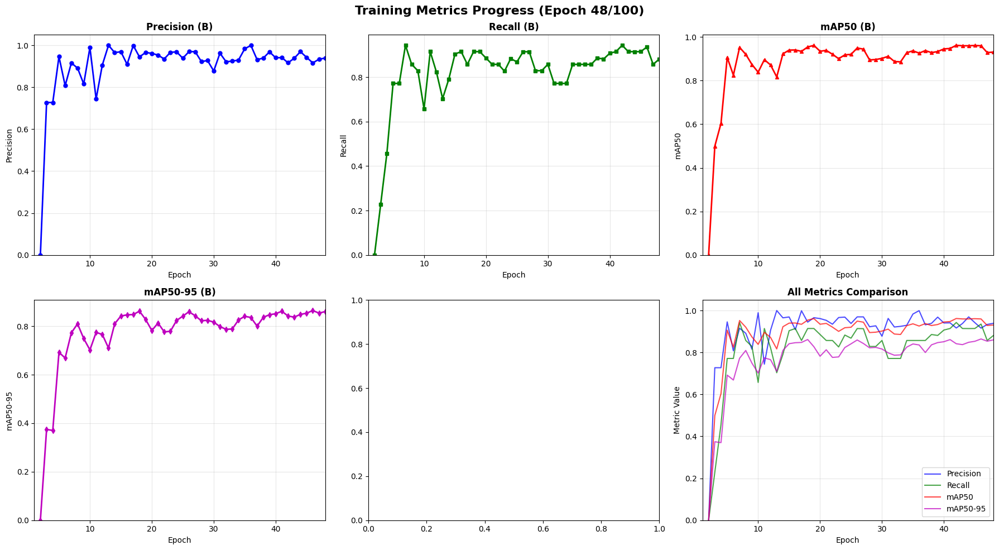



CURRENT STATUS - 15:26:52
  >>>  EPOCH: 48/100  <<<
  Status: Validation completed


CURRENT STATUS - 15:26:53
  >>>  EPOCH: 48/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     48/100      4.53G     0.5363     0.4317      1.051         15        640: 100% ━━━━━━━━━━━━ 14/14 1.8s/it 25.5s1.8s

CURRENT STATUS - 15:27:18
  >>>  EPOCH: 48/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.4s/it 2.8s6.5s
                   all         28         35      0.876      0.886      0.925      0.844

EPOCH 49/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.9341
  metrics/recall(B): 0.8571
  metrics/mAP50(B): 0.9253
  metrics/mAP50-95(B): 0.8468
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metric

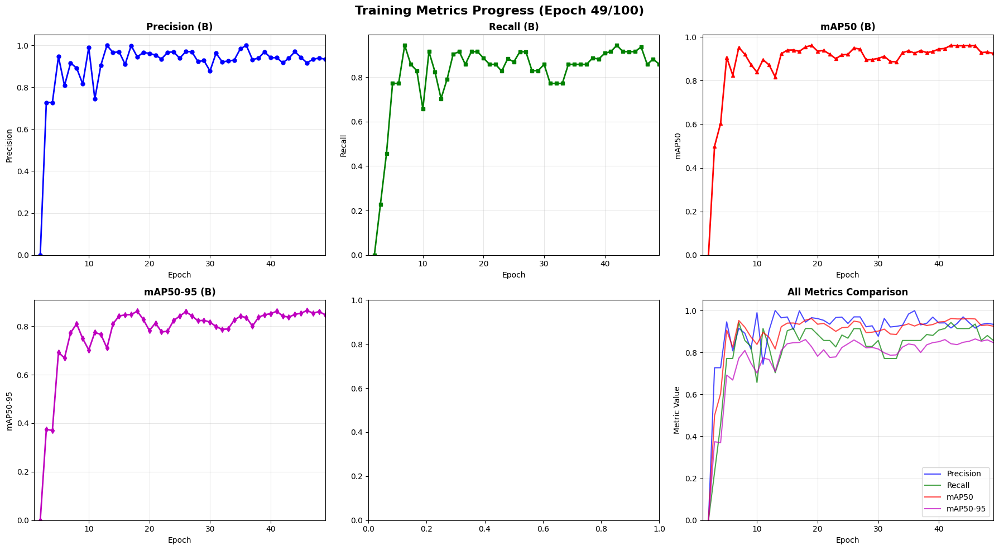



CURRENT STATUS - 15:27:22
  >>>  EPOCH: 49/100  <<<
  Status: Validation completed


CURRENT STATUS - 15:27:23
  >>>  EPOCH: 49/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     49/100      4.53G     0.5348     0.4295      1.012          9        640: 100% ━━━━━━━━━━━━ 14/14 29.7s/it 6:56.6ss:54

CURRENT STATUS - 15:34:18
  >>>  EPOCH: 49/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.6s/it 3.2s6.8s
                   all         28         35      0.889      0.914      0.946      0.838

EPOCH 50/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.8757
  metrics/recall(B): 0.8857
  metrics/mAP50(B): 0.9253
  metrics/mAP50-95(B): 0.8441
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_met

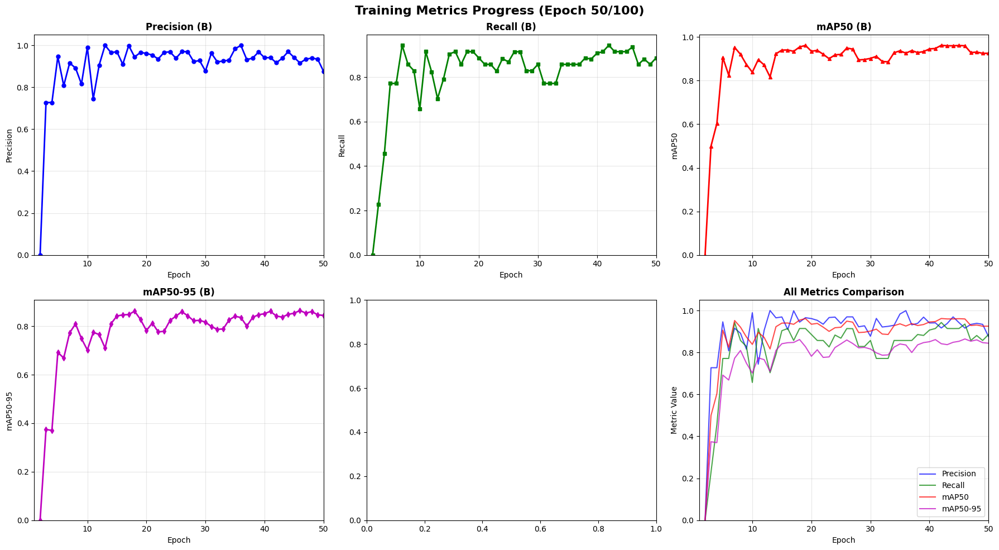



CURRENT STATUS - 15:34:23
  >>>  EPOCH: 50/100  <<<
  Status: Validation completed


CURRENT STATUS - 15:34:24
  >>>  EPOCH: 50/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     50/100      4.53G     0.5101     0.4674      1.043         13        640: 100% ━━━━━━━━━━━━ 14/14 35.5s/it 8:16.1ss

CURRENT STATUS - 15:42:40
  >>>  EPOCH: 50/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.8s/it 3.7s8.6s
                   all         28         35      0.994      0.857      0.947      0.829

EPOCH 51/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.8889
  metrics/recall(B): 0.9143
  metrics/mAP50(B): 0.9462
  metrics/mAP50-95(B): 0.8375
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metric

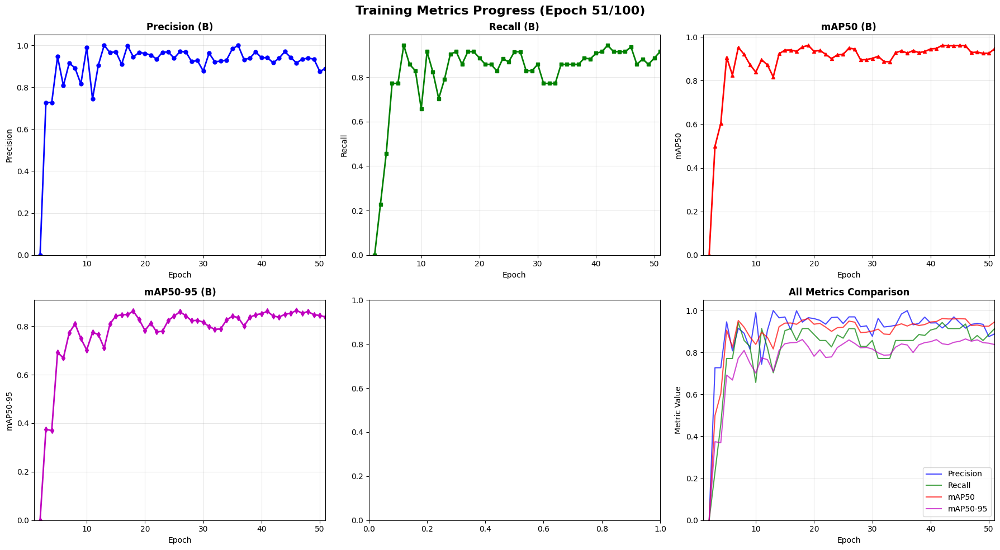



CURRENT STATUS - 15:42:45
  >>>  EPOCH: 51/100  <<<
  Status: Validation completed


CURRENT STATUS - 15:42:46
  >>>  EPOCH: 51/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     51/100      4.53G     0.5511     0.4199      1.036         28        640: 100% ━━━━━━━━━━━━ 14/14 3.4s/it 47.5s2.3ss

CURRENT STATUS - 15:43:33
  >>>  EPOCH: 51/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.3s/it 2.6s5.1s
                   all         28         35          1      0.884      0.951      0.827

EPOCH 52/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.9941
  metrics/recall(B): 0.8571
  metrics/mAP50(B): 0.9472
  metrics/mAP50-95(B): 0.8291
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metri

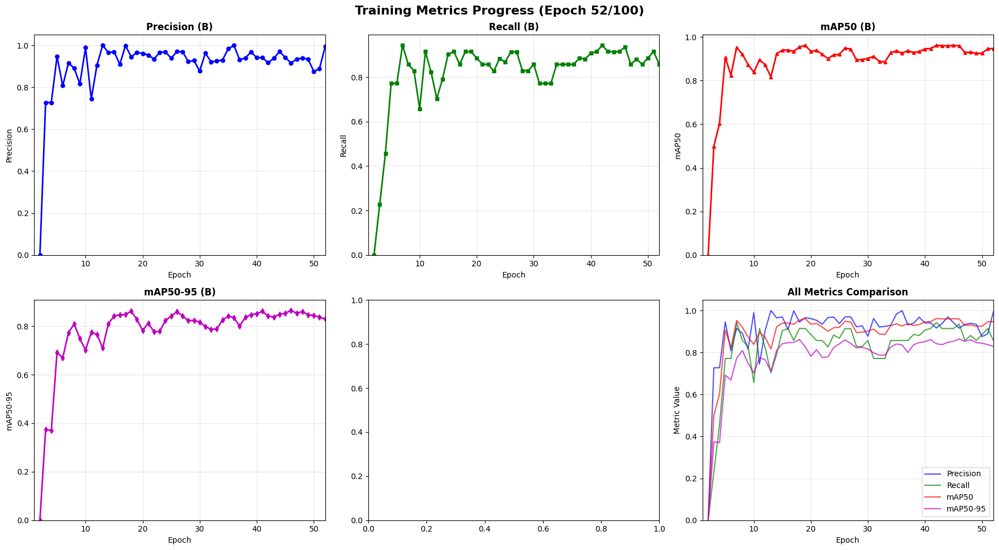



CURRENT STATUS - 15:43:37
  >>>  EPOCH: 52/100  <<<
  Status: Validation completed


CURRENT STATUS - 15:43:39
  >>>  EPOCH: 52/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     52/100      4.53G     0.5326     0.4378      1.067          8        640: 100% ━━━━━━━━━━━━ 14/14 8.3s/it 1:564.6ss

CURRENT STATUS - 15:45:34
  >>>  EPOCH: 52/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.9s/it 3.7s8.9s
                   all         28         35      0.965      0.914      0.946      0.816

EPOCH 53/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 1.0000
  metrics/recall(B): 0.8844
  metrics/mAP50(B): 0.9506
  metrics/mAP50-95(B): 0.8272
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metric

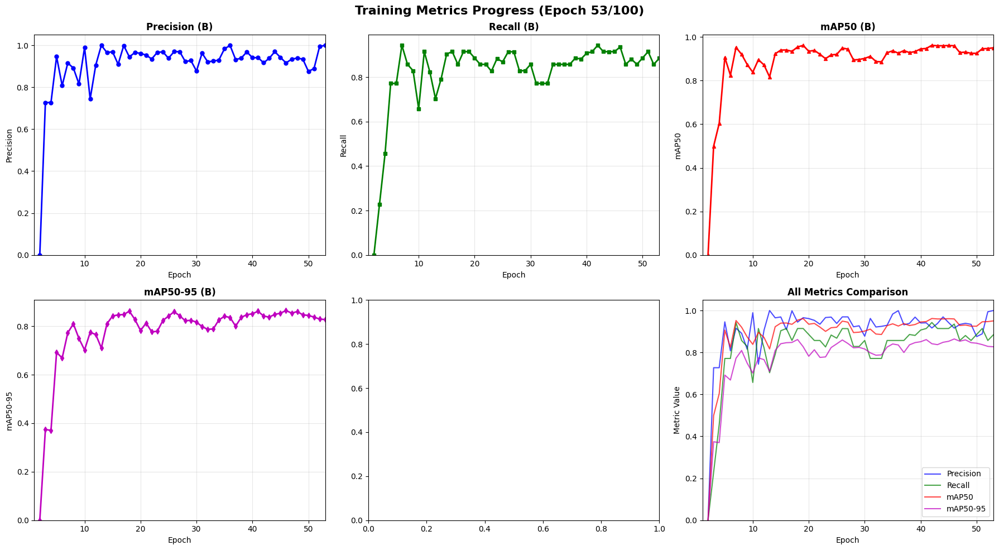



CURRENT STATUS - 15:45:39
  >>>  EPOCH: 53/100  <<<
  Status: Validation completed


CURRENT STATUS - 15:45:41
  >>>  EPOCH: 53/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     53/100      4.53G     0.5399     0.3896      1.017         10        640: 100% ━━━━━━━━━━━━ 14/14 30.7s/it 7:10.0ss

CURRENT STATUS - 15:52:51
  >>>  EPOCH: 53/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 2.0s/it 4.0s9.1s
                   all         28         35      0.985      0.829      0.943      0.837

EPOCH 54/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.9651
  metrics/recall(B): 0.9143
  metrics/mAP50(B): 0.9460
  metrics/mAP50-95(B): 0.8160
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metric

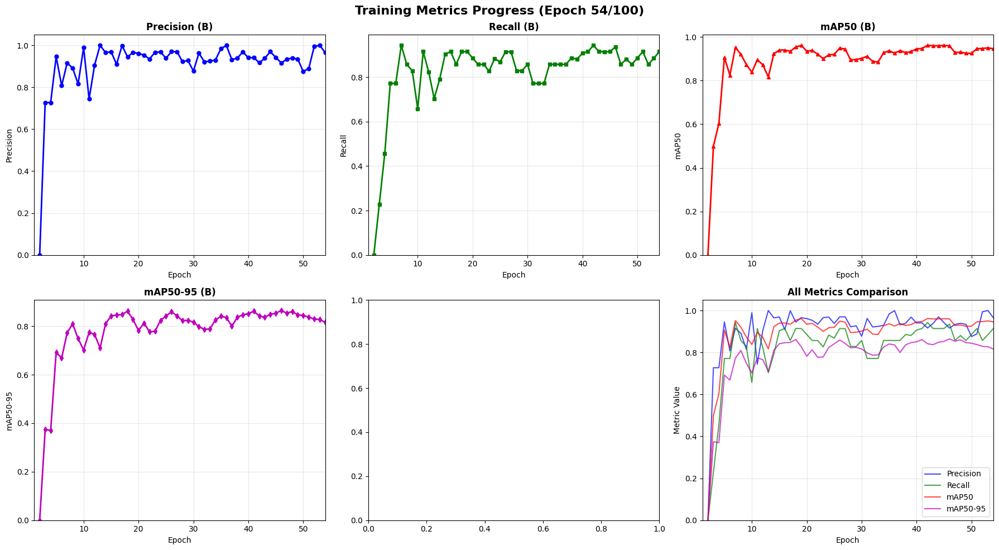



CURRENT STATUS - 15:52:57
  >>>  EPOCH: 54/100  <<<
  Status: Validation completed


CURRENT STATUS - 15:52:58
  >>>  EPOCH: 54/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     54/100      4.53G     0.5183     0.3701      1.038          9        640: 100% ━━━━━━━━━━━━ 14/14 41.9s/it 9:46.1ss

CURRENT STATUS - 16:02:44
  >>>  EPOCH: 54/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 2.7s/it 5.4s<12.0s
                   all         28         35          1      0.853      0.946       0.86

EPOCH 55/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.9855
  metrics/recall(B): 0.8286
  metrics/mAP50(B): 0.9427
  metrics/mAP50-95(B): 0.8369
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metr

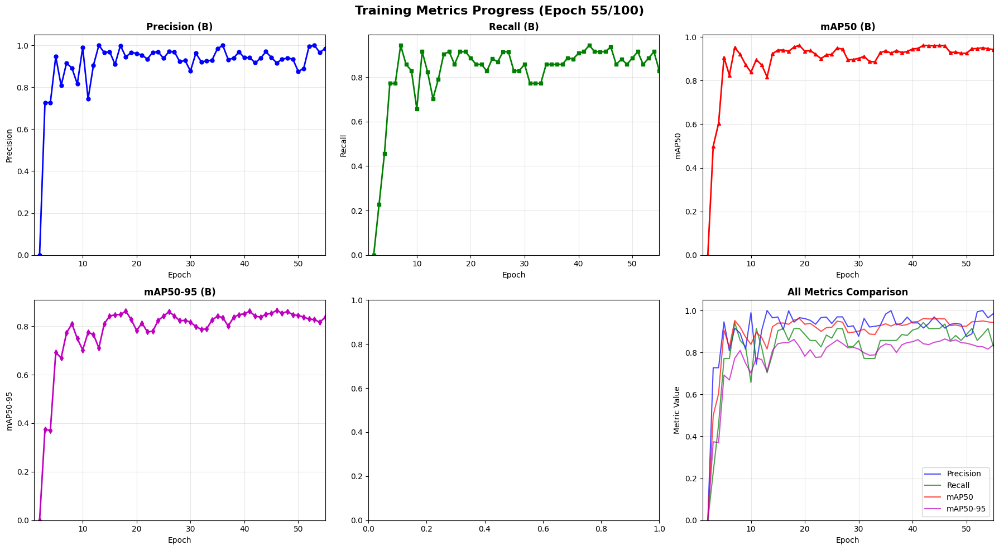



CURRENT STATUS - 16:02:52
  >>>  EPOCH: 55/100  <<<
  Status: Validation completed


CURRENT STATUS - 16:02:53
  >>>  EPOCH: 55/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     55/100      4.53G     0.5142     0.4169      1.033         15        640: 100% ━━━━━━━━━━━━ 14/14 2.6s/it 36.6s1.8ss

CURRENT STATUS - 16:03:29
  >>>  EPOCH: 55/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.5s/it 3.1s7.2s
                   all         28         35      0.985      0.857      0.944       0.85

EPOCH 56/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 1.0000
  metrics/recall(B): 0.8529
  metrics/mAP50(B): 0.9457
  metrics/mAP50-95(B): 0.8601
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metri

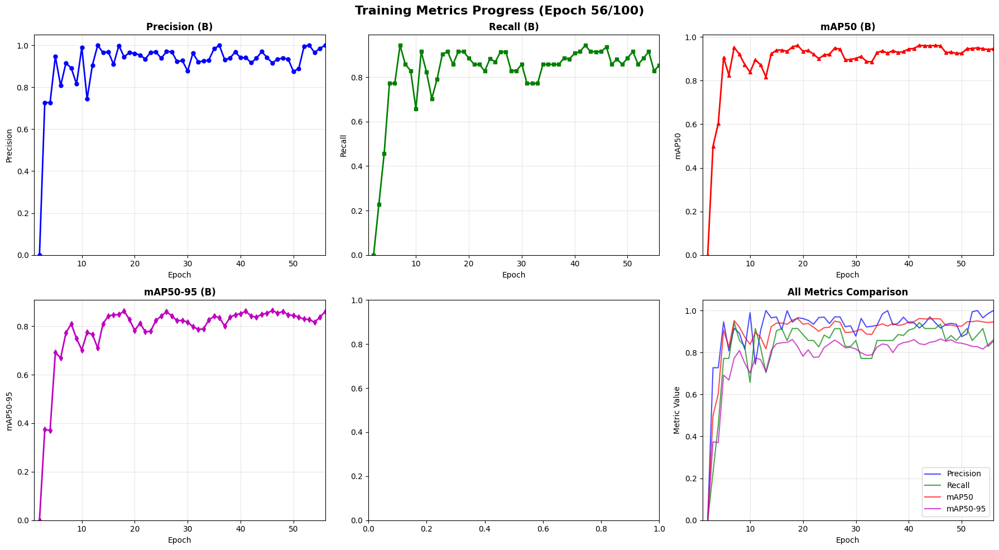



CURRENT STATUS - 16:03:34
  >>>  EPOCH: 56/100  <<<
  Status: Validation completed


CURRENT STATUS - 16:03:35
  >>>  EPOCH: 56/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     56/100      4.53G      0.484     0.3931      1.011         13        640: 100% ━━━━━━━━━━━━ 14/14 4.0s/it 55.4s3.9ss

CURRENT STATUS - 16:04:30
  >>>  EPOCH: 56/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.7s/it 3.4s7.9s
                   all         28         35      0.993      0.857      0.945      0.854

EPOCH 57/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.9849
  metrics/recall(B): 0.8571
  metrics/mAP50(B): 0.9437
  metrics/mAP50-95(B): 0.8505
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metri

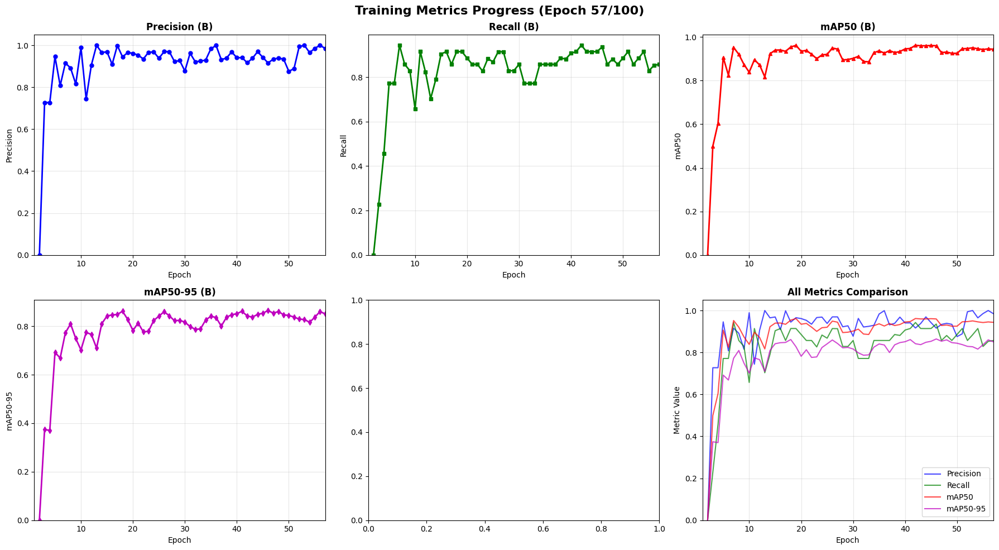



CURRENT STATUS - 16:04:35
  >>>  EPOCH: 57/100  <<<
  Status: Validation completed


CURRENT STATUS - 16:04:37
  >>>  EPOCH: 57/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     57/100      4.53G     0.4492     0.3727      0.992         21        640: 100% ━━━━━━━━━━━━ 14/14 3.1s/it 43.3s3.2ss

CURRENT STATUS - 16:05:20
  >>>  EPOCH: 57/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.4s/it 2.8s6.3s
                   all         28         35      0.969      0.883      0.945      0.867

EPOCH 58/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.9925
  metrics/recall(B): 0.8571
  metrics/mAP50(B): 0.9446
  metrics/mAP50-95(B): 0.8539
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metri

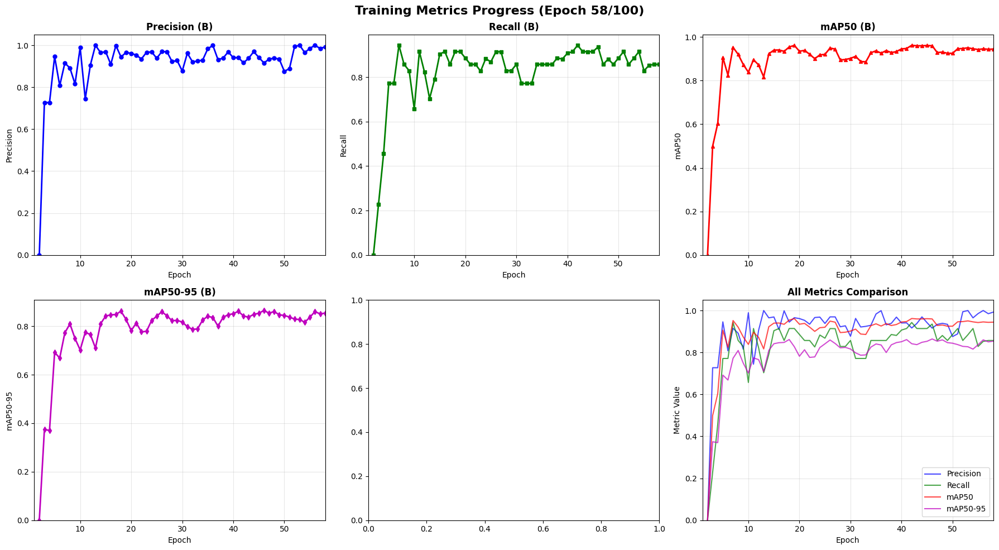



CURRENT STATUS - 16:05:24
  >>>  EPOCH: 58/100  <<<
  Status: Validation completed


CURRENT STATUS - 16:05:25
  >>>  EPOCH: 58/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     58/100      4.53G     0.4713     0.3882     0.9915         13        640: 100% ━━━━━━━━━━━━ 14/14 2.3s/it 32.6s2.0s

CURRENT STATUS - 16:05:58
  >>>  EPOCH: 58/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.2s/it 2.3s5.0s
                   all         28         35          1      0.855      0.931      0.866

EPOCH 59/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.9687
  metrics/recall(B): 0.8832
  metrics/mAP50(B): 0.9454
  metrics/mAP50-95(B): 0.8666
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metric

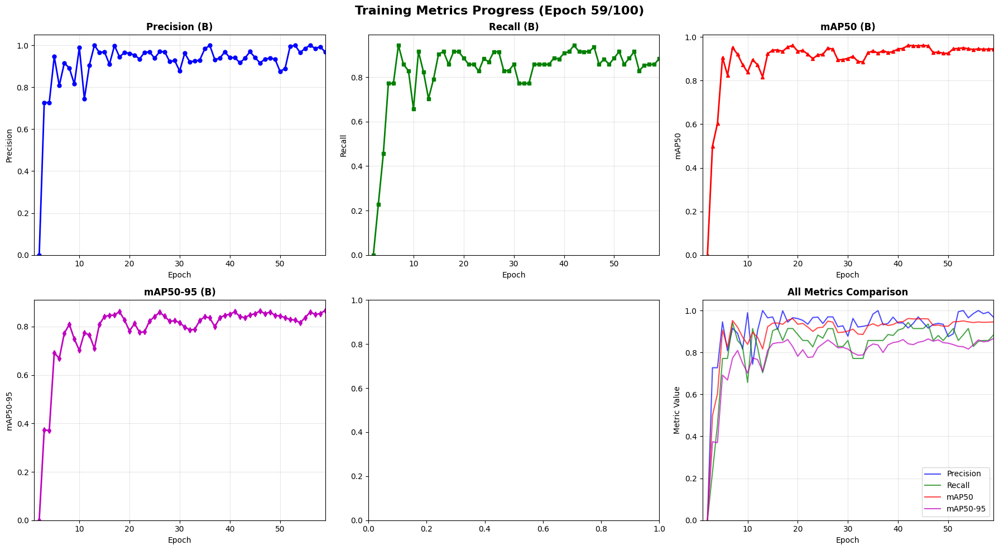



CURRENT STATUS - 16:06:01
  >>>  EPOCH: 59/100  <<<
  Status: Validation completed


CURRENT STATUS - 16:06:02
  >>>  EPOCH: 59/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     59/100      4.53G     0.4697     0.3702      1.001         22        640: 100% ━━━━━━━━━━━━ 14/14 2.1s/it 29.1s2.1s

CURRENT STATUS - 16:06:31
  >>>  EPOCH: 59/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.1s/it 2.2s5.0s
                   all         28         35          1      0.854      0.944      0.884

EPOCH 60/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 1.0000
  metrics/recall(B): 0.8552
  metrics/mAP50(B): 0.9307
  metrics/mAP50-95(B): 0.8655
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metric

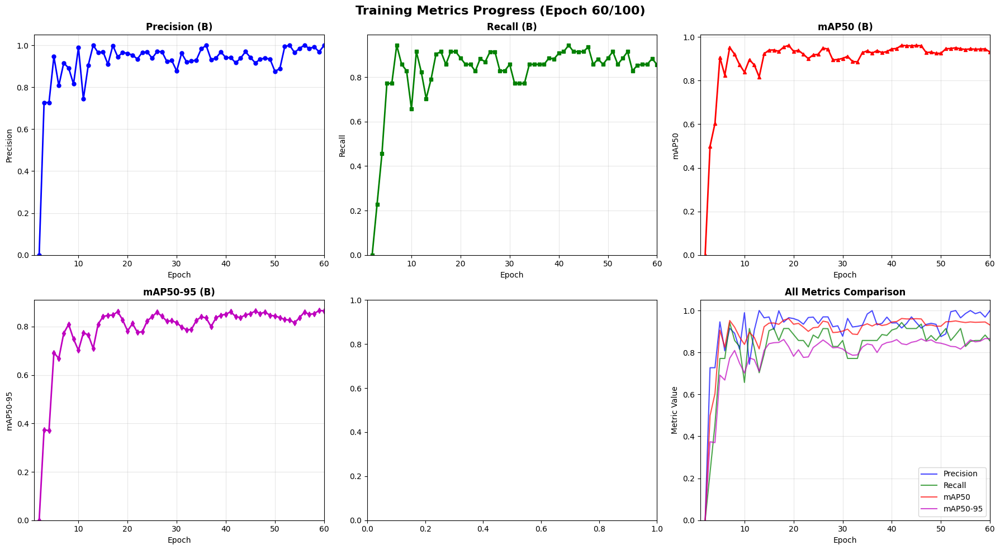



CURRENT STATUS - 16:06:35
  >>>  EPOCH: 60/100  <<<
  Status: Validation completed


CURRENT STATUS - 16:06:35
  >>>  EPOCH: 60/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     60/100      4.53G     0.4399     0.3486     0.9724         11        640: 100% ━━━━━━━━━━━━ 14/14 5.8s/it 1:213.0ss

CURRENT STATUS - 16:07:57
  >>>  EPOCH: 60/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.5s/it 2.9s6.5s
                   all         28         35      0.995      0.829      0.931      0.867

EPOCH 61/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 1.0000
  metrics/recall(B): 0.8544
  metrics/mAP50(B): 0.9438
  metrics/mAP50-95(B): 0.8836
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metric

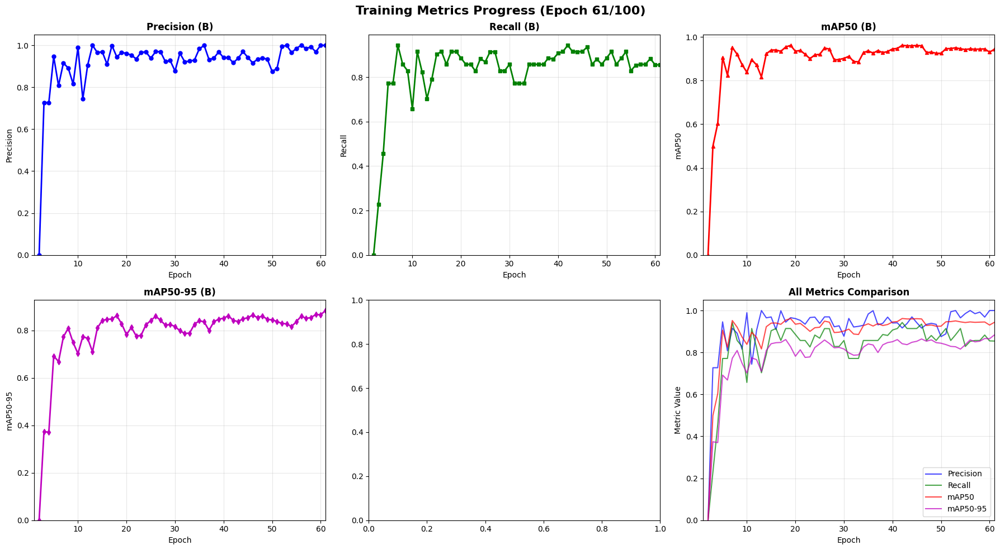



CURRENT STATUS - 16:08:01
  >>>  EPOCH: 61/100  <<<
  Status: Validation completed


CURRENT STATUS - 16:08:02
  >>>  EPOCH: 61/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     61/100      4.54G     0.4548     0.3649     0.9886         19        640: 100% ━━━━━━━━━━━━ 14/14 36.8s/it 8:36.6ss

CURRENT STATUS - 16:16:38
  >>>  EPOCH: 61/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.6s/it 3.1s6.3s
                   all         28         35      0.993      0.829      0.939      0.866

EPOCH 62/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.9947
  metrics/recall(B): 0.8286
  metrics/mAP50(B): 0.9309
  metrics/mAP50-95(B): 0.8670
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metric

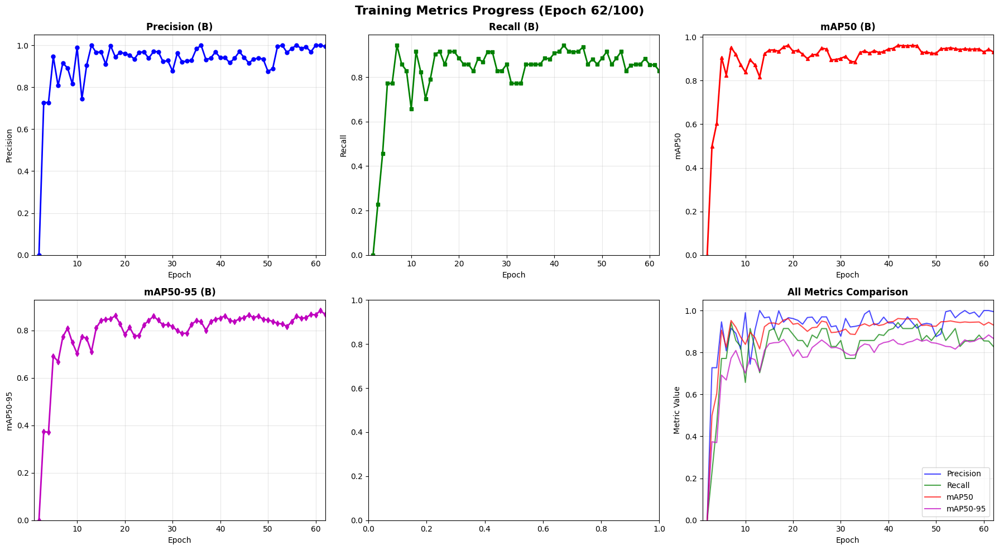



CURRENT STATUS - 16:16:43
  >>>  EPOCH: 62/100  <<<
  Status: Validation completed


CURRENT STATUS - 16:16:44
  >>>  EPOCH: 62/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     62/100      4.53G     0.4211     0.3316     0.9545         20        640: 100% ━━━━━━━━━━━━ 14/14 52.7s/it 12:17.0ss

CURRENT STATUS - 16:29:01
  >>>  EPOCH: 62/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 3.3s/it 6.5s<13.2s
                   all         28         35      0.988      0.829      0.934      0.862

EPOCH 63/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.9934
  metrics/recall(B): 0.8286
  metrics/mAP50(B): 0.9392
  metrics/mAP50-95(B): 0.8657
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_met

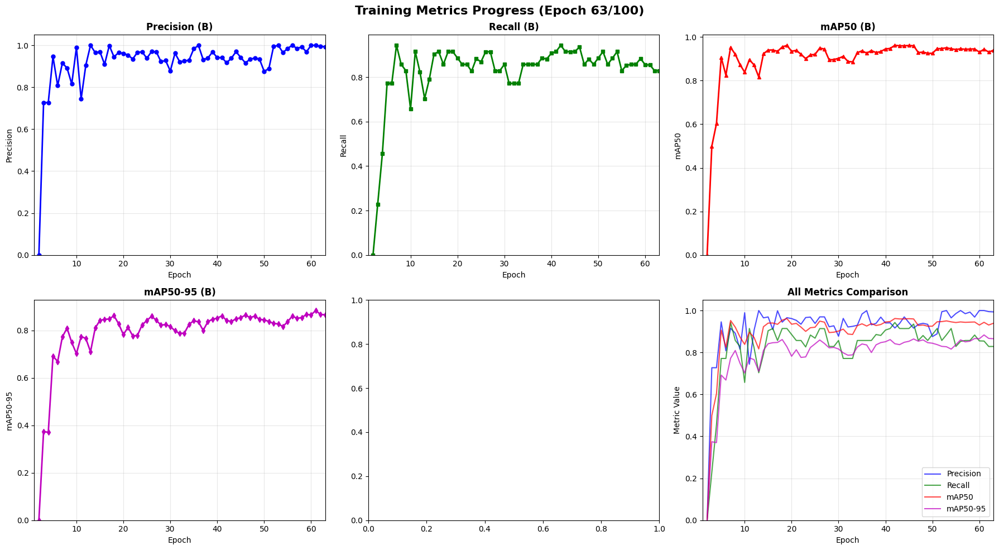



CURRENT STATUS - 16:29:10
  >>>  EPOCH: 63/100  <<<
  Status: Validation completed


CURRENT STATUS - 16:29:13
  >>>  EPOCH: 63/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     63/100      4.53G     0.4309     0.3485     0.9646         16        640: 100% ━━━━━━━━━━━━ 14/14 5.2s/it 1:123.3ss

CURRENT STATUS - 16:30:25
  >>>  EPOCH: 63/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 2.2s/it 4.3s<10.0s
                   all         28         35      0.992      0.829      0.935      0.871

EPOCH 64/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.9879
  metrics/recall(B): 0.8286
  metrics/mAP50(B): 0.9340
  metrics/mAP50-95(B): 0.8617
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metr

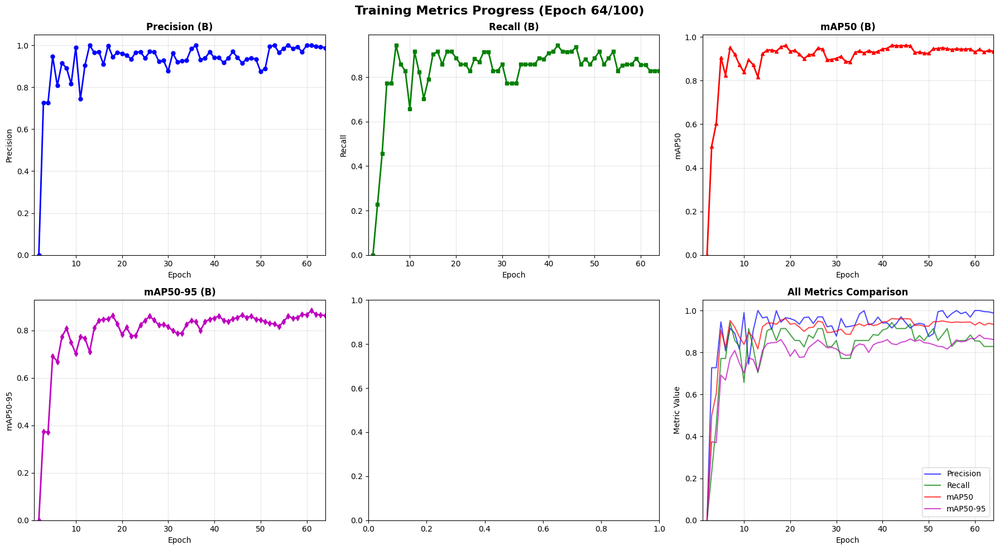



CURRENT STATUS - 16:30:31
  >>>  EPOCH: 64/100  <<<
  Status: Validation completed


CURRENT STATUS - 16:30:32
  >>>  EPOCH: 64/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     64/100      4.53G     0.4536     0.3456     0.9752         16        640: 100% ━━━━━━━━━━━━ 14/14 3.8s/it 52.5s3.0ss

CURRENT STATUS - 16:31:24
  >>>  EPOCH: 64/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.8s/it 3.6s7.1s
                   all         28         35      0.991      0.829      0.949      0.871

EPOCH 65/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.9919
  metrics/recall(B): 0.8286
  metrics/mAP50(B): 0.9352
  metrics/mAP50-95(B): 0.8712
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metri

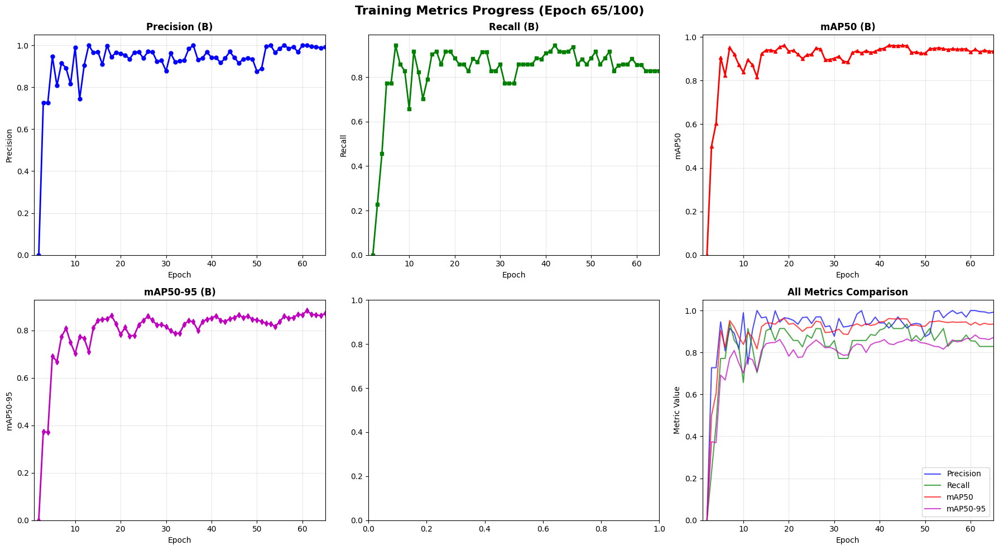



CURRENT STATUS - 16:31:29
  >>>  EPOCH: 65/100  <<<
  Status: Validation completed


CURRENT STATUS - 16:31:30
  >>>  EPOCH: 65/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     65/100      4.53G     0.4443       0.33     0.9986         18        640: 100% ━━━━━━━━━━━━ 14/14 68.1s/it 15:53.9ss

CURRENT STATUS - 16:47:23
  >>>  EPOCH: 65/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.8s/it 3.7s8.6s
                   all         28         35      0.914      0.909      0.955       0.87

EPOCH 66/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.9910
  metrics/recall(B): 0.8286
  metrics/mAP50(B): 0.9491
  metrics/mAP50-95(B): 0.8706
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metri

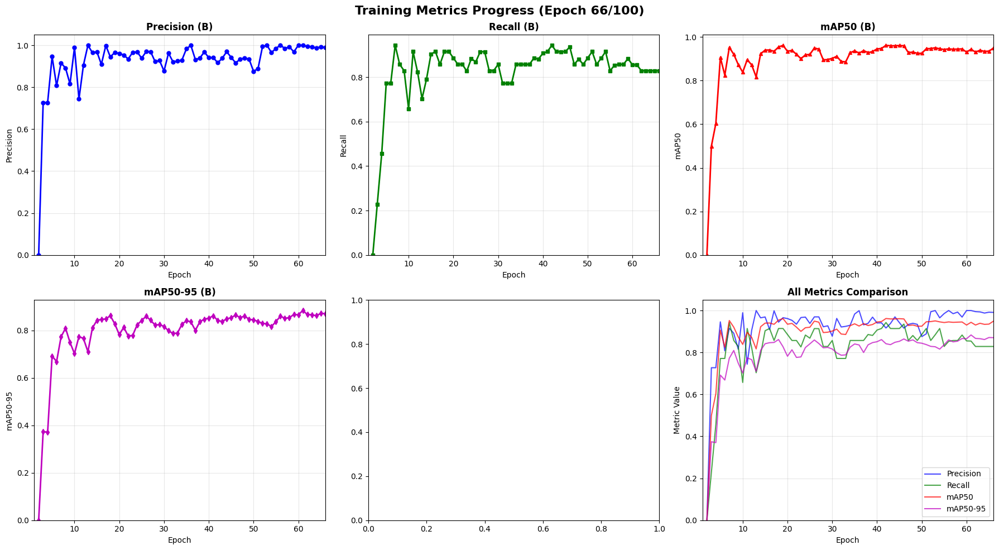



CURRENT STATUS - 16:47:28
  >>>  EPOCH: 66/100  <<<
  Status: Validation completed


CURRENT STATUS - 16:47:29
  >>>  EPOCH: 66/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     66/100      4.53G     0.4525     0.3405      0.976         10        640: 100% ━━━━━━━━━━━━ 14/14 3.9s/it 54.3s3.4ss

CURRENT STATUS - 16:48:24
  >>>  EPOCH: 66/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.6s/it 3.2s7.2s
                   all         28         35      0.941      0.914      0.959      0.865

EPOCH 67/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.9139
  metrics/recall(B): 0.9095
  metrics/mAP50(B): 0.9552
  metrics/mAP50-95(B): 0.8705
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metri

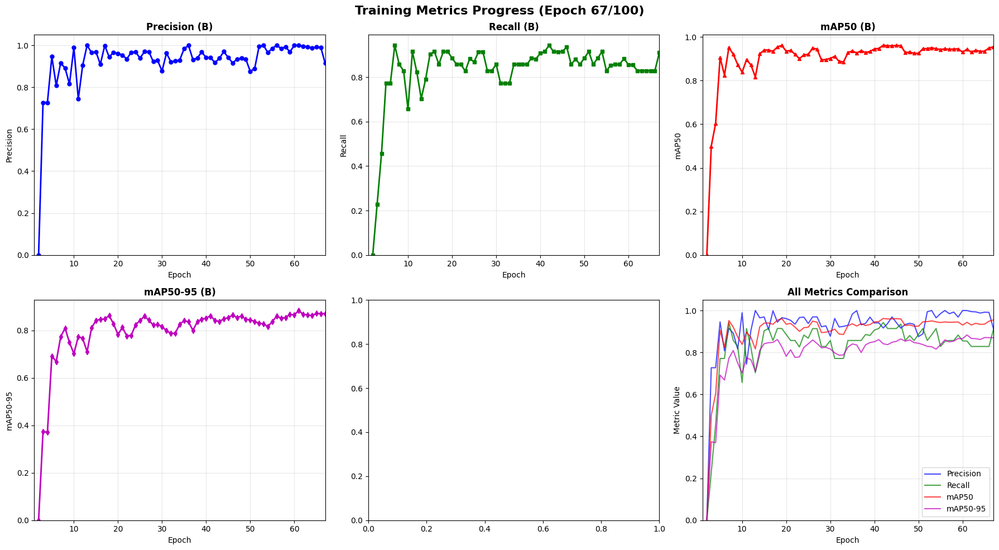



CURRENT STATUS - 16:48:28
  >>>  EPOCH: 67/100  <<<
  Status: Validation completed


CURRENT STATUS - 16:48:30
  >>>  EPOCH: 67/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     67/100      4.53G      0.439     0.3498     0.9665         21        640: 100% ━━━━━━━━━━━━ 14/14 3.1s/it 44.0s2.5ss

CURRENT STATUS - 16:49:14
  >>>  EPOCH: 67/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.6s/it 3.2s6.9s
                   all         28         35      0.939      0.914       0.96      0.864

EPOCH 68/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.9409
  metrics/recall(B): 0.9143
  metrics/mAP50(B): 0.9587
  metrics/mAP50-95(B): 0.8648
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metri

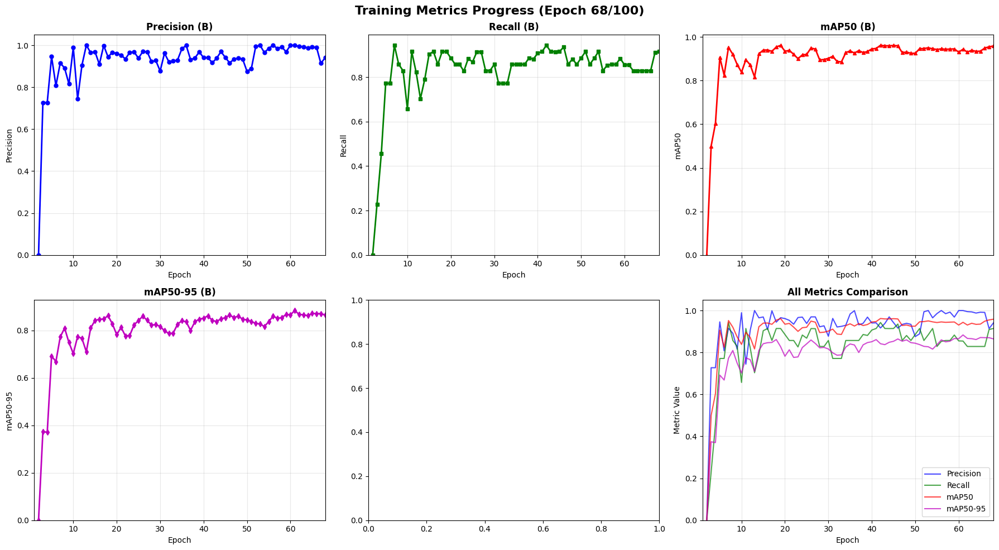



CURRENT STATUS - 16:49:18
  >>>  EPOCH: 68/100  <<<
  Status: Validation completed


CURRENT STATUS - 16:49:19
  >>>  EPOCH: 68/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     68/100      4.53G     0.4502     0.3412     0.9899         15        640: 100% ━━━━━━━━━━━━ 14/14 3.4s/it 47.0s3.6ss

CURRENT STATUS - 16:50:06
  >>>  EPOCH: 68/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.6s/it 3.2s6.3s
                   all         28         35      0.993      0.886      0.963      0.881

EPOCH 69/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.9393
  metrics/recall(B): 0.9143
  metrics/mAP50(B): 0.9604
  metrics/mAP50-95(B): 0.8645
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metri

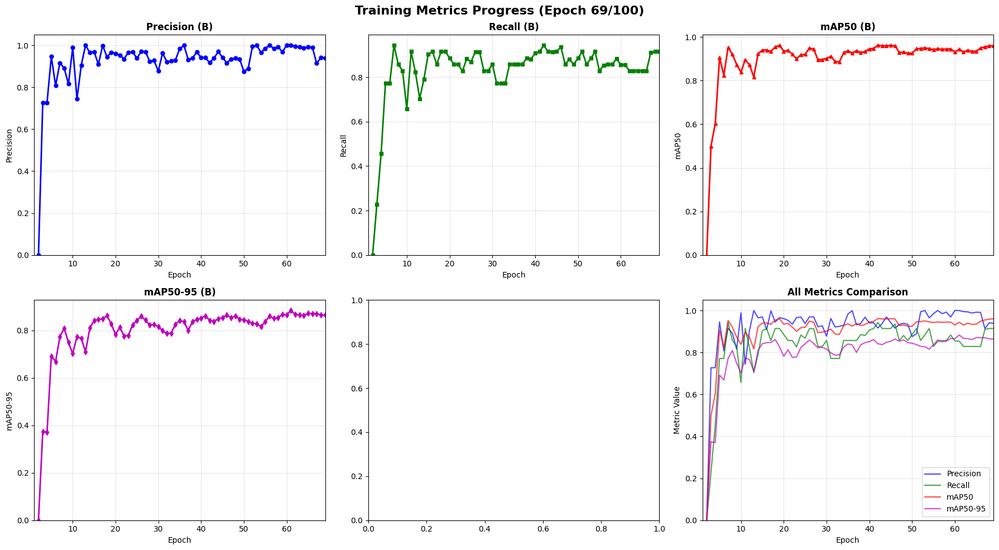



CURRENT STATUS - 16:50:11
  >>>  EPOCH: 69/100  <<<
  Status: Validation completed


CURRENT STATUS - 16:50:12
  >>>  EPOCH: 69/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     69/100      4.53G     0.4309     0.3113     0.9772         22        640: 100% ━━━━━━━━━━━━ 14/14 3.6s/it 51.0s3.7ss

CURRENT STATUS - 16:51:03
  >>>  EPOCH: 69/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 2.8s/it 5.6s6.2s
                   all         28         35      0.994      0.886      0.965      0.888

EPOCH 70/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.9931
  metrics/recall(B): 0.8857
  metrics/mAP50(B): 0.9628
  metrics/mAP50-95(B): 0.8805
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metri

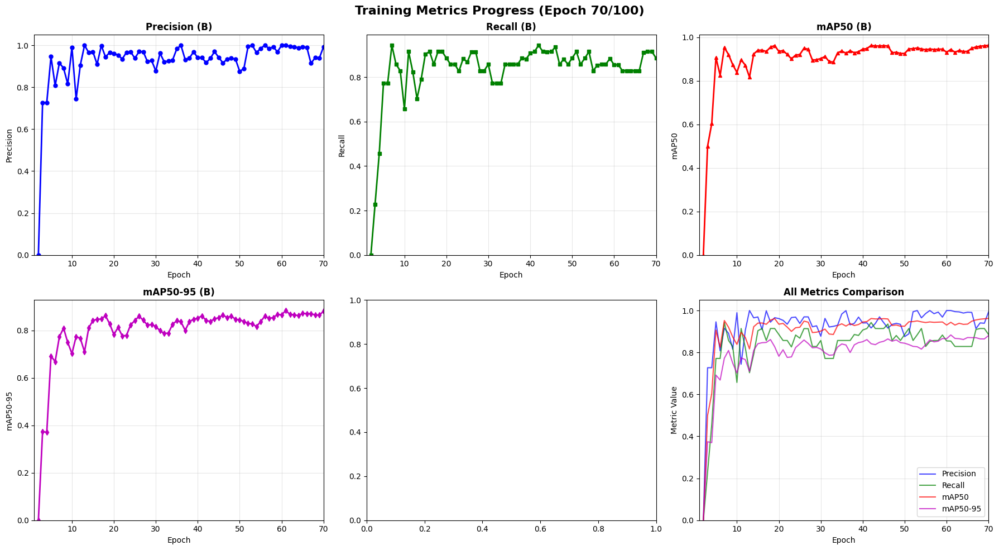



CURRENT STATUS - 16:51:10
  >>>  EPOCH: 70/100  <<<
  Status: Validation completed


CURRENT STATUS - 16:51:12
  >>>  EPOCH: 70/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     70/100      4.53G     0.4327      0.353      0.969         20        640: 100% ━━━━━━━━━━━━ 14/14 3.3s/it 45.6s3.2s

CURRENT STATUS - 16:51:58
  >>>  EPOCH: 70/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.8s/it 3.6s7.4s
                   all         28         35       0.97      0.936      0.967      0.883

EPOCH 71/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.9941
  metrics/recall(B): 0.8857
  metrics/mAP50(B): 0.9646
  metrics/mAP50-95(B): 0.8878
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metric

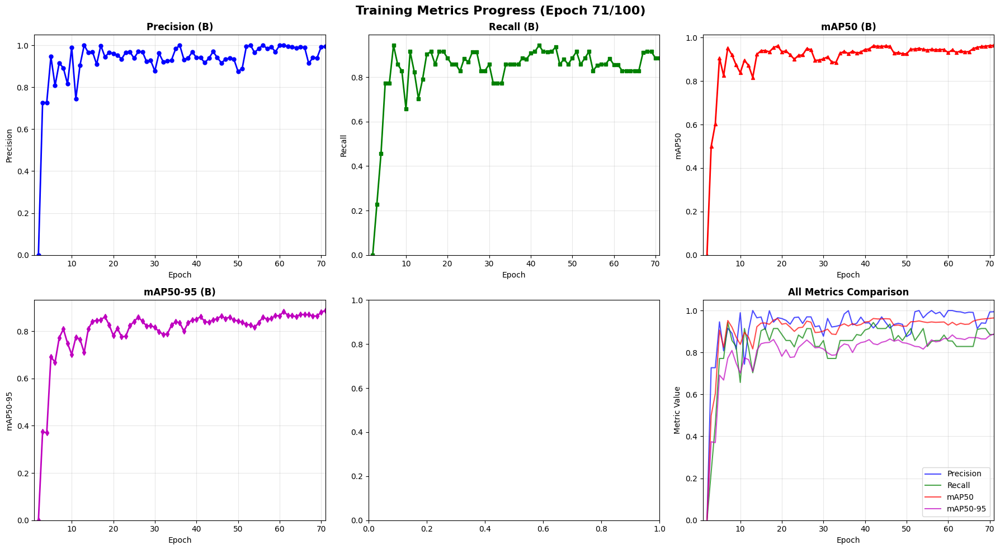



CURRENT STATUS - 16:52:03
  >>>  EPOCH: 71/100  <<<
  Status: Validation completed


CURRENT STATUS - 16:52:04
  >>>  EPOCH: 71/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     71/100      4.53G     0.4367     0.3583      0.971         13        640: 100% ━━━━━━━━━━━━ 14/14 4.0s/it 56.3s4.3ss

CURRENT STATUS - 16:53:00
  >>>  EPOCH: 71/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.6s/it 3.1s6.6s
                   all         28         35          1       0.94      0.968      0.879

EPOCH 72/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.9704
  metrics/recall(B): 0.9363
  metrics/mAP50(B): 0.9669
  metrics/mAP50-95(B): 0.8833
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metri

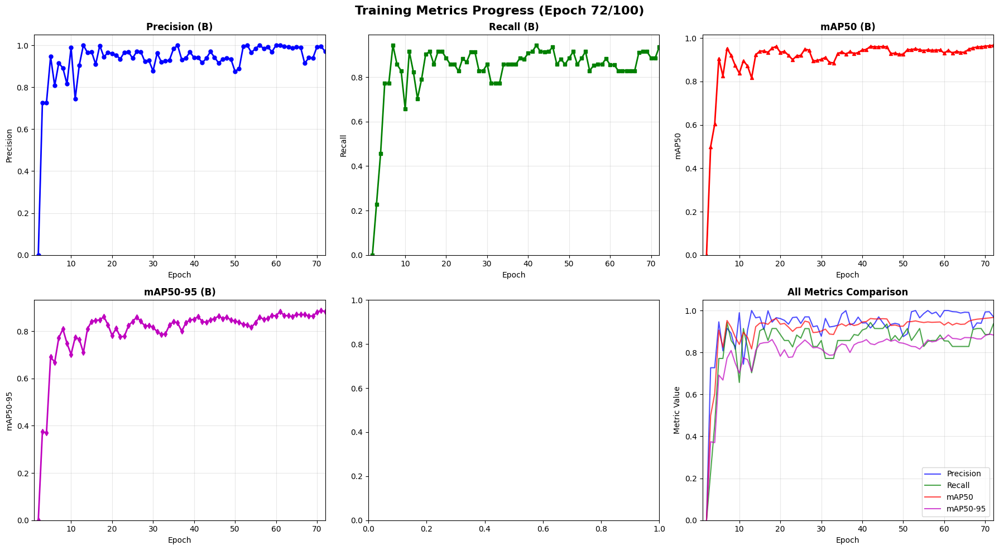



CURRENT STATUS - 16:53:05
  >>>  EPOCH: 72/100  <<<
  Status: Validation completed


CURRENT STATUS - 16:53:06
  >>>  EPOCH: 72/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     72/100      4.53G     0.4338     0.3389     0.9761         14        640: 100% ━━━━━━━━━━━━ 14/14 3.4s/it 48.0s3.2ss

CURRENT STATUS - 16:53:54
  >>>  EPOCH: 72/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.5s/it 3.0s6.5s
                   all         28         35          1      0.941      0.968      0.899

EPOCH 73/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 1.0000
  metrics/recall(B): 0.9403
  metrics/mAP50(B): 0.9684
  metrics/mAP50-95(B): 0.8787
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metri

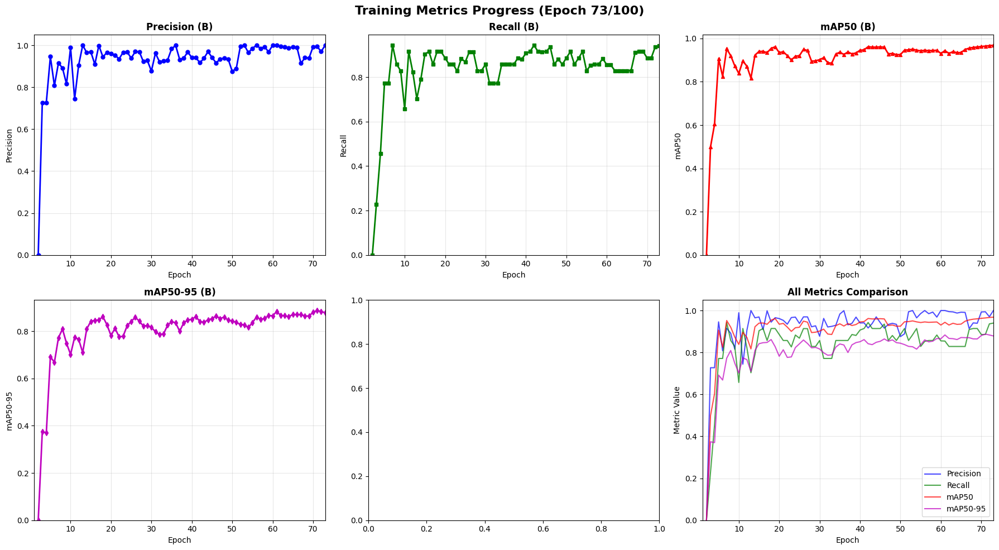



CURRENT STATUS - 16:53:58
  >>>  EPOCH: 73/100  <<<
  Status: Validation completed


CURRENT STATUS - 16:54:00
  >>>  EPOCH: 73/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     73/100      4.53G     0.4186     0.3318     0.9632         20        640: 100% ━━━━━━━━━━━━ 14/14 3.6s/it 50.9s3.4ss

CURRENT STATUS - 16:54:51
  >>>  EPOCH: 73/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.8s/it 3.7s8.5s
                   all         28         35      0.971      0.943      0.969      0.886

EPOCH 74/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 1.0000
  metrics/recall(B): 0.9411
  metrics/mAP50(B): 0.9684
  metrics/mAP50-95(B): 0.8989
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metri

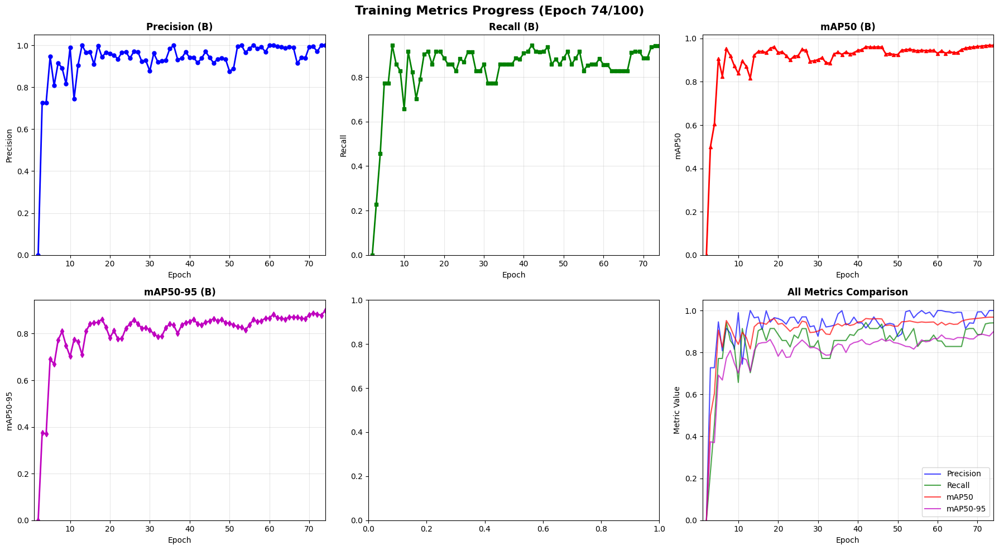



CURRENT STATUS - 16:54:56
  >>>  EPOCH: 74/100  <<<
  Status: Validation completed


CURRENT STATUS - 16:54:57
  >>>  EPOCH: 74/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     74/100      4.53G     0.4451     0.3291     0.9846         15        640: 100% ━━━━━━━━━━━━ 14/14 3.5s/it 48.9s3.1ss

CURRENT STATUS - 16:55:46
  >>>  EPOCH: 74/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.8s/it 3.6s8.1s
                   all         28         35      0.971      0.941      0.968      0.896

EPOCH 75/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.9705
  metrics/recall(B): 0.9429
  metrics/mAP50(B): 0.9689
  metrics/mAP50-95(B): 0.8855
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metri

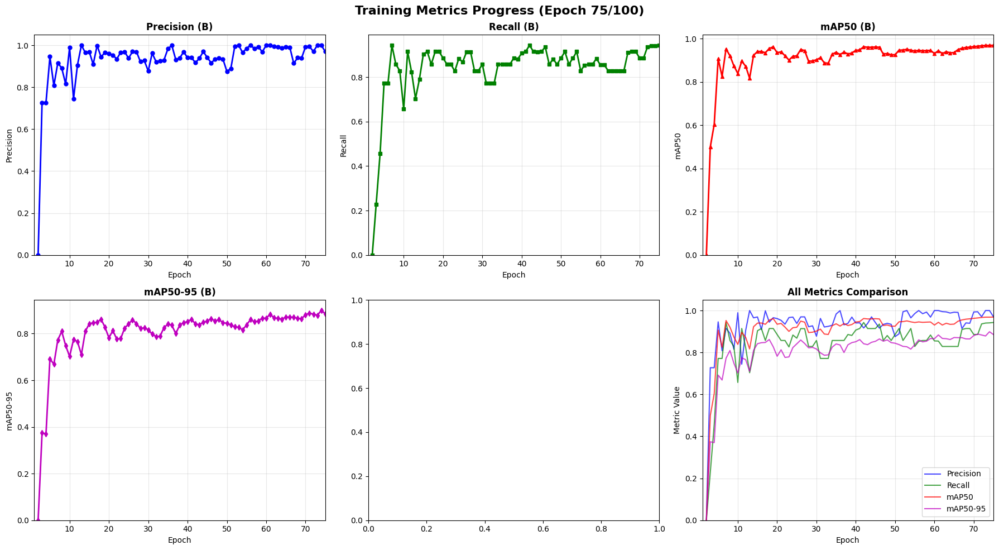



CURRENT STATUS - 16:55:51
  >>>  EPOCH: 75/100  <<<
  Status: Validation completed


CURRENT STATUS - 16:55:52
  >>>  EPOCH: 75/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     75/100      4.53G      0.417     0.3114      0.975         12        640: 100% ━━━━━━━━━━━━ 14/14 3.4s/it 48.0s3.5ss

CURRENT STATUS - 16:56:40
  >>>  EPOCH: 75/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.9s/it 3.7s6.9s
                   all         28         35      0.971      0.941      0.968      0.897

EPOCH 76/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.9705
  metrics/recall(B): 0.9406
  metrics/mAP50(B): 0.9682
  metrics/mAP50-95(B): 0.8958
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metri

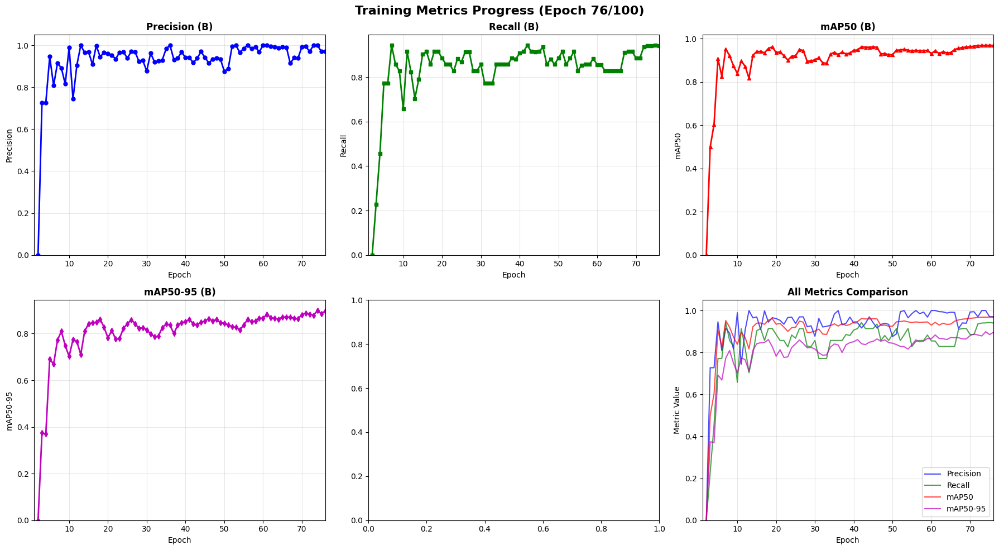



CURRENT STATUS - 16:56:45
  >>>  EPOCH: 76/100  <<<
  Status: Validation completed


CURRENT STATUS - 16:56:47
  >>>  EPOCH: 76/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     76/100      4.53G     0.3628     0.2872     0.9383         12        640: 100% ━━━━━━━━━━━━ 14/14 3.7s/it 51.5s3.1ss

CURRENT STATUS - 16:57:38
  >>>  EPOCH: 76/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.6s/it 3.3s6.7s
                   all         28         35      0.971      0.942      0.968      0.892

EPOCH 77/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.9705
  metrics/recall(B): 0.9414
  metrics/mAP50(B): 0.9682
  metrics/mAP50-95(B): 0.8972
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metri

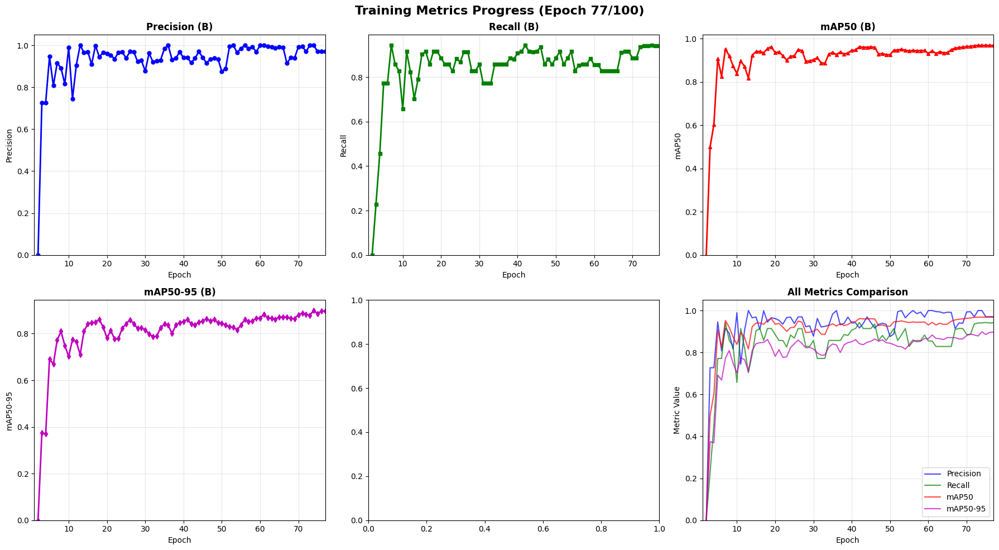



CURRENT STATUS - 16:57:43
  >>>  EPOCH: 77/100  <<<
  Status: Validation completed


CURRENT STATUS - 16:57:44
  >>>  EPOCH: 77/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     77/100      4.53G     0.3834     0.2974     0.9194         21        640: 100% ━━━━━━━━━━━━ 14/14 3.8s/it 53.1s4.1ss

CURRENT STATUS - 16:58:37
  >>>  EPOCH: 77/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 2.0s/it 4.0s8.8s
                   all         28         35          1      0.914      0.968      0.878

EPOCH 78/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.9706
  metrics/recall(B): 0.9420
  metrics/mAP50(B): 0.9682
  metrics/mAP50-95(B): 0.8922
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metri

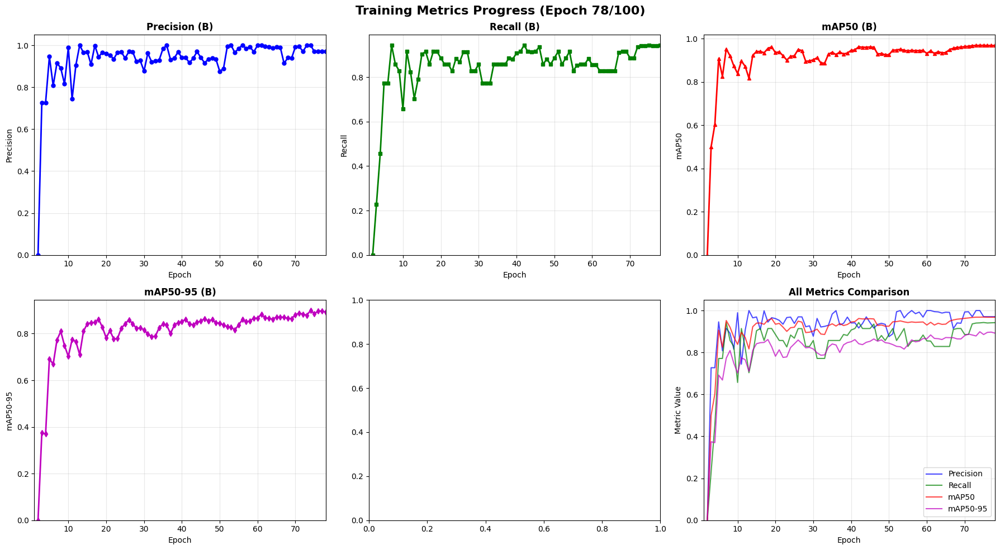



CURRENT STATUS - 16:58:42
  >>>  EPOCH: 78/100  <<<
  Status: Validation completed


CURRENT STATUS - 16:58:44
  >>>  EPOCH: 78/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     78/100      4.53G     0.4029     0.3113     0.9603         20        640: 100% ━━━━━━━━━━━━ 14/14 3.2s/it 44.7s2.7ss

CURRENT STATUS - 16:59:28
  >>>  EPOCH: 78/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.5s/it 3.1s6.5s
                   all         28         35      0.969      0.943      0.968      0.891

EPOCH 79/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.9996
  metrics/recall(B): 0.9143
  metrics/mAP50(B): 0.9675
  metrics/mAP50-95(B): 0.8779
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metri

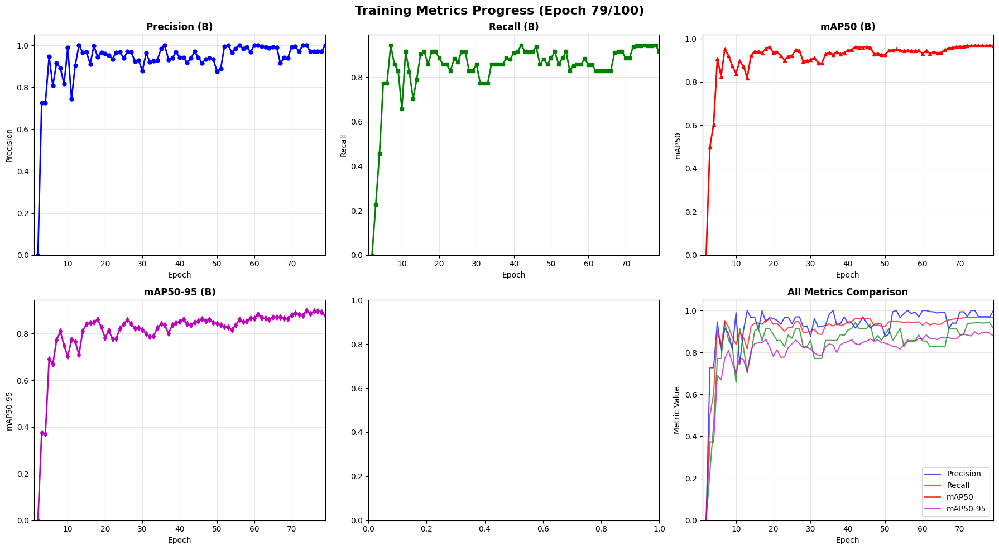



CURRENT STATUS - 16:59:33
  >>>  EPOCH: 79/100  <<<
  Status: Validation completed


CURRENT STATUS - 16:59:34
  >>>  EPOCH: 79/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     79/100      4.53G     0.3912     0.2873     0.9685         10        640: 100% ━━━━━━━━━━━━ 14/14 3.8s/it 53.0s3.3ss

CURRENT STATUS - 17:00:27
  >>>  EPOCH: 79/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.5s/it 3.1s6.7s
                   all         28         35      0.966      0.943      0.967      0.893

EPOCH 80/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.9691
  metrics/recall(B): 0.9429
  metrics/mAP50(B): 0.9682
  metrics/mAP50-95(B): 0.8915
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metri

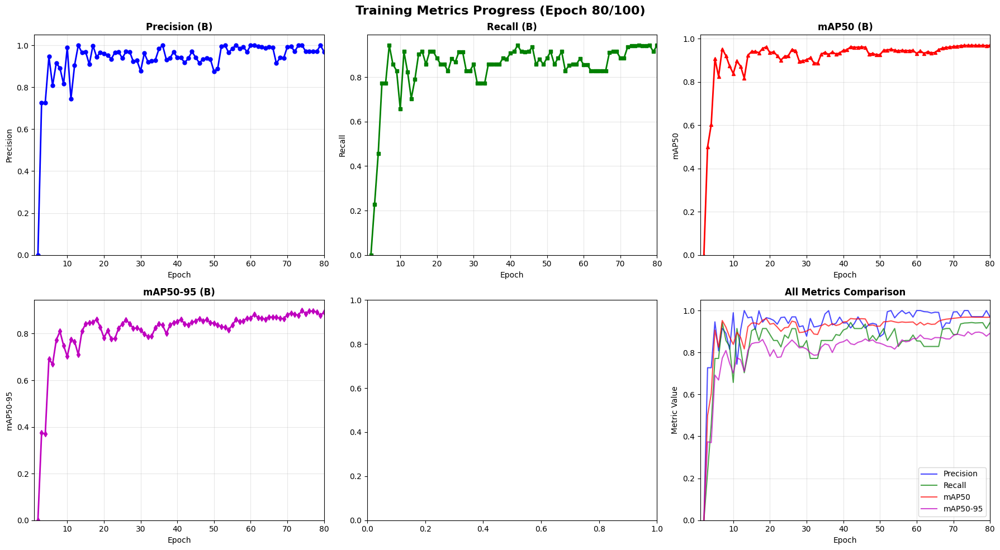



CURRENT STATUS - 17:00:31
  >>>  EPOCH: 80/100  <<<
  Status: Validation completed


CURRENT STATUS - 17:00:32
  >>>  EPOCH: 80/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     80/100      4.53G     0.3604     0.2792     0.9419         16        640: 100% ━━━━━━━━━━━━ 14/14 3.4s/it 47.0s3.0ss

CURRENT STATUS - 17:01:19
  >>>  EPOCH: 80/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.4s/it 2.7s5.6s
                   all         28         35      0.963      0.943      0.968      0.899

EPOCH 81/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.9663
  metrics/recall(B): 0.9429
  metrics/mAP50(B): 0.9673
  metrics/mAP50-95(B): 0.8926
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metri

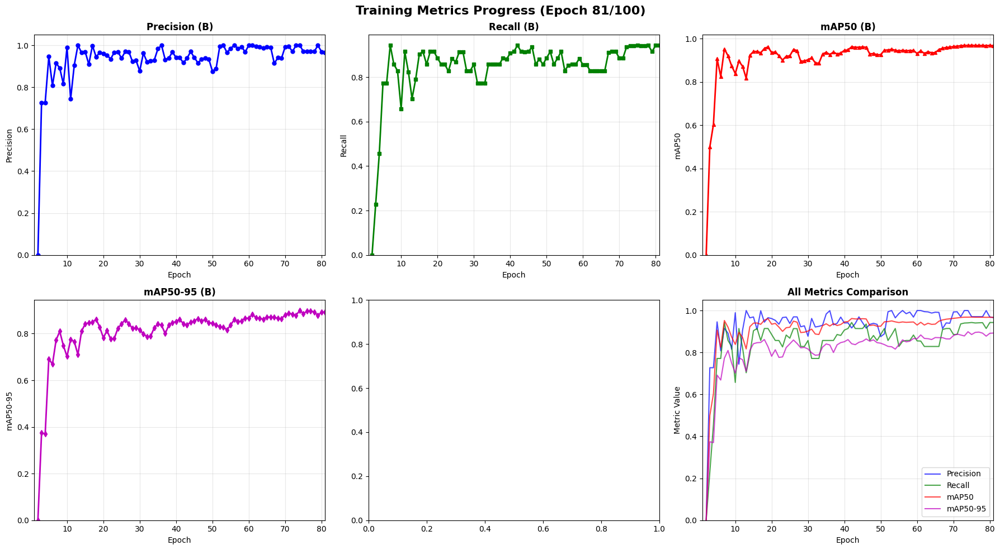



CURRENT STATUS - 17:01:23
  >>>  EPOCH: 81/100  <<<
  Status: Validation completed


CURRENT STATUS - 17:01:25
  >>>  EPOCH: 81/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     81/100      4.53G     0.4083     0.2925     0.9778         13        640: 100% ━━━━━━━━━━━━ 14/14 3.6s/it 50.9s3.1ss

CURRENT STATUS - 17:02:16
  >>>  EPOCH: 81/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.9s/it 3.8s9.1s
                   all         28         35      0.969      0.943      0.968        0.9

EPOCH 82/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.9628
  metrics/recall(B): 0.9429
  metrics/mAP50(B): 0.9680
  metrics/mAP50-95(B): 0.8987
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metri

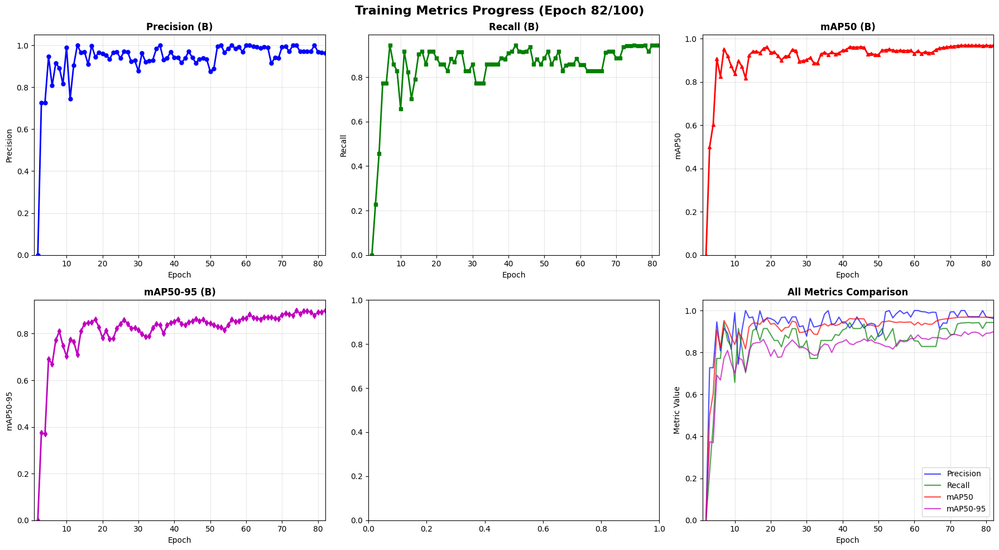



CURRENT STATUS - 17:02:21
  >>>  EPOCH: 82/100  <<<
  Status: Validation completed


CURRENT STATUS - 17:02:22
  >>>  EPOCH: 82/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     82/100      4.53G     0.3919      0.315     0.9776         18        640: 100% ━━━━━━━━━━━━ 14/14 3.8s/it 53.9s3.4ss

CURRENT STATUS - 17:03:16
  >>>  EPOCH: 82/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.9s/it 3.8s8.1s
                   all         28         35      0.969      0.943      0.969      0.893

EPOCH 83/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.9693
  metrics/recall(B): 0.9429
  metrics/mAP50(B): 0.9680
  metrics/mAP50-95(B): 0.9000
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metri

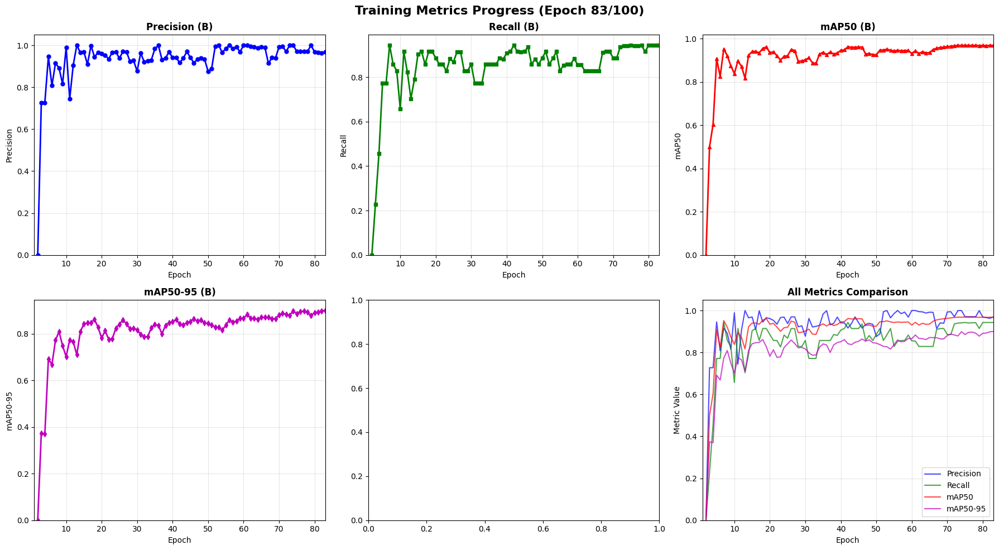



CURRENT STATUS - 17:03:21
  >>>  EPOCH: 83/100  <<<
  Status: Validation completed


CURRENT STATUS - 17:03:22
  >>>  EPOCH: 83/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     83/100      4.54G     0.3685     0.2943      0.938         17        640: 100% ━━━━━━━━━━━━ 14/14 3.6s/it 49.8s3.2ss

CURRENT STATUS - 17:04:12
  >>>  EPOCH: 83/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.7s/it 3.4s7.3s
                   all         28         35      0.969      0.943      0.968      0.894

EPOCH 84/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.9691
  metrics/recall(B): 0.9429
  metrics/mAP50(B): 0.9689
  metrics/mAP50-95(B): 0.8926
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metri

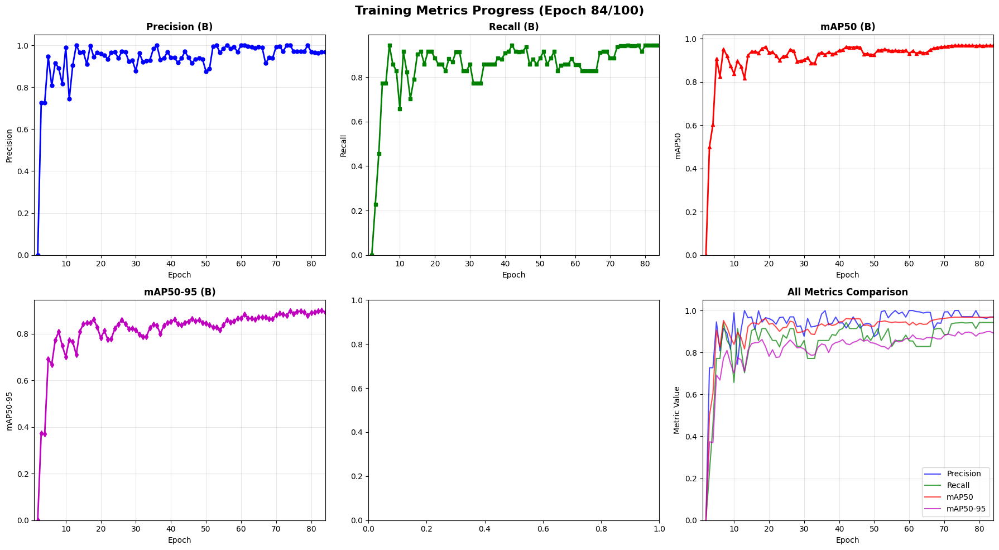



CURRENT STATUS - 17:04:17
  >>>  EPOCH: 84/100  <<<
  Status: Validation completed


CURRENT STATUS - 17:04:18
  >>>  EPOCH: 84/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     84/100      4.54G     0.4043     0.3092     0.9675         15        640: 100% ━━━━━━━━━━━━ 14/14 3.5s/it 48.6s3.0ss

CURRENT STATUS - 17:05:07
  >>>  EPOCH: 84/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.5s/it 2.9s5.9s
                   all         28         35      0.964      0.943      0.968      0.894

EPOCH 85/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.9692
  metrics/recall(B): 0.9429
  metrics/mAP50(B): 0.9680
  metrics/mAP50-95(B): 0.8942
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metri

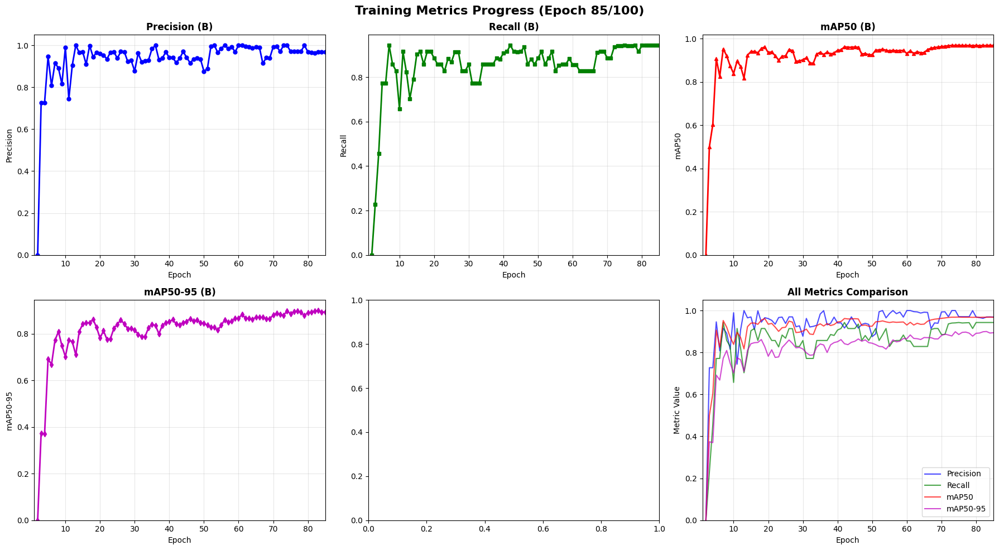



CURRENT STATUS - 17:05:11
  >>>  EPOCH: 85/100  <<<
  Status: Validation completed


CURRENT STATUS - 17:05:13
  >>>  EPOCH: 85/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     85/100      4.53G     0.3939     0.2948     0.9389         11        640: 100% ━━━━━━━━━━━━ 14/14 4.3s/it 1:013.3sss

CURRENT STATUS - 17:06:13
  >>>  EPOCH: 85/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.5s/it 2.9s6.5s
                   all         28         35      0.964      0.943      0.968      0.897

EPOCH 86/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.9641
  metrics/recall(B): 0.9429
  metrics/mAP50(B): 0.9680
  metrics/mAP50-95(B): 0.8943
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metri

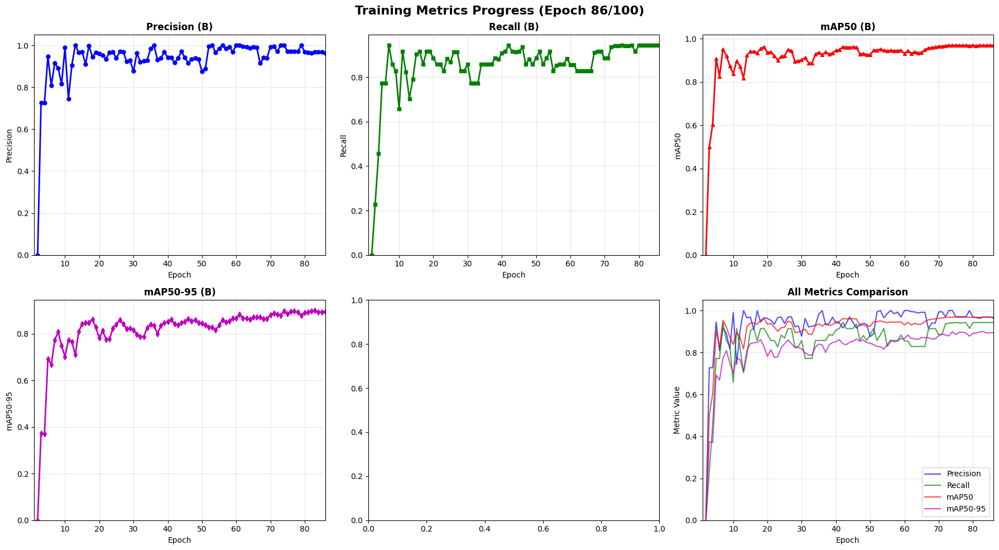



CURRENT STATUS - 17:06:18
  >>>  EPOCH: 86/100  <<<
  Status: Validation completed


CURRENT STATUS - 17:06:19
  >>>  EPOCH: 86/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     86/100      4.54G     0.4286     0.3396      1.002         23        640: 100% ━━━━━━━━━━━━ 14/14 3.5s/it 49.6s3.0ss

CURRENT STATUS - 17:07:08
  >>>  EPOCH: 86/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.8s/it 3.5s7.9s
                   all         28         35      0.967      0.943      0.969        0.9

EPOCH 87/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.9638
  metrics/recall(B): 0.9429
  metrics/mAP50(B): 0.9680
  metrics/mAP50-95(B): 0.8974
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metri

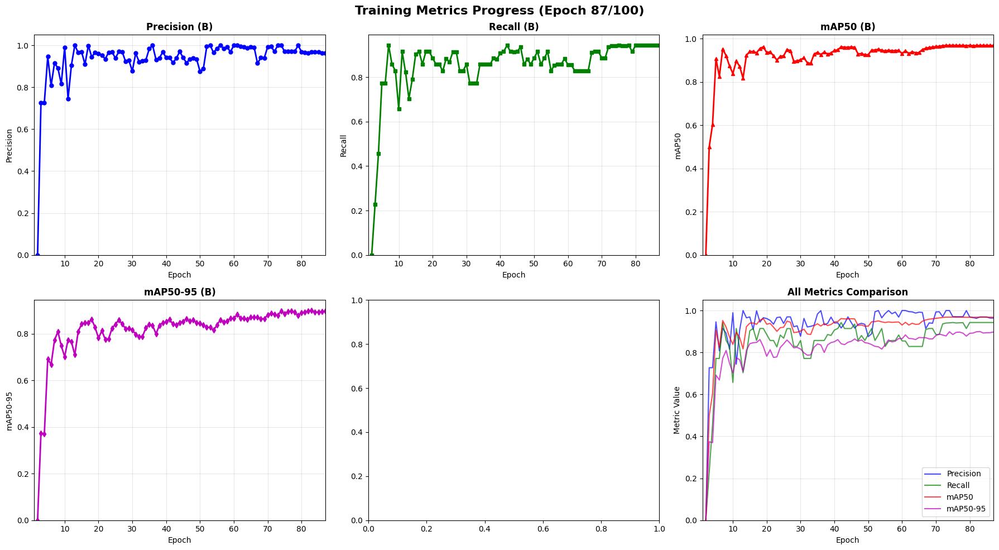



CURRENT STATUS - 17:07:13
  >>>  EPOCH: 87/100  <<<
  Status: Validation completed


CURRENT STATUS - 17:07:14
  >>>  EPOCH: 87/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     87/100      4.53G      0.345     0.2824     0.9349         21        640: 100% ━━━━━━━━━━━━ 14/14 4.1s/it 57.0s4.4ss

CURRENT STATUS - 17:08:11
  >>>  EPOCH: 87/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.7s/it 3.4s6.9s
                   all         28         35      0.967      0.943      0.968        0.9

EPOCH 88/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.9674
  metrics/recall(B): 0.9429
  metrics/mAP50(B): 0.9689
  metrics/mAP50-95(B): 0.8999
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metri

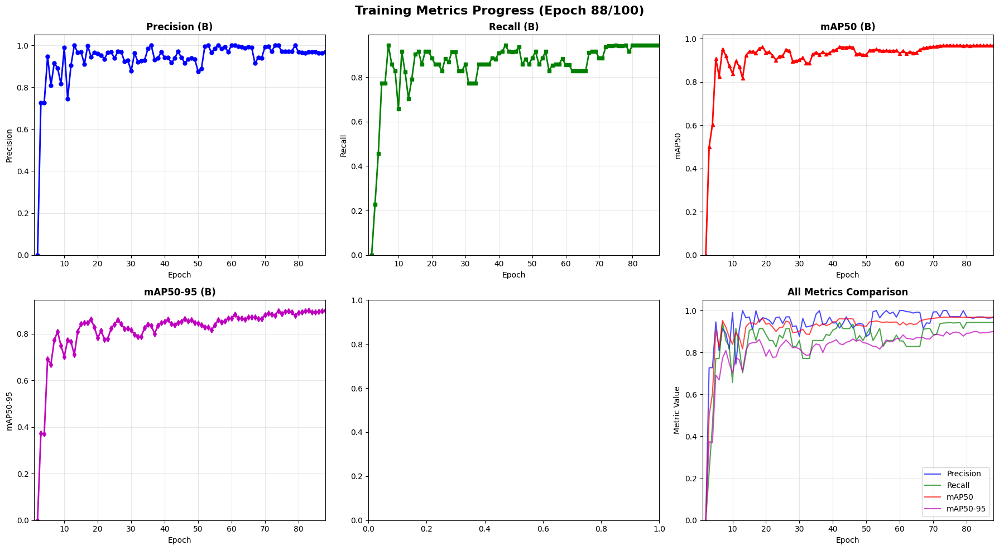



CURRENT STATUS - 17:08:16
  >>>  EPOCH: 88/100  <<<
  Status: Validation completed


CURRENT STATUS - 17:08:17
  >>>  EPOCH: 88/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     88/100      4.53G     0.3956     0.3187     0.9596         14        640: 100% ━━━━━━━━━━━━ 14/14 3.5s/it 49.4s3.7ss

CURRENT STATUS - 17:09:06
  >>>  EPOCH: 88/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.6s/it 3.1s6.4s
                   all         28         35      0.967      0.943      0.968      0.898

EPOCH 89/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.9675
  metrics/recall(B): 0.9429
  metrics/mAP50(B): 0.9682
  metrics/mAP50-95(B): 0.9000
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metri

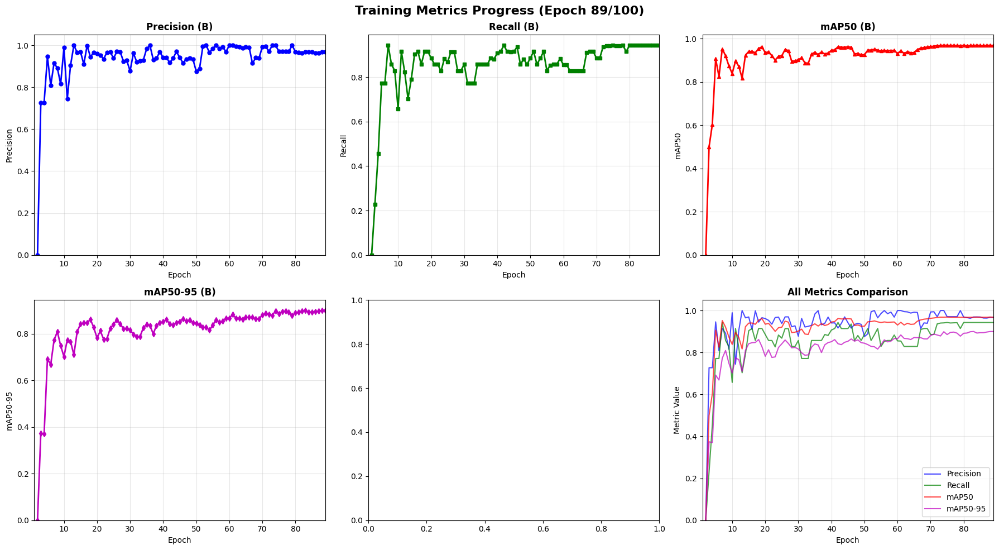



CURRENT STATUS - 17:09:11
  >>>  EPOCH: 89/100  <<<
  Status: Validation completed


CURRENT STATUS - 17:09:12
  >>>  EPOCH: 89/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     89/100      4.54G     0.3783     0.3182     0.9417         19        640: 100% ━━━━━━━━━━━━ 14/14 3.9s/it 54.5s4.1ss

CURRENT STATUS - 17:10:07
  >>>  EPOCH: 89/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.7s/it 3.4s7.4s
                   all         28         35      0.971      0.943      0.969      0.904

EPOCH 90/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.9674
  metrics/recall(B): 0.9429
  metrics/mAP50(B): 0.9680
  metrics/mAP50-95(B): 0.8977
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metri

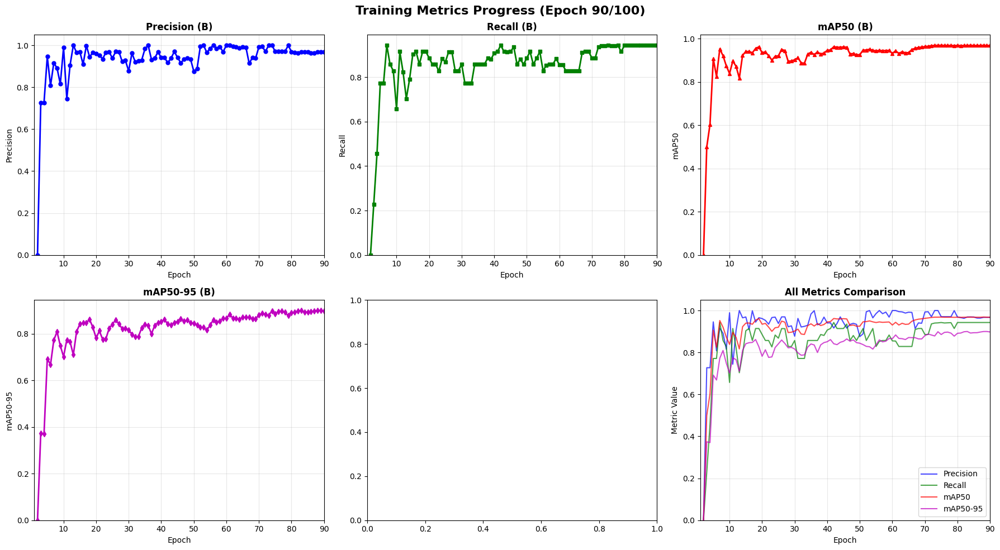



CURRENT STATUS - 17:10:12
  >>>  EPOCH: 90/100  <<<
  Status: Validation completed


CURRENT STATUS - 17:10:13
  >>>  EPOCH: 90/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     90/100      4.53G      0.355     0.2865     0.9204         13        640: 100% ━━━━━━━━━━━━ 14/14 3.7s/it 51.5s4.0ss

CURRENT STATUS - 17:11:04
  >>>  EPOCH: 90/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 2.9s/it 5.9s<15.6s
                   all         28         35      0.971      0.943      0.969      0.905

EPOCH 91/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.9706
  metrics/recall(B): 0.9429
  metrics/mAP50(B): 0.9687
  metrics/mAP50-95(B): 0.9036
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_met

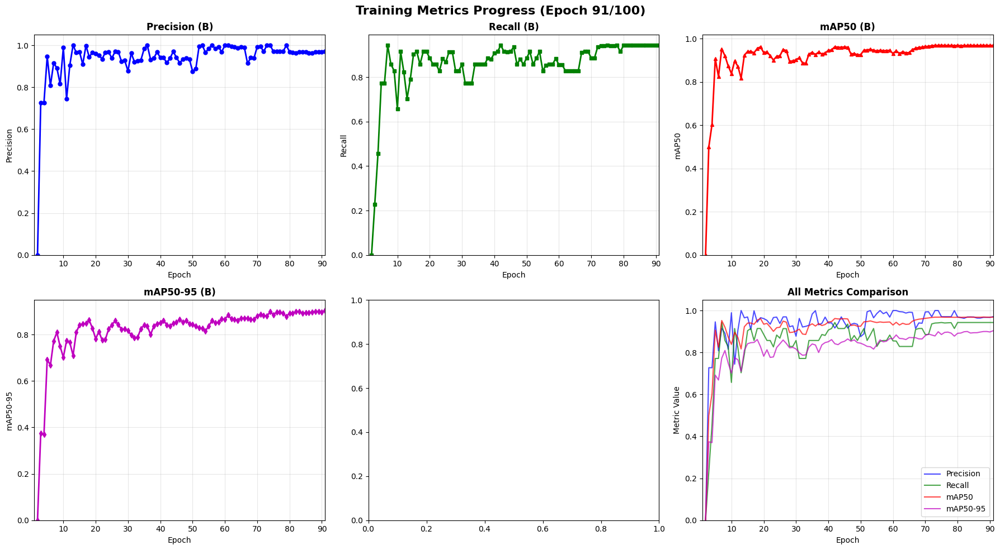



CURRENT STATUS - 17:11:12
  >>>  EPOCH: 91/100  <<<
  Status: Validation completed


CURRENT STATUS - 17:11:13
  >>>  EPOCH: 91/100  <<<
  Status: Training in progress...

Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     91/100      4.53G      0.265      0.217     0.8724          9        640: 100% ━━━━━━━━━━━━ 14/14 3.4s/it 47.7s3.6s

CURRENT STATUS - 17:12:00
  >>>  EPOCH: 91/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.7s/it 3.4s6.7s
                   all         28         35       0.97      0.943       0.97       0.91

EPOCH 92/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.9706
  metrics/recall(B): 0.9429
  metrics/mAP50(B): 0.9687
  metrics/mAP50-95(B): 0.9051
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcoh

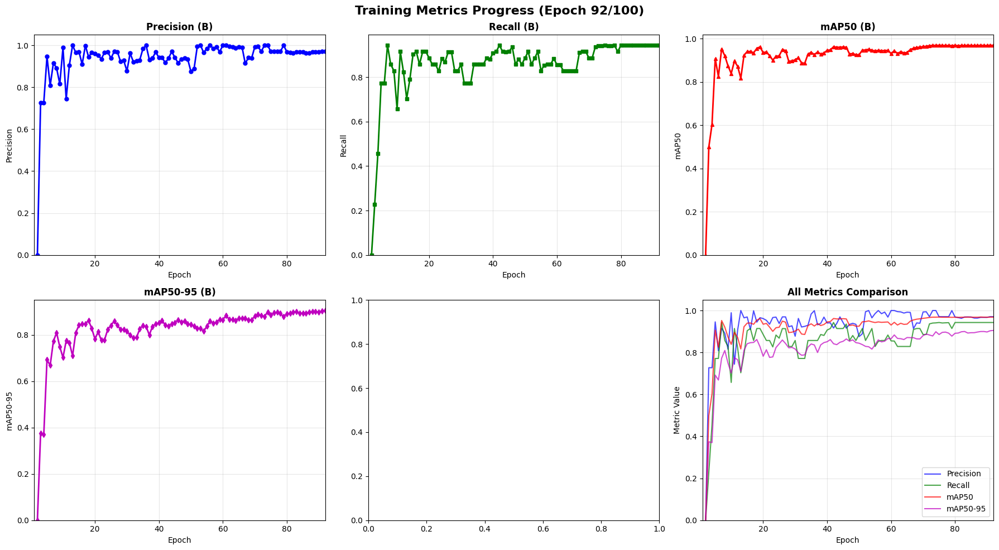



CURRENT STATUS - 17:12:05
  >>>  EPOCH: 92/100  <<<
  Status: Validation completed


CURRENT STATUS - 17:12:06
  >>>  EPOCH: 92/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     92/100      4.53G     0.2719     0.2146      0.891          8        640: 100% ━━━━━━━━━━━━ 14/14 4.3s/it 1:013.4sss

CURRENT STATUS - 17:13:07
  >>>  EPOCH: 92/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.6s/it 3.2s6.4s
                   all         28         35      0.996      0.943       0.97      0.917

EPOCH 93/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.9705
  metrics/recall(B): 0.9429
  metrics/mAP50(B): 0.9698
  metrics/mAP50-95(B): 0.9098
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metri

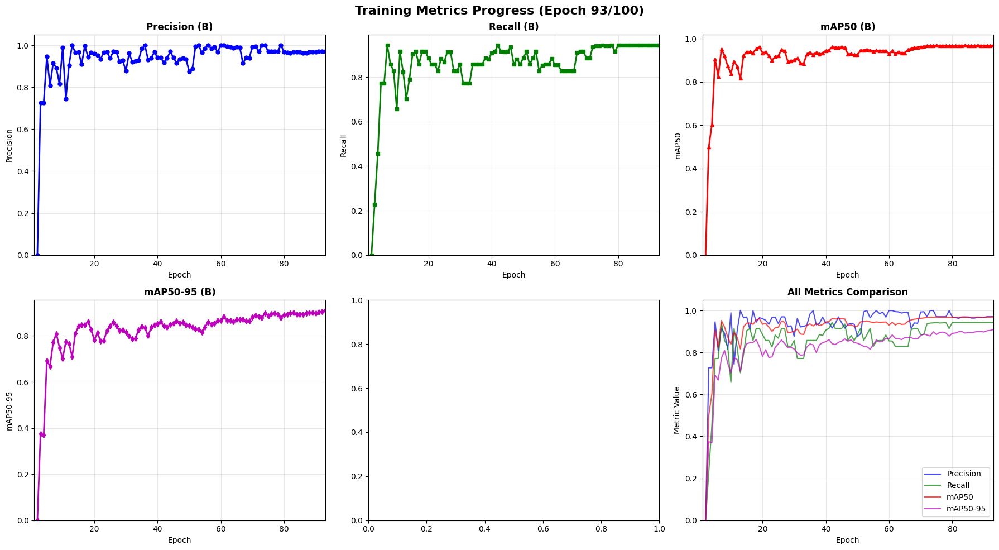



CURRENT STATUS - 17:13:12
  >>>  EPOCH: 93/100  <<<
  Status: Validation completed


CURRENT STATUS - 17:13:13
  >>>  EPOCH: 93/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     93/100      4.53G     0.2727     0.2159     0.8881          9        640: 100% ━━━━━━━━━━━━ 14/14 4.2s/it 59.0s3.0ss

CURRENT STATUS - 17:14:12
  >>>  EPOCH: 93/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.7s/it 3.4s7.9s
                   all         28         35      0.997      0.943       0.97      0.922

EPOCH 94/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.9957
  metrics/recall(B): 0.9429
  metrics/mAP50(B): 0.9698
  metrics/mAP50-95(B): 0.9169
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metri

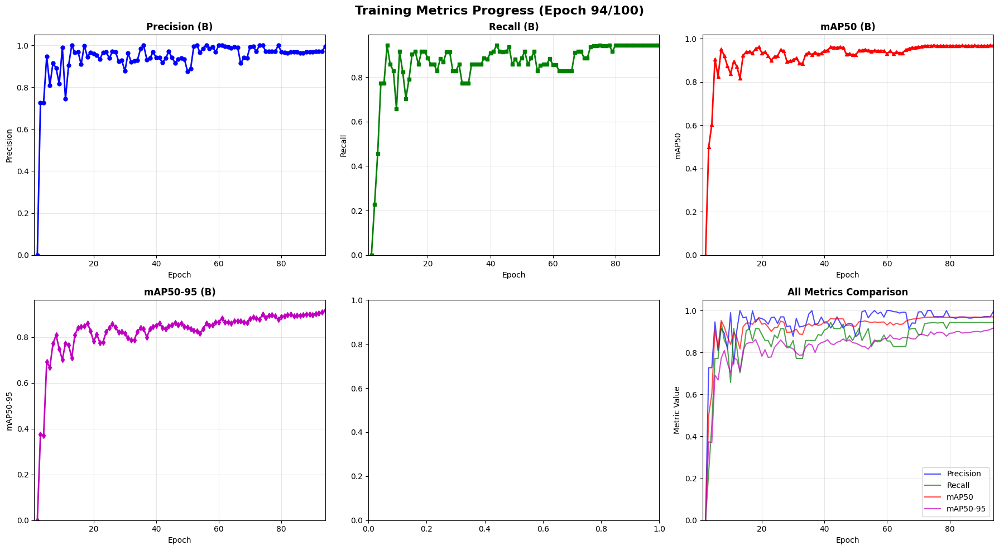



CURRENT STATUS - 17:14:17
  >>>  EPOCH: 94/100  <<<
  Status: Validation completed


CURRENT STATUS - 17:14:18
  >>>  EPOCH: 94/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     94/100      4.53G     0.2627     0.2235        0.9          8        640: 100% ━━━━━━━━━━━━ 14/14 3.8s/it 53.2s2.9ss

CURRENT STATUS - 17:15:11
  >>>  EPOCH: 94/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.6s/it 3.1s6.3s
                   all         28         35      0.996      0.943       0.97      0.916

EPOCH 95/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.9966
  metrics/recall(B): 0.9429
  metrics/mAP50(B): 0.9698
  metrics/mAP50-95(B): 0.9224
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metri

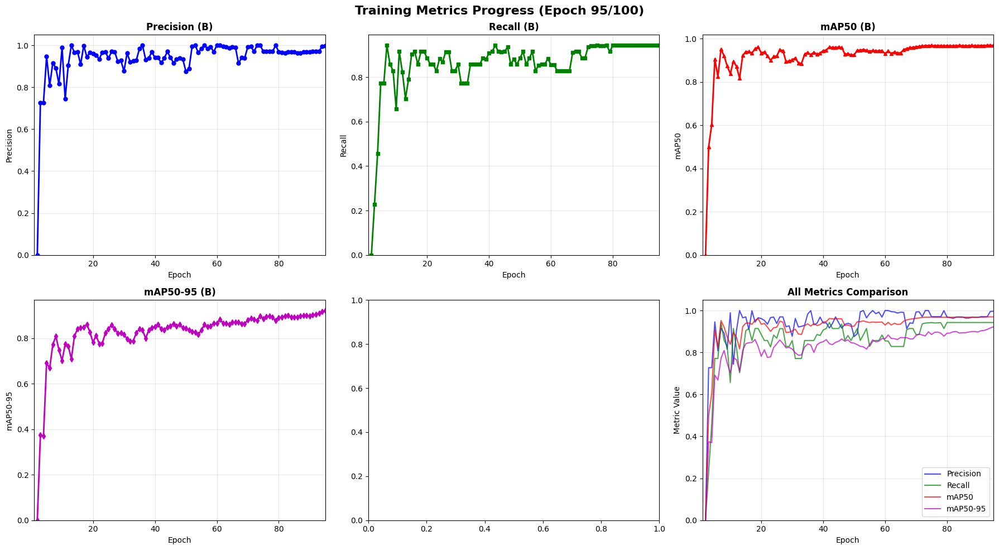



CURRENT STATUS - 17:15:15
  >>>  EPOCH: 95/100  <<<
  Status: Validation completed


CURRENT STATUS - 17:15:17
  >>>  EPOCH: 95/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     95/100      4.53G      0.259     0.2026      0.847          8        640: 100% ━━━━━━━━━━━━ 14/14 3.9s/it 53.9s3.5ss

CURRENT STATUS - 17:16:11
  >>>  EPOCH: 95/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.5s/it 3.1s6.4s
                   all         28         35      0.997      0.943       0.97      0.921

EPOCH 96/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.9961
  metrics/recall(B): 0.9429
  metrics/mAP50(B): 0.9698
  metrics/mAP50-95(B): 0.9162
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metri

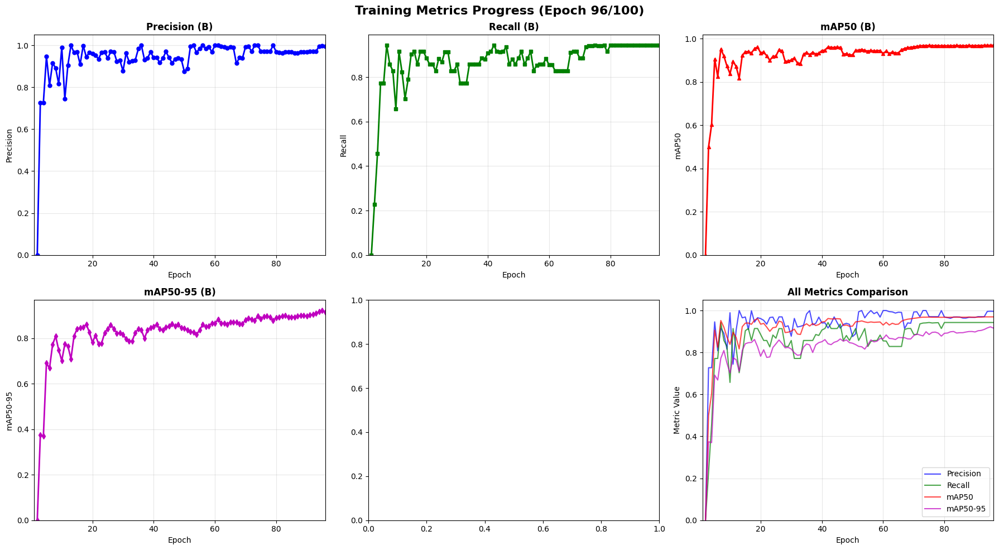



CURRENT STATUS - 17:16:15
  >>>  EPOCH: 96/100  <<<
  Status: Validation completed


CURRENT STATUS - 17:16:16
  >>>  EPOCH: 96/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     96/100      4.53G     0.2578     0.2034     0.8836          9        640: 100% ━━━━━━━━━━━━ 14/14 4.7s/it 1:053.4s3s

CURRENT STATUS - 17:17:21
  >>>  EPOCH: 96/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.8s/it 3.5s7.0s
                   all         28         35      0.997      0.943       0.97      0.921

EPOCH 97/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.9968
  metrics/recall(B): 0.9429
  metrics/mAP50(B): 0.9698
  metrics/mAP50-95(B): 0.9212
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metri

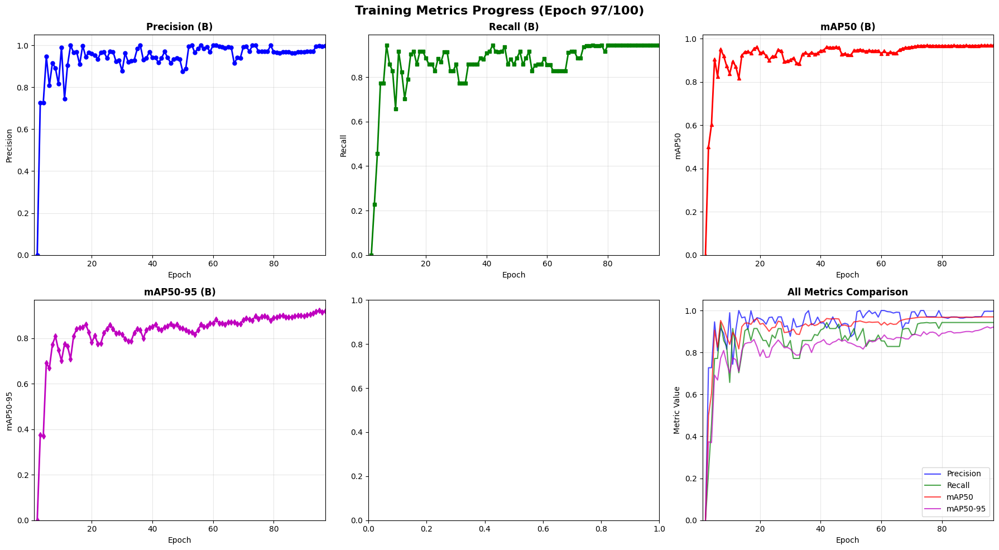



CURRENT STATUS - 17:17:26
  >>>  EPOCH: 97/100  <<<
  Status: Validation completed


CURRENT STATUS - 17:17:28
  >>>  EPOCH: 97/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     97/100      4.53G     0.2524     0.2041     0.8949         15        640: 100% ━━━━━━━━━━━━ 14/14 3.8s/it 53.8s3.5ss

CURRENT STATUS - 17:18:22
  >>>  EPOCH: 97/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.9s/it 3.7s8.6s
                   all         28         35      0.996      0.943       0.97       0.92

EPOCH 98/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.9966
  metrics/recall(B): 0.9429
  metrics/mAP50(B): 0.9698
  metrics/mAP50-95(B): 0.9206
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metri

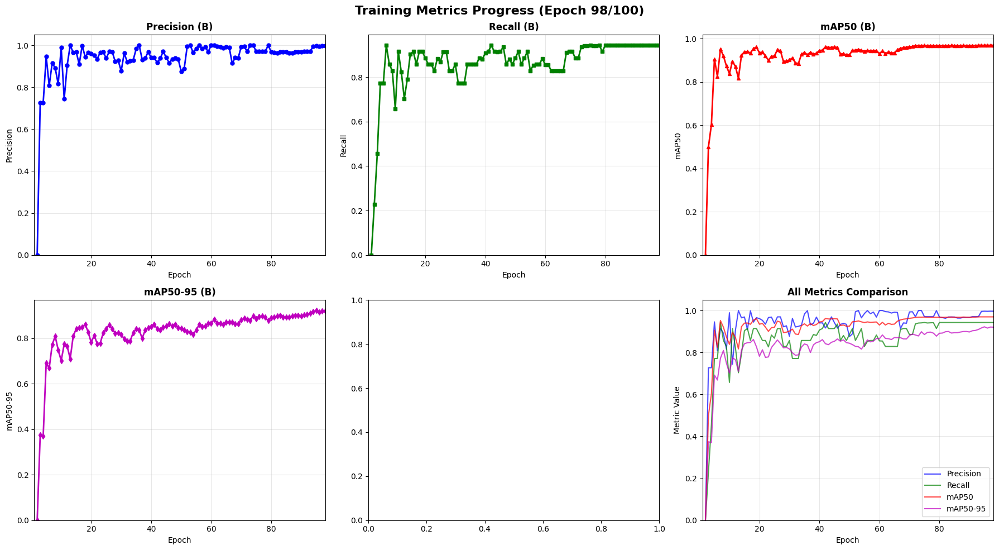



CURRENT STATUS - 17:18:27
  >>>  EPOCH: 98/100  <<<
  Status: Validation completed


CURRENT STATUS - 17:18:28
  >>>  EPOCH: 98/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     98/100      4.53G     0.2408     0.2028     0.8713          8        640: 100% ━━━━━━━━━━━━ 14/14 4.2s/it 58.2s3.8ss

CURRENT STATUS - 17:19:26
  >>>  EPOCH: 98/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.7s/it 3.4s6.8s
                   all         28         35      0.997      0.943       0.97      0.914

EPOCH 99/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.9962
  metrics/recall(B): 0.9429
  metrics/mAP50(B): 0.9698
  metrics/mAP50-95(B): 0.9204
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metri

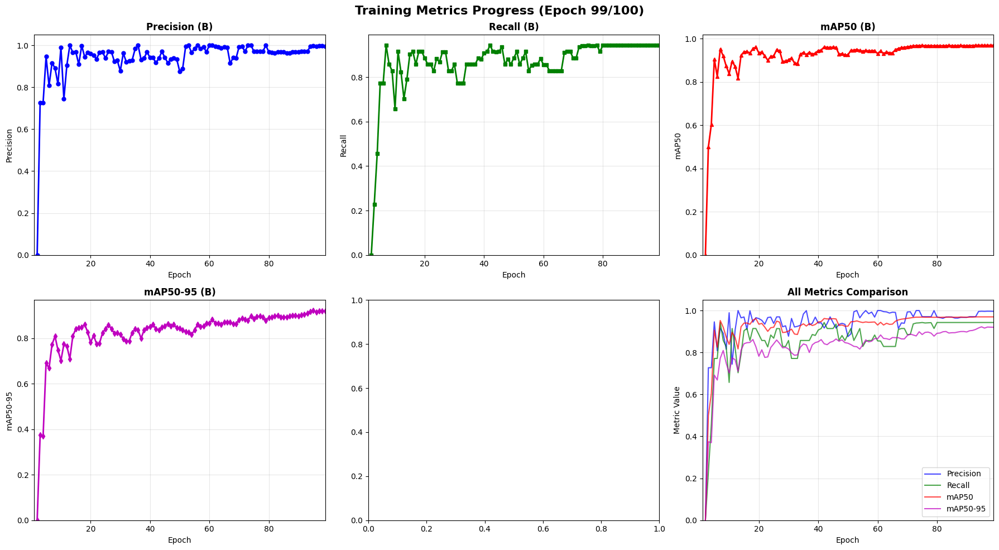



CURRENT STATUS - 17:19:31
  >>>  EPOCH: 99/100  <<<
  Status: Validation completed


CURRENT STATUS - 17:19:32
  >>>  EPOCH: 99/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     99/100      4.53G     0.2517      0.211     0.8744          9        640: 100% ━━━━━━━━━━━━ 14/14 4.1s/it 57.2s4.2ss

CURRENT STATUS - 17:20:29
  >>>  EPOCH: 99/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.5s/it 3.1s6.4s
                   all         28         35      0.997      0.943       0.97      0.912

EPOCH 100/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.9967
  metrics/recall(B): 0.9429
  metrics/mAP50(B): 0.9698
  metrics/mAP50-95(B): 0.9138
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_metr

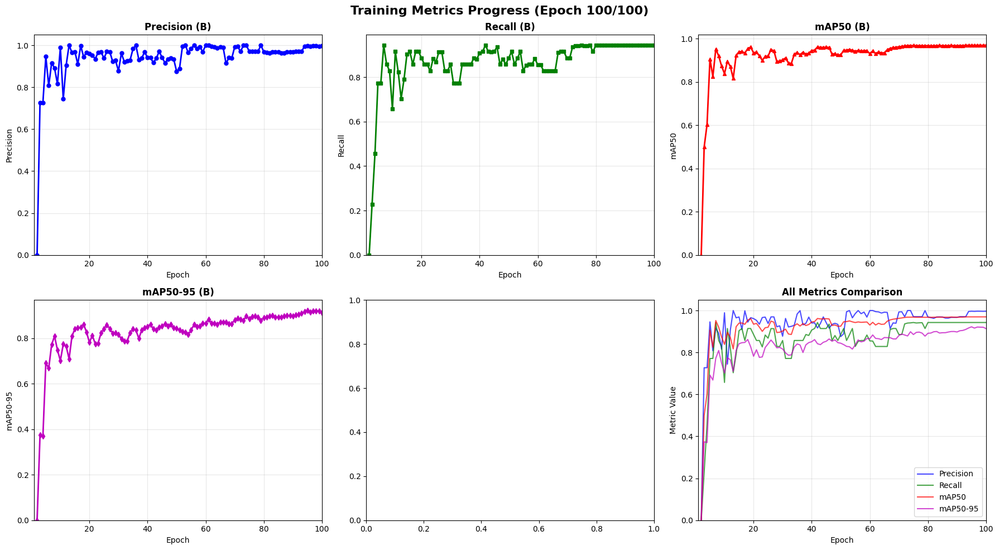



CURRENT STATUS - 17:20:33
  >>>  EPOCH: 100/100  <<<
  Status: Validation completed


CURRENT STATUS - 17:20:35
  >>>  EPOCH: 100/100  <<<
  Status: Training in progress...


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
    100/100      4.53G     0.2431     0.1971     0.8445          8        640: 100% ━━━━━━━━━━━━ 14/14 4.0s/it 56.2s2.7ss

CURRENT STATUS - 17:21:31
  >>>  EPOCH: 100/100  <<<
  Status: Training completed, validating...

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.7s/it 3.5s8.1s
                   all         28         35      0.997      0.943       0.97      0.912

EPOCH 101/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.9966
  metrics/recall(B): 0.9429
  metrics/mAP50(B): 0.9698
  metrics/mAP50-95(B): 0.9121
  fitness: Not available

📊 Generating accuracy curves with all past episode data...
📊 Plot saved to: models/yolo11_alcohol_bottles/training_m

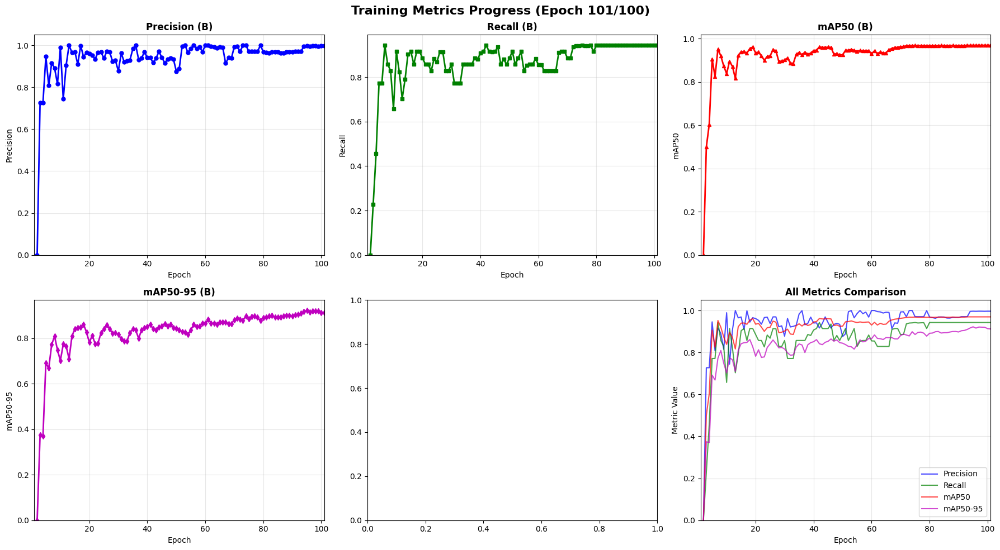



CURRENT STATUS - 17:21:36
  >>>  EPOCH: 101/100  <<<
  Status: Validation completed


100 epochs completed in 2.886 hours.
Optimizer stripped from /Users/akosbokor/Documents/Machine Vision/Project/models/yolo11_alcohol_bottles/weights/last.pt, 19.2MB
Optimizer stripped from /Users/akosbokor/Documents/Machine Vision/Project/models/yolo11_alcohol_bottles/weights/best.pt, 19.2MB

Validating /Users/akosbokor/Documents/Machine Vision/Project/models/yolo11_alcohol_bottles/weights/best.pt...
Ultralytics 8.3.230 🚀 Python-3.9.6 torch-2.8.0 MPS (Apple M4)
YOLO11s summary (fused): 100 layers, 9,413,187 parameters, 0 gradients, 21.3 GFLOPs
WARNING ⚠️ NMS time limit 2.800s exceeded
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 5.2s/it 10.5s20.2s
                   all         28         35      0.947      0.514      0.703      0.688

EPOCH 101/100 - FINAL METRICS

Final Metrics:

  metrics/precision(B): 0.9967
  metrics/recall(B): 

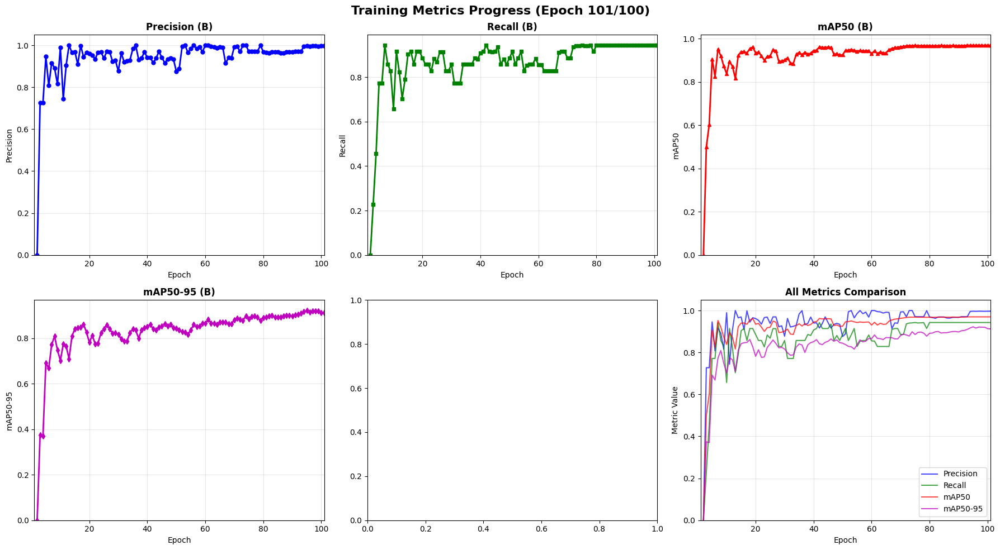



CURRENT STATUS - 17:21:49
  >>>  EPOCH: 101/100  <<<
  Status: Validation completed

Speed: 0.3ms preprocess, 113.6ms inference, 0.0ms loss, 123.7ms postprocess per image
Results saved to /Users/akosbokor/Documents/Machine Vision/Project/models/yolo11_alcohol_bottles

TRAINING COMPLETED!
Total epochs trained: 100

Best model saved at:
  models/yolo11_alcohol_bottles/weights/best.pt

Use best.pt for inference and deployment!


In [54]:
# ============================================================================
# EXECUTE YOLO TRAINING
# ============================================================================
# PURPOSE: Run the actual training loop for 100 epochs
#
# WHAT HAPPENS DURING TRAINING:
# 1. Each epoch: model processes all 112 training images
# 2. After each epoch: validates on 28 validation images
# 3. Computes metrics: mAP, precision, recall, losses
# 4. Saves best model (highest mAP) and checkpoints every 10 epochs
# 5. Generates training plots
#
# MONITORING PROGRESS:
# - First column shows epoch: "X/100" (e.g., "50/100" = epoch 50)
# - Watch for: decreasing losses, increasing mAP
# - Instances column should show ~50 (objects per batch)
#
# EXPECTED RESULTS (after 100 epochs):
# - mAP50: 0.70-0.95 (70-95% detection accuracy)
# - Precision: 0.80-0.95 (80-95% correct detections)
# - Recall: 0.75-0.90 (75-90% objects found)
#
# TRAINING TIME: ~10-30 minutes on Apple Silicon M4
#
# OUTPUT FILES:
# - models/yolo11_alcohol_bottles/weights/best.pt  (use this for inference!)
# - models/yolo11_alcohol_bottles/weights/last.pt
# - models/yolo11_alcohol_bottles/results.csv
# - models/yolo11_alcohol_bottles/results.png
# ============================================================================

print("\n" + "="*80)
print("STARTING YOLO V11 TRAINING - 100 EPOCHS")
print("="*80)
print("Watch the 'Instances' column - should show ~50 objects per batch")
print("If it shows 0, labels are missing! Run the annotation conversion script.")
print("="*80 + "\n")

# Train the model 
results = model.train(**training_args)

# Training completed
print("\n" + "="*80)
print("TRAINING COMPLETED!")
print("="*80)
print(f"Total epochs trained: {training_args['epochs']}")
print(f"\nBest model saved at:")
print(f"  models/yolo11_alcohol_bottles/weights/best.pt")
print("\nUse best.pt for inference and deployment!")
print("="*80)

In [55]:
# ============================================================================
# Training Results and Visualization
# ============================================================================
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

print(f"\nTraining Results:")
print(f"  Best model saved at: {Path('models/yolo11_alcohol_bottles') / 'weights' / 'best.pt'}")
print(f"  Last model saved at: {Path('models/yolo11_alcohol_bottles') / 'weights' / 'last.pt'}")

# Print metrics if available
if hasattr(results, 'results_dict'):
    print(f"\nFinal Metrics:")
    for key, value in results.results_dict.items():
        print(f"  {key}: {value:.4f}")

print("\n✓ YOLO v11 training completed successfully!")


Training Results:
  Best model saved at: models/yolo11_alcohol_bottles/weights/best.pt
  Last model saved at: models/yolo11_alcohol_bottles/weights/last.pt

Final Metrics:
  metrics/precision(B): 0.9473
  metrics/recall(B): 0.5138
  metrics/mAP50(B): 0.7029
  metrics/mAP50-95(B): 0.6876
  fitness: 0.6876

✓ YOLO v11 training completed successfully!



GENERATING TRAINING METRICS GRAPHS


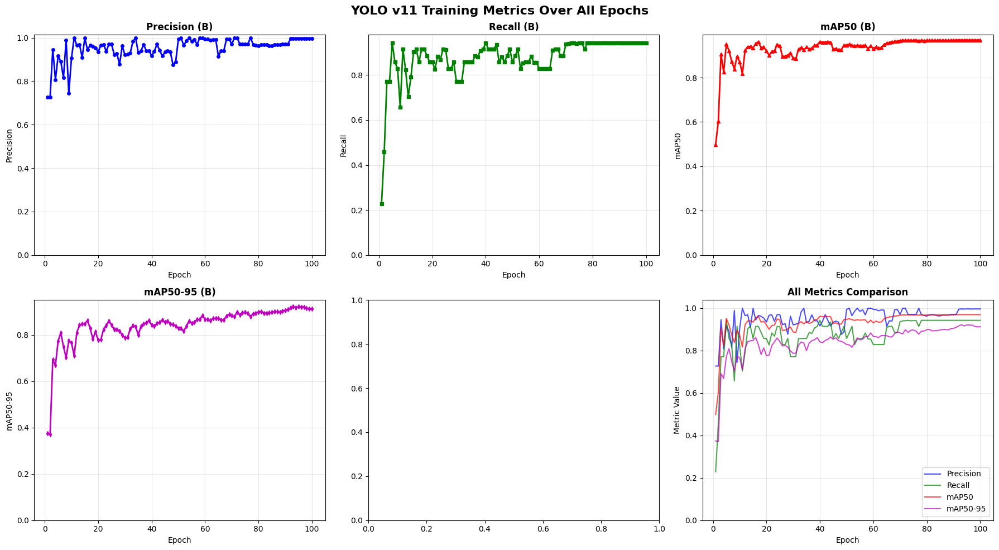


TRAINING METRICS SUMMARY

Precision (B):
  Best: 1.0000 (Epoch 11)
  Final: 0.9967

Recall (B):
  Best: 0.9429 (Epoch 5)
  Final: 0.9429

mAP50 (B):
  Best: 0.9698 (Epoch 91)
  Final: 0.9698

mAP50-95 (B):
  Best: 0.9224 (Epoch 93)
  Final: 0.9124



In [56]:
# ============================================================================
# Plot Training Metrics Over All Epochs
# ============================================================================
print("\n" + "="*80)
print("GENERATING TRAINING METRICS GRAPHS")
print("="*80)

results_file = Path('models/yolo11_alcohol_bottles') / 'results.csv'

if results_file.exists():
    try:
        # Read the results CSV
        df = pd.read_csv(results_file)

        if not df.empty:
            # Get epoch numbers
            if 'epoch' in df.columns:
                epochs = df['epoch'].values
            else:
                epochs = np.arange(1, len(df) + 1)

            # Create figure with subplots
            fig, axes = plt.subplots(2, 3, figsize=(18, 10))
            fig.suptitle('YOLO v11 Training Metrics Over All Epochs', fontsize=16, fontweight='bold')

            # Plot 1: Precision
            if 'metrics/precision(B)' in df.columns:
                axes[0, 0].plot(epochs, df['metrics/precision(B)'], 'b-', linewidth=2, marker='o', markersize=4)
                axes[0, 0].set_title('Precision (B)', fontsize=12, fontweight='bold')
                axes[0, 0].set_xlabel('Epoch')
                axes[0, 0].set_ylabel('Precision')
                axes[0, 0].grid(True, alpha=0.3)
                axes[0, 0].set_ylim(bottom=0)

            # Plot 2: Recall
            if 'metrics/recall(B)' in df.columns:
                axes[0, 1].plot(epochs, df['metrics/recall(B)'], 'g-', linewidth=2, marker='s', markersize=4)
                axes[0, 1].set_title('Recall (B)', fontsize=12, fontweight='bold')
                axes[0, 1].set_xlabel('Epoch')
                axes[0, 1].set_ylabel('Recall')
                axes[0, 1].grid(True, alpha=0.3)
                axes[0, 1].set_ylim(bottom=0)

            # Plot 3: mAP50
            if 'metrics/mAP50(B)' in df.columns:
                axes[0, 2].plot(epochs, df['metrics/mAP50(B)'], 'r-', linewidth=2, marker='^', markersize=4)
                axes[0, 2].set_title('mAP50 (B)', fontsize=12, fontweight='bold')
                axes[0, 2].set_xlabel('Epoch')
                axes[0, 2].set_ylabel('mAP50')
                axes[0, 2].grid(True, alpha=0.3)
                axes[0, 2].set_ylim(bottom=0)

            # Plot 4: mAP50-95
            if 'metrics/mAP50-95(B)' in df.columns:
                axes[1, 0].plot(epochs, df['metrics/mAP50-95(B)'], 'm-', linewidth=2, marker='d', markersize=4)
                axes[1, 0].set_title('mAP50-95 (B)', fontsize=12, fontweight='bold')
                axes[1, 0].set_xlabel('Epoch')
                axes[1, 0].set_ylabel('mAP50-95')
                axes[1, 0].grid(True, alpha=0.3)
                axes[1, 0].set_ylim(bottom=0)

            # Plot 5: Fitness
            if 'fitness' in df.columns:
                axes[1, 1].plot(epochs, df['fitness'], 'c-', linewidth=2, marker='*', markersize=4)
                axes[1, 1].set_title('Fitness', fontsize=12, fontweight='bold')
                axes[1, 1].set_xlabel('Epoch')
                axes[1, 1].set_ylabel('Fitness')
                axes[1, 1].grid(True, alpha=0.3)
                axes[1, 1].set_ylim(bottom=0)

            # Plot 6: Combined Metrics (all on one plot for comparison)
            axes[1, 2].set_title('All Metrics Comparison', fontsize=12, fontweight='bold')
            if 'metrics/precision(B)' in df.columns:
                axes[1, 2].plot(epochs, df['metrics/precision(B)'], 'b-', linewidth=1.5, label='Precision', alpha=0.7)
            if 'metrics/recall(B)' in df.columns:
                axes[1, 2].plot(epochs, df['metrics/recall(B)'], 'g-', linewidth=1.5, label='Recall', alpha=0.7)
            if 'metrics/mAP50(B)' in df.columns:
                axes[1, 2].plot(epochs, df['metrics/mAP50(B)'], 'r-', linewidth=1.5, label='mAP50', alpha=0.7)
            if 'metrics/mAP50-95(B)' in df.columns:
                axes[1, 2].plot(epochs, df['metrics/mAP50-95(B)'], 'm-', linewidth=1.5, label='mAP50-95', alpha=0.7)
            if 'fitness' in df.columns:
                axes[1, 2].plot(epochs, df['fitness'], 'c-', linewidth=1.5, label='Fitness', alpha=0.7)
            axes[1, 2].set_xlabel('Epoch')
            axes[1, 2].set_ylabel('Metric Value')
            axes[1, 2].legend(loc='best')
            axes[1, 2].grid(True, alpha=0.3)
            axes[1, 2].set_ylim(bottom=0)

            plt.tight_layout()
            plt.show()

            # Print summary statistics
            print("\n" + "="*80)
            print("TRAINING METRICS SUMMARY")
            print("="*80)

            if 'metrics/precision(B)' in df.columns:
                print(f"\nPrecision (B):")
                print(f"  Best: {df['metrics/precision(B)'].max():.4f} (Epoch {df.loc[df['metrics/precision(B)'].idxmax(), 'epoch'] if 'epoch' in df.columns else df['metrics/precision(B)'].idxmax() + 1})")
                print(f"  Final: {df['metrics/precision(B)'].iloc[-1]:.4f}")

            if 'metrics/recall(B)' in df.columns:
                print(f"\nRecall (B):")
                print(f"  Best: {df['metrics/recall(B)'].max():.4f} (Epoch {df.loc[df['metrics/recall(B)'].idxmax(), 'epoch'] if 'epoch' in df.columns else df['metrics/recall(B)'].idxmax() + 1})")
                print(f"  Final: {df['metrics/recall(B)'].iloc[-1]:.4f}")

            if 'metrics/mAP50(B)' in df.columns:
                print(f"\nmAP50 (B):")
                print(f"  Best: {df['metrics/mAP50(B)'].max():.4f} (Epoch {df.loc[df['metrics/mAP50(B)'].idxmax(), 'epoch'] if 'epoch' in df.columns else df['metrics/mAP50(B)'].idxmax() + 1})")
                print(f"  Final: {df['metrics/mAP50(B)'].iloc[-1]:.4f}")

            if 'metrics/mAP50-95(B)' in df.columns:
                print(f"\nmAP50-95 (B):")
                print(f"  Best: {df['metrics/mAP50-95(B)'].max():.4f} (Epoch {df.loc[df['metrics/mAP50-95(B)'].idxmax(), 'epoch'] if 'epoch' in df.columns else df['metrics/mAP50-95(B)'].idxmax() + 1})")
                print(f"  Final: {df['metrics/mAP50-95(B)'].iloc[-1]:.4f}")

            if 'fitness' in df.columns:
                print(f"\nFitness:")
                print(f"  Best: {df['fitness'].max():.4f} (Epoch {df.loc[df['fitness'].idxmax(), 'epoch'] if 'epoch' in df.columns else df['fitness'].idxmax() + 1})")
                print(f"  Final: {df['fitness'].iloc[-1]:.4f}")

            print("\n" + "="*80)
        else:
            print("\n⚠ No data found in results.csv")
    except Exception as e:
        print(f"\n⚠ Error reading or plotting results: {e}")
        import traceback
        traceback.print_exc()
else:
    print(f"\n⚠ Results file not found: {results_file}")
    print("  Graphs will be available after training completes.")


## Object Detection with Hugging Face Vision Transformer (DETR)

This section demonstrates object detection using DETR (Detection Transformer) from Hugging Face, which is based on Vision Transformer architecture. We'll test it on 128 images from the dataset.


In [58]:
# ============================================================================
# Install Hugging Face Transformers and Dependencies
# ============================================================================
# This cell ensures Hugging Face packages are installed for DETR model

import sys
import subprocess

print("="*80)
print("INSTALLING HUGGING FACE TRANSFORMERS PACKAGES")
print("="*80)
print(f"Python executable: {sys.executable}\n")

# List of required packages for Hugging Face DETR
required_packages = [
    'transformers',
    'timm',  # PyTorch Image Models - required for DETR
    'torch',
    'torchvision',
    'pillow',
    'matplotlib',
]

for package in required_packages:
    try:
        __import__(package if package != 'pillow' else 'PIL')
        print(f"✓ {package} is already installed and importable")
    except ImportError:
        print(f"⚠ {package} not found. Installing now...")
        # Force installation even if it says it's already installed elsewhere
        subprocess.check_call([sys.executable, "-m", "pip", "install", "--upgrade", package])
        print(f"✓ {package} installed successfully")
        # Try importing again to verify
        try:
            __import__(package if package != 'pillow' else 'PIL')
            print(f"✓ {package} verified working")
        except ImportError:
            print(f"⚠ WARNING: {package} installed but still can't import. May need kernel restart.")

print("\n" + "="*80)
print("HUGGING FACE PACKAGES READY!")



INSTALLING HUGGING FACE TRANSFORMERS PACKAGES
Python executable: /Users/akosbokor/PyCharmMiscProject/.venv/bin/python

✓ transformers is already installed and importable
✓ timm is already installed and importable
✓ torch is already installed and importable
✓ torchvision is already installed and importable
✓ pillow is already installed and importable
✓ matplotlib is already installed and importable

HUGGING FACE PACKAGES READY!


In [59]:
# ============================================================================
# Object Detection with Hugging Face DETR (Vision Transformer-based)
# ============================================================================
from transformers import AutoImageProcessor, AutoModelForObjectDetection
import torch
from PIL import Image, ImageDraw, ImageFont
import matplotlib.pyplot as plt
from pathlib import Path
import random
import numpy as np

In [60]:
# ============================================================================
# LOAD DETR MODEL (Vision Transformer for Object Detection)
# ============================================================================
# PURPOSE: Load pre-trained DETR model for comparison with YOLO
#
# WHAT IS DETR?
# - Detection Transformer: End-to-end object detection with transformers
# - Uses attention mechanisms instead of anchor boxes
# - Architecture: ResNet-50 backbone + Transformer encoder/decoder
#
# KEY DIFFERENCES FROM YOLO:
# YOLO:
#    Faster inference (~50 FPS)
#    Simpler architecture
#    Better for real-time applications
#
# DETR:
#    More accurate on complex scenes
#    No hand-crafted components (end-to-end)
#    Better at detecting small objects
#    Slower inference (~10 FPS)
#
# PRE-TRAINED ON: COCO dataset (80 classes)
# DETECTS: person, car, bottle, chair, dog, cat, etc. (general objects)
#
# ============================================================================

# Set up device for DETR model
import torch
device = torch.device("cuda" if torch.cuda.is_available() else
                      ("mps" if hasattr(torch.backends, 'mps') and torch.backends.mps.is_available() else "cpu"))
print(f"Using device: {device}\n")

print("="*80)
print("LOADING DETR - VISION TRANSFORMER FOR OBJECT DETECTION")
print("="*80)

# Load DETR model and processor
print("\nLoading DETR model from Hugging Face...")
model_name = "facebook/detr-resnet-50"

# Load image processor (handles preprocessing)
processor = AutoImageProcessor.from_pretrained(model_name)

# Load the pre-trained model
model = AutoModelForObjectDetection.from_pretrained(model_name)

# Move to GPU and set to evaluation mode
model.to(device)
model.eval()
print(f"✓ DETR model loaded and moved to {device}")

Using device: mps

LOADING DETR - VISION TRANSFORMER FOR OBJECT DETECTION

Loading DETR model from Hugging Face...


/Users/akosbokor/PyCharmMiscProject/.venv/lib/python3.9/site-packages/torch/nn/modules/module.py:2441: UserWarning: for conv1.weight: copying from a non-meta parameter in the checkpoint to a meta parameter in the current model, which is a no-op. (Did you mean to pass `assign=True` to assign items in the state dictionary to their corresponding key in the module instead of copying them in place?)
  warnings.warn(
/Users/akosbokor/PyCharmMiscProject/.venv/lib/python3.9/site-packages/torch/nn/modules/module.py:2441: UserWarning: for bn1.weight: copying from a non-meta parameter in the checkpoint to a meta parameter in the current model, which is a no-op. (Did you mean to pass `assign=True` to assign items in the state dictionary to their corresponding key in the module instead of copying them in place?)
  warnings.warn(
/Users/akosbokor/PyCharmMiscProject/.venv/lib/python3.9/site-packages/torch/nn/modules/module.py:2441: UserWarning: for bn1.bias: copying from a non-meta parameter in the c

✓ DETR model loaded and moved to mps



Testing on 112 images...
  Processed 20/112 images...
  Processed 40/112 images...
  Processed 60/112 images...
  Processed 80/112 images...
  Processed 100/112 images...

✓ Detection completed on 112 images

Detection Summary:
  Total images processed: 112
  Images with detections: 108
  Total objects detected: 352
  Average detections per image: 3.14

Showing 4 example detections...


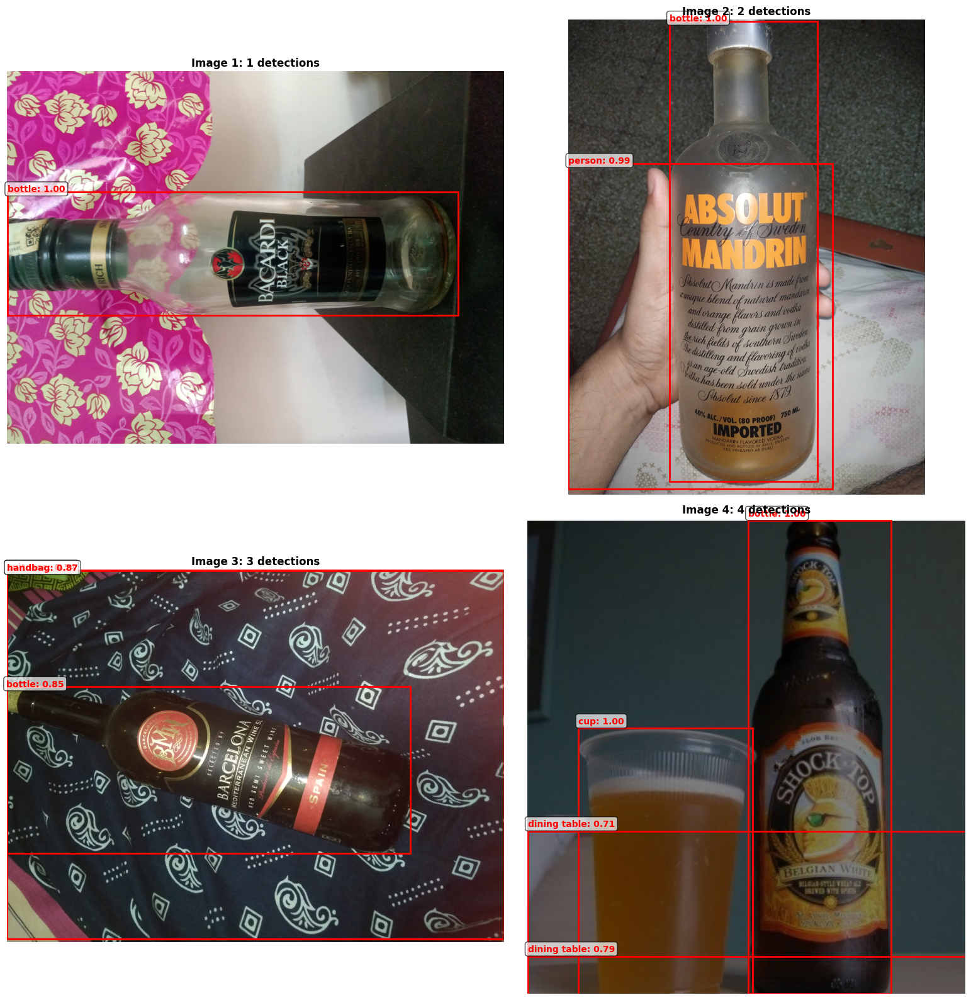


✓ Object detection test completed!


In [61]:
# Get test images from the dataset
dataset_path = Path("data_det/alcohol_bottles")
test_images_dir = dataset_path / "train" / "images"

if not test_images_dir.exists():
    test_images_dir = dataset_path / "val" / "images"

if test_images_dir.exists():
    # Get all image files
    image_files = list(test_images_dir.glob("*.jpg")) + list(test_images_dir.glob("*.png"))

    # Randomly sample 128 images
    random.seed(42)
    if len(image_files) > 128:
        image_files = random.sample(image_files, 128)
    else:
        image_files = image_files[:128]

    print(f"\nTesting on {len(image_files)} images...")

    # Process images and detect objects
    results = []
    for i, img_path in enumerate(image_files):
        try:
            # Load and process image
            image = Image.open(img_path).convert("RGB")
            inputs = processor(images=image, return_tensors="pt")
            inputs = {k: v.to(device) for k, v in inputs.items()}

            # Run detection
            with torch.no_grad():
                outputs = model(**inputs)

            # Post-process results
            target_sizes = torch.tensor([image.size[::-1]]).to(device)
            results_batch = processor.post_process_object_detection(
                outputs,
                target_sizes=target_sizes,
                threshold=0.5
            )[0]

            # Store results
            detections = []
            for score, label, box in zip(results_batch["scores"], results_batch["labels"], results_batch["boxes"]):
                detections.append({
                    "score": score.item(),
                    "label": model.config.id2label[label.item()],
                    "box": box.cpu().tolist()
                })

            results.append({
                "image_path": str(img_path),
                "image": image,
                "detections": detections
            })

            if (i + 1) % 20 == 0:
                print(f"  Processed {i + 1}/{len(image_files)} images...")

        except Exception as e:
            print(f"  ⚠ Error processing {img_path.name}: {e}")
            continue

    print(f"\n✓ Detection completed on {len(results)} images")

    # Display summary statistics
    total_detections = sum(len(r["detections"]) for r in results)
    images_with_detections = sum(1 for r in results if len(r["detections"]) > 0)

    print(f"\nDetection Summary:")
    print(f"  Total images processed: {len(results)}")
    print(f"  Images with detections: {images_with_detections}")
    print(f"  Total objects detected: {total_detections}")
    print(f"  Average detections per image: {total_detections / len(results):.2f}")

    # Show a few example results
    print(f"\nShowing 4 example detections...")
    fig, axes = plt.subplots(2, 2, figsize=(16, 16))
    axes = axes.flatten()

    # Select 4 random images with detections
    images_with_dets = [r for r in results if len(r["detections"]) > 0]
    if len(images_with_dets) > 4:
        sample_results = random.sample(images_with_dets, 4)
    else:
        sample_results = images_with_dets[:4] + results[:4-len(images_with_dets)]

    for idx, result in enumerate(sample_results[:4]):
        ax = axes[idx]
        image = result["image"]
        detections = result["detections"]

        # Draw image
        ax.imshow(image)
        ax.axis('off')

        # Draw bounding boxes
        for det in detections:
            box = det["box"]
            label = det["label"]
            score = det["score"]

            # Convert box format [x_min, y_min, x_max, y_max] to rectangle
            x_min, y_min, x_max, y_max = box
            rect = plt.Rectangle(
                (x_min, y_min),
                x_max - x_min,
                y_max - y_min,
                fill=False,
                edgecolor='red',
                linewidth=2
            )
            ax.add_patch(rect)

            # Add label
            ax.text(
                x_min,
                y_min - 5,
                f"{label}: {score:.2f}",
                color='red',
                fontsize=10,
                weight='bold',
                bbox=dict(boxstyle='round,pad=0.3', facecolor='white', alpha=0.7)
            )

        ax.set_title(f"Image {idx+1}: {len(detections)} detections", fontsize=12, weight='bold')

    plt.tight_layout()
    plt.show()

    print("\n✓ Object detection test completed!")

else:
    print(f"\n⚠ Test images directory not found: {test_images_dir}")
    print("  Please run the dataset download and organization cells first.")


Evaluating fine-tuned YOLO model on validation images...
Processing 28 images...
  Processed 20/28 images...

Detection Summary:
  Total images processed: 28
  Images with detections: 28
  Total bottles detected: 32
  Average detections per image: 1.14

Showing 4 sample predictions...


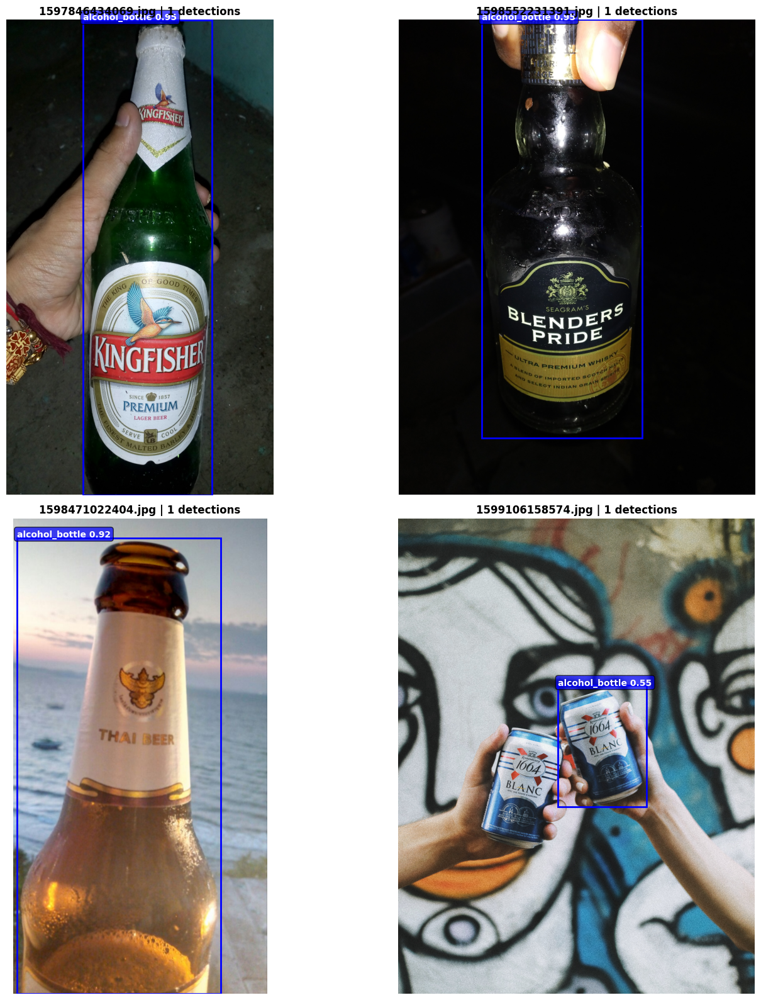


✓ YOLO evaluation complete!


In [ ]:
# ============================================================================
# Evaluate Fine-Tuned YOLO Model on Validation Images
# ============================================================================
# PURPOSE: Run inference with the custom-trained YOLO model on a batch of images,
#          summarize detections, and visualize example predictions.
# ============================================================================

from ultralytics import YOLO
from pathlib import Path
import random
import matplotlib.pyplot as plt
from PIL import Image

# Path to the trained YOLO model
trained_model_path = Path("models/yolo11_alcohol_bottles/weights/best.pt")

def format_box(xyxy):
    x1, y1, x2, y2 = xyxy
    return float(x1), float(y1), float(x2), float(y2)

if not trained_model_path.exists():
    print(f"⚠ Trained model not found at {trained_model_path}")
    print("   Please run the training cell first (Cell 24) to create best.pt")
else:
    print("="*80)
    print("Evaluating fine-tuned YOLO model on validation images...")
    print("="*80)

    yolo_eval_model = YOLO(str(trained_model_path))

    # Use validation images by default
    dataset_path = Path("data_det/alcohol_bottles")
    eval_images_dir = dataset_path / "val" / "images"
    if not eval_images_dir.exists():
        eval_images_dir = dataset_path / "train" / "images"

    if eval_images_dir.exists():
        image_files = list(eval_images_dir.glob("*.jpg")) + list(eval_images_dir.glob("*.png"))
        if not image_files:
            print("⚠ No images found to evaluate")
        else:
            random.seed(1337)
            if len(image_files) > 128:
                eval_images = random.sample(image_files, 128)
            else:
                eval_images = image_files

            print(f"Processing {len(eval_images)} images...")
            yolo_results = []
            for idx, img_path in enumerate(eval_images, 1):
                res = yolo_eval_model.predict(img_path, conf=0.35, verbose=False)
                boxes = []
                if res and res[0].boxes is not None:
                    names = res[0].names
                    for b in res[0].boxes:
                        cls_id = int(b.cls[0].item())
                        boxes.append({
                            "box": format_box(b.xyxy[0].cpu().numpy()),
                            "confidence": float(b.conf[0].item()),
                            "label": names.get(cls_id, f"class_{cls_id}")
                        })
                yolo_results.append({
                    "image_path": img_path,
                    "image": Image.open(img_path).convert("RGB"),
                    "detections": boxes
                })

                if idx % 20 == 0:
                    print(f"  Processed {idx}/{len(eval_images)} images...")

            detections_count = sum(len(r["detections"]) for r in yolo_results)
            images_with_dets = sum(1 for r in yolo_results if r["detections"])

            print("\nDetection Summary:")
            print(f"  Total images processed: {len(yolo_results)}")
            print(f"  Images with detections: {images_with_dets}")
            print(f"  Total bottles detected: {detections_count}")
            if yolo_results:
                avg_det = detections_count / len(yolo_results)
                print(f"  Average detections per image: {avg_det:.2f}")

            print("\nShowing 4 sample predictions...")
            sample = [r for r in yolo_results if r["detections"]]
            if len(sample) < 4:
                sample = yolo_results[:4]
            else:
                sample = random.sample(sample, 4)

            fig, axes = plt.subplots(2, 2, figsize=(16, 16))
            axes = axes.flatten()
            for ax, result in zip(axes, sample):
                ax.imshow(result["image"])
                ax.axis('off')
                ax.set_title(f"{result['image_path'].name} | {len(result['detections'])} detections",
                             fontsize=12, weight='bold')
                for det in result["detections"]:
                    x1, y1, x2, y2 = det["box"]
                    rect = plt.Rectangle((x1, y1), x2 - x1, y2 - y1,
                                         fill=False, edgecolor='blue', linewidth=2)
                    ax.add_patch(rect)
                    ax.text(x1, max(0, y1 - 5), f"{det['label']} {det['confidence']:.2f}",
                            color='white', fontsize=10, weight='bold',
                            bbox=dict(boxstyle='round,pad=0.3', facecolor='blue', alpha=0.7))
            plt.tight_layout()
            plt.show()

            print("\n✓ YOLO evaluation complete!")
    else:
        print(f"⚠ Could not find evaluation images in {eval_images_dir}")


YOLO vs DETR - SIDE-BY-SIDE COMPARISON

1. Loading trained YOLO model...
   ✓ Loaded YOLO from models/yolo11_alcohol_bottles/weights/best.pt

2. Selecting test images...
   ✓ Selected 6 images for comparison

3. Running inference on both models...
   Processing image 1/6: 1598589855804.jpg
   Processing image 2/6: 1598323109065.jpg
   Processing image 3/6: 1597234340599.jpg
   Processing image 4/6: 1597846426085.jpg
   Processing image 5/6: 1599106931530.jpg
   Processing image 6/6: 1599106958590.jpg

✓ Inference completed on 6 images

4. Creating comparison visualization...
   ✓ Saved comparison to models/yolo_vs_detr_comparison.png


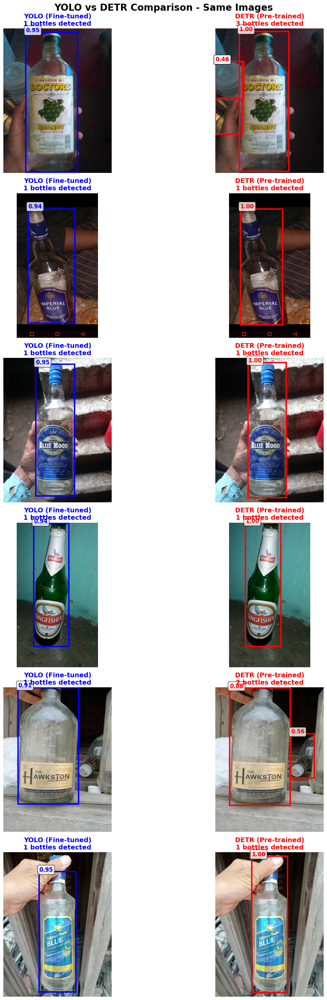


COMPARISON STATISTICS

Detections per model:
  YOLO (fine-tuned):  6 bottles detected
  DETR (pre-trained): 9 bottles detected

Average confidence:
  YOLO: 0.941
  DETR: 0.807

Per-image breakdown:
Image                YOLO Detections      DETR Detections     
------------------------------------------------------------
1598589855804.jpg    1                    3                   
1598323109065.jpg    1                    1                   
1597234340599.jpg    1                    1                   
1597846426085.jpg    1                    1                   
1599106931530.jpg    1                    2                   
1599106958590.jpg    1                    1                   

KEY INSIGHTS
⚠ DETR detected 3 MORE objects than YOLO
  → DETR might be detecting false positives (non-bottle objects)

✓ YOLO has HIGHER average confidence (0.941 vs 0.807)
  → YOLO is more certain about its predictions

✓ Comparison complete! Check 'models/yolo_vs_detr_comparison.png'


In [64]:
# ============================================================================
# YOLO vs DETR - SIDE-BY-SIDE COMPARISON
# ============================================================================
# PURPOSE: Compare fine-tuned YOLO with pre-trained DETR on same images
#
# COMPARISON METRICS:
# - Detection count (how many bottles found)
# - Confidence scores
# - Visual accuracy
# ============================================================================

import matplotlib.pyplot as plt
import matplotlib.patches as patches
from pathlib import Path
import random
import numpy as np
from PIL import Image
import torch
import cv2

print("="*80)
print("YOLO vs DETR - SIDE-BY-SIDE COMPARISON")
print("="*80)

# Load trained YOLO model
print("\n1. Loading trained YOLO model...")
yolo_model_path = Path("models/yolo11_alcohol_bottles/weights/best.pt")
if yolo_model_path.exists():
    yolo_model = YOLO(str(yolo_model_path))
    print(f"   ✓ Loaded YOLO from {yolo_model_path}")
else:
    print(f"   ⚠ YOLO model not found at {yolo_model_path}")
    print(f"   ⚠ Please train YOLO first (Cell 24)")
    yolo_model = None

# Get test images
print("\n2. Selecting test images...")
test_images_dir = Path("data_det/alcohol_bottles/val/images")
if not test_images_dir.exists():
    test_images_dir = Path("data_det/alcohol_bottles/train/images")

if test_images_dir.exists():
    image_files = list(test_images_dir.glob("*.jpg")) + list(test_images_dir.glob("*.png"))
    
    # Select 6 random images for comparison
    random.seed(42)
    comparison_images = random.sample(image_files, min(6, len(image_files)))
    print(f"   ✓ Selected {len(comparison_images)} images for comparison")
    
    # Store results
    comparison_results = []
    
    print("\n3. Running inference on both models...")
    for idx, img_path in enumerate(comparison_images, 1):
        print(f"   Processing image {idx}/{len(comparison_images)}: {img_path.name}")
        
        # Load image using OpenCV to match YOLO's orientation handling
        img_cv = cv2.imread(str(img_path))
        if img_cv is None:
            print(f"  ⚠ Could not read {img_path.name}, skipping...")
            continue
        img_rgb = cv2.cvtColor(img_cv, cv2.COLOR_BGR2RGB)
        image = Image.fromarray(img_rgb)
        img_height, img_width = img_cv.shape[:2]
        
        result_dict = {
            'image': image,
            'image_name': img_path.name,
            'yolo_detections': [],
            'detr_detections': []
        }
        
        # === YOLO Inference ===
        if yolo_model is not None:
            yolo_results = yolo_model.predict(img_path, conf=0.3, verbose=False)
            if len(yolo_results) > 0 and yolo_results[0].boxes is not None:
                boxes = yolo_results[0].boxes
                for box in boxes:
                    # Get box coordinates (xyxy format)
                    x1, y1, x2, y2 = box.xyxy[0].cpu().numpy()
                    conf = float(box.conf[0])
                    cls = int(box.cls[0])
                    
                    result_dict['yolo_detections'].append({
                        'bbox': [x1, y1, x2, y2],
                        'confidence': conf,
                        'class': 'alcohol_bottle'
                    })
        
        # === DETR Inference ===
        inputs = processor(images=image, return_tensors="pt")
        inputs = {k: v.to(device) for k, v in inputs.items()}
        
        with torch.no_grad():
            outputs = model(**inputs)
        
        target_sizes = torch.tensor([image.size[::-1]]).to(device)
        detr_results = processor.post_process_object_detection(
            outputs, target_sizes=target_sizes, threshold=0.3
        )[0]
        
        # Filter for bottles only
        for score, label, box in zip(detr_results["scores"], detr_results["labels"], detr_results["boxes"]):
            label_name = model.config.id2label[label.item()]
            # COCO "bottle" class or related
            if 'bottle' in label_name.lower():
                result_dict['detr_detections'].append({
                    'bbox': box.cpu().tolist(),
                    'confidence': score.item(),
                    'class': label_name
                })
        
        comparison_results.append(result_dict)
    
    print(f"\n✓ Inference completed on {len(comparison_results)} images\n")
    
    # === CREATE COMPARISON VISUALIZATION ===
    print("4. Creating comparison visualization...")
    
    fig, axes = plt.subplots(len(comparison_images), 2, figsize=(16, 5*len(comparison_images)))
    if len(comparison_images) == 1:
        axes = axes.reshape(1, -1)
    
    fig.suptitle('YOLO vs DETR Comparison - Same Images', 
                 fontsize=20, fontweight='bold', y=0.995)
    
    for idx, result in enumerate(comparison_results):
        # YOLO column (left)
        ax_yolo = axes[idx, 0]
        ax_yolo.imshow(result['image'])
        ax_yolo.axis('off')
        
        yolo_count = len(result['yolo_detections'])
        ax_yolo.set_title(f"YOLO (Fine-tuned)\n{yolo_count} bottles detected", 
                         fontsize=14, fontweight='bold', color='blue')
        
        # Draw YOLO bounding boxes
        for det in result['yolo_detections']:
            x1, y1, x2, y2 = det['bbox']
            width = x2 - x1
            height = y2 - y1
            rect = patches.Rectangle((x1, y1), width, height,
                                    linewidth=3, edgecolor='blue', 
                                    facecolor='none')
            ax_yolo.add_patch(rect)
            
            # Add confidence label
            ax_yolo.text(x1, y1-5, f"{det['confidence']:.2f}",
                        color='blue', fontsize=12, weight='bold',
                        bbox=dict(boxstyle='round,pad=0.3', 
                                facecolor='white', alpha=0.8))
        
        # DETR column (right)
        ax_detr = axes[idx, 1]
        ax_detr.imshow(result['image'])
        ax_detr.axis('off')
        
        detr_count = len(result['detr_detections'])
        ax_detr.set_title(f"DETR (Pre-trained)\n{detr_count} bottles detected", 
                         fontsize=14, fontweight='bold', color='red')
        
        # Draw DETR bounding boxes
        for det in result['detr_detections']:
            x1, y1, x2, y2 = det['bbox']
            width = x2 - x1
            height = y2 - y1
            rect = patches.Rectangle((x1, y1), width, height,
                                    linewidth=3, edgecolor='red', 
                                    facecolor='none')
            ax_detr.add_patch(rect)
            
            # Add confidence label
            ax_detr.text(x1, y1-5, f"{det['confidence']:.2f}",
                        color='red', fontsize=12, weight='bold',
                        bbox=dict(boxstyle='round,pad=0.3', 
                                facecolor='white', alpha=0.8))
        
        # Add image name as y-axis label
        axes[idx, 0].set_ylabel(f"Image {idx+1}\n{result['image_name']}", 
                               fontsize=12, rotation=0, ha='right', va='center')
    
    plt.tight_layout()
    plt.subplots_adjust(top=0.97)
    
    # Save comparison
    comparison_path = Path("models/yolo_vs_detr_comparison.png")
    plt.savefig(comparison_path, dpi=150, bbox_inches='tight')
    print(f"   ✓ Saved comparison to {comparison_path}")
    
    plt.show()
    
    # === PRINT STATISTICS ===
    print("\n" + "="*80)
    print("COMPARISON STATISTICS")
    print("="*80)
    
    total_yolo = sum(len(r['yolo_detections']) for r in comparison_results)
    total_detr = sum(len(r['detr_detections']) for r in comparison_results)
    
    avg_yolo_conf = np.mean([d['confidence'] for r in comparison_results 
                             for d in r['yolo_detections']]) if total_yolo > 0 else 0
    avg_detr_conf = np.mean([d['confidence'] for r in comparison_results 
                             for d in r['detr_detections']]) if total_detr > 0 else 0
    
    print(f"\nDetections per model:")
    print(f"  YOLO (fine-tuned):  {total_yolo} bottles detected")
    print(f"  DETR (pre-trained): {total_detr} bottles detected")
    
    print(f"\nAverage confidence:")
    print(f"  YOLO: {avg_yolo_conf:.3f}")
    print(f"  DETR: {avg_detr_conf:.3f}")
    
    print(f"\nPer-image breakdown:")
    print(f"{'Image':<20} {'YOLO Detections':<20} {'DETR Detections':<20}")
    print("-" * 60)
    for r in comparison_results:
        print(f"{r['image_name']:<20} {len(r['yolo_detections']):<20} {len(r['detr_detections']):<20}")
    
    # === KEY INSIGHTS ===
    print("\n" + "="*80)
    print("KEY INSIGHTS")
    print("="*80)
    
    if total_yolo > total_detr:
        diff = total_yolo - total_detr
        print(f"✓ YOLO detected {diff} MORE bottles than DETR")
        print(f"  → Fine-tuning on your specific dataset helps!")
    elif total_detr > total_yolo:
        diff = total_detr - total_yolo
        print(f"⚠ DETR detected {diff} MORE objects than YOLO")
        print(f"  → DETR might be detecting false positives (non-bottle objects)")
    else:
        print(f"⚠ Both models detected the same number of bottles")
    
    if avg_yolo_conf > avg_detr_conf:
        print(f"\n✓ YOLO has HIGHER average confidence ({avg_yolo_conf:.3f} vs {avg_detr_conf:.3f})")
        print(f"  → YOLO is more certain about its predictions")
    
    print("\n" + "="*80)
    print(f"✓ Comparison complete! Check 'models/yolo_vs_detr_comparison.png'")
    print("="*80)
    
else:
    print(f"\n⚠ Test images not found at {test_images_dir}")
    print("  Please run the dataset download cell first.")
